# Instalación de librerías y código 

In [7]:
!pip install ripser persim gudhi numpy matplotlib sympy scipy scikit-learn

In [8]:
# -- coding: utf-8 --
# ==============================================================================
# IMPORTACIÓN DE LIBRERÍAS
# ==============================================================================
import numpy as np # Librería para cálculo numérico y manejo de arrays.
import matplotlib.pyplot as plt # Librería para la generación de gráficos.
from sympy import primerange # Función para generar números primos en un rango.
from scipy.interpolate import interp1d # Función para realizar interpolaciones (lineal, cúbica).
from sklearn.preprocessing import StandardScaler # Utilidad para estandarizar datos (media 0, varianza 1).
from sklearn.neighbors import NearestNeighbors # Necesario para el cálculo de Falsos Vecinos Cercanos (FNN).
from sklearn.metrics import mutual_info_score # Necesario para el cálculo de Información Mutua Media (AMI).
from ripser import ripser # Función principal para calcular la homología persistente (diagramas).
from persim import plot_diagrams # Función para visualizar los diagramas de persistencia.
import gudhi as gd # Librería avanzada para análisis topológico, usada aquí para visualizar el complejo de Rips.
from mpl_toolkits.mplot3d import Axes3D # Módulo para crear gráficos en 3D.

# ==============================================================================
# PARTE 1: GENERACIÓN DE SECUENCIAS
# ==============================================================================

def generar_secuencia_filtrada(primo_base, longitud_deseada):
    """
    Genera una secuencia numérica basada en las distancias entre múltiplos de un
    número primo (`primo_base`).
    La lógica consiste en tomar los múltiplos de `primo_base` y eliminar aquellos
    que son divisibles por cualquier primo anterior a `primo_base`.
    Luego, se calculan las distancias entre los múltiplos consecutivos restantes.
    """
    # Validación de la entrada para asegurar que es un primo.
    if not isinstance(primo_base, int) or primo_base < 2:
        raise ValueError("El número base debe ser un entero primo >= 2.")

    # Obtiene la lista de primos que se usarán para el filtrado.
    primos_menores = list(primerange(2, primo_base))
    multiplos_filtrados = []
    multiplo_actual = primo_base
    # Se define un paso grande para buscar múltiplos en lotes, lo que es más eficiente.
    paso_busqueda = primo_base * 20

    # Bucle para generar múltiplos hasta alcanzar la longitud deseada.
    while len(multiplos_filtrados) < longitud_deseada:
        # Genera un lote de múltiplos del primo base.
        nuevos_multiplos = range(multiplo_actual, multiplo_actual + paso_busqueda, primo_base)
        # Filtra el lote: se queda solo con los múltiplos que no son divisibles por ningún primo menor.
        filtrado_lote = [m for m in nuevos_multiplos if all(m % q != 0 for q in primos_menores)]
        multiplos_filtrados.extend(filtrado_lote)
        multiplo_actual += paso_busqueda

    # Recorta la lista al tamaño exacto deseado.
    multiplos_filtrados = multiplos_filtrados[:longitud_deseada]
    # Calcula la distancia normalizada entre múltiplos consecutivos.
    # Esta es la secuencia final que se devuelve.
    secuencia_distancias = [(multiplos_filtrados[i] - multiplos_filtrados[i-1]) // primo_base - 1
                            for i in range(1, len(multiplos_filtrados))]

    print(f"\n➤ Analizando para el primo: {primo_base}")
    print(f"Secuencia de distancias generada (longitud {len(secuencia_distancias)}).")
    return secuencia_distancias

def generar_secuencia_diferencia_primos(n_primos):
    """Genera una secuencia a partir de la diferencia entre primos consecutivos."""
    # Se estima un rango superior para asegurar que se encuentren al menos n_primos.
    primos = list(primerange(0, n_primos * 15))[:n_primos]
    # np.diff(A) calcula la diferencia entre elementos adyacentes: [A[1]-A[0], A[2]-A[1], ...].
    secuencia = np.diff(primos)
    print(f"\n➤ Generando secuencia de diferencias entre los primeros {n_primos} primos.")
    return secuencia

def generar_secuencia_xor_primos_naturales(n_elementos):
    """
    Genera una secuencia aplicando la operación XOR (o exclusivo) elemento a
    elemento entre la secuencia de números naturales (0, 1, 2, ...) y la
    secuencia de números primos (2, 3, 5, ...).
    """
    naturales = np.arange(n_elementos)
    primos = np.array(list(primerange(0, n_elementos * 15))[:n_elementos])
    # np.bitwise_xor realiza la operación XOR a nivel de bits.
    secuencia = np.bitwise_xor(naturales, primos)
    print(f"\n➤ Generando secuencia XOR entre naturales y primos para {n_elementos} elementos.")
    return secuencia

# ==============================================================================
# PARTE 2: SELECCIÓN DE PARÁMETROS DE EMBEDDING (d, τ)
# ==============================================================================

def calcular_ami(serie, max_tau=100):
    """
    Calcula la Información Mutua Media (AMI) entre la serie y sus versiones retardadas.
    La AMI mide la dependencia no lineal entre dos variables. Un valor bajo indica
    que las variables son más independientes.
    """
    amis = []
    # El número de 'bins' (contenedores) para la discretización puede ajustarse.
    # La raíz cuadrada del número de puntos es una heurística común y robusta.
    n_bins = int(np.sqrt(len(serie)))
    if n_bins < 2: n_bins = 10 # Asegura un número mínimo de bins.

    for tau in range(1, max_tau + 1):
        # Prepara las dos series a comparar: la original y la retardada por 'tau'.
        x = serie[:-tau]
        y = serie[tau:]

        # Discretiza los datos en 'bins' para poder calcular la entropía conjunta.
        bins = np.linspace(min(serie.min(), y.min()), max(serie.max(), y.max()), n_bins + 1)
        x_binned = np.digitize(x, bins)
        y_binned = np.digitize(y, bins)

        # Calcula la información mutua para este retardo 'tau' y la almacena.
        amis.append(mutual_info_score(x_binned, y_binned))

    return np.array(amis)

def seleccionar_tau_optimo(serie, max_tau=100):
    """
    Selecciona el retardo temporal (τ) óptimo buscando el primer mínimo local
    en la curva de Información Mutua Media (AMI).
    Este mínimo representa el punto donde la serie y su versión retardada tienen
    la menor dependencia, proporcionando la máxima información nueva.
    """
    print("\n--- Calculando Retardo Temporal Óptimo (τ) ---")
    tau_range = np.arange(1, max_tau + 1)
    ami = calcular_ami(serie, max_tau=max_tau)

    tau_optimo = -1
    # Busca el primer punto que sea menor que sus dos vecinos (un valle).
    for i in range(1, len(ami) - 1):
        if ami[i] < ami[i-1] and ami[i] < ami[i+1]:
            tau_optimo = tau_range[i]
            break

    # Si no se encuentra un mínimo claro, se usa un valor por defecto.
    if tau_optimo == -1:
        print("Advertencia: No se encontró un mínimo local claro para AMI. Usando tau=2 como fallback.")
        tau_optimo = 2

    print(f"Retardo temporal óptimo (τ) encontrado: {tau_optimo}")

    # Visualiza la curva de AMI para inspección manual.
    plt.figure(figsize=(10, 5))
    plt.plot(tau_range, ami, marker='o', linestyle='-', label='AMI')
    plt.axvline(tau_optimo, color='r', linestyle='--', label=f'τ óptimo = {tau_optimo}')
    plt.title('Información Mutua Media (AMI) vs. Retardo Temporal (τ)')
    plt.xlabel('Retardo Temporal (τ)')
    plt.ylabel('Información Mutua Media')
    plt.legend()
    plt.grid(True)
    plt.show()

    return tau_optimo

def calcular_fnn(serie, tau, max_dim=15):
    """
    Calcula el porcentaje de Falsos Vecinos Cercanos (FNN) para diferentes
    dimensiones de embedding. Un "falso vecino" es un punto que parece cercano
    en una dimensión 'd' pero se aleja significativamente al pasar a la dimensión 'd+1'.
    Esto indica que la dimensión 'd' era insuficiente para desplegar la topología del atractor.
    """
    # Umbrales estándar para la detección de FNN.
    R_tol = 15.0  # Umbral de expansión de distancia relativa.
    A_tol = 2.0   # Umbral de distancia absoluta (relacionado con el tamaño del atractor).
    sigma_x = np.std(serie)

    fnn_percentages = []
    for dim in range(1, max_dim + 1):
        # Construye el embedding para la dimensión actual 'dim'.
        # El número de puntos disminuye a medida que aumenta la dimensión.
        m = len(serie) - (dim) * tau
        if m <= 0:
            break # No hay suficientes puntos para continuar.

        # Crea el embedding de dimensión 'dim' usando la técnica de indexación de NumPy.
        indices = np.arange(m)[:, None] + np.arange(dim)[None, :] * tau
        embedding_d = serie[indices]

        # Encuentra el vecino más cercano para cada punto en la dimensión 'dim'.
        nn = NearestNeighbors(n_neighbors=2, algorithm='auto').fit(embedding_d)
        distances, indices_vecinos = nn.kneighbors(embedding_d)

        # El índice del vecino más cercano para cada punto i es indices_vecinos[i, 1].
        # (El índice 0 es el propio punto).
        indices_vecino_cercano = indices_vecinos[:, 1]

        num_falsos_vecinos = 0
        # Itera sobre cada punto para ver si su vecino es "falso".
        for i in range(m):
            # Distancia al vecino en dimensión 'd' (al cuadrado).
            dist_d_sq = distances[i, 1]**2

            # Calcula la diferencia en la coordenada 'd+1' que se añadiría.
            diff_d_plus_1 = (serie[i + dim * tau] - serie[indices_vecino_cercano[i] + dim * tau])**2
            
            # Nueva distancia en dimensión 'd+1' (al cuadrado).
            dist_d_plus_1_sq = dist_d_sq + diff_d_plus_1

            # Criterio 1: La distancia relativa aumenta drásticamente.
            if dist_d_sq > 1e-10 and np.sqrt(dist_d_plus_1_sq / dist_d_sq) > R_tol:
                num_falsos_vecinos += 1
            # Criterio 2: La nueva distancia supera el tamaño del atractor.
            elif np.sqrt(dist_d_plus_1_sq) > A_tol * sigma_x:
                num_falsos_vecinos += 1
        
        # Calcula el porcentaje de falsos vecinos para esta dimensión.
        fnn_percentages.append(num_falsos_vecinos / m)

    return np.array(fnn_percentages)

def seleccionar_dim_optima(serie, tau, max_dim=15):
    """
    Selecciona la dimensión de embedding (d) óptima buscando la dimensión
    en la que el porcentaje de Falsos Vecinos Cercanos (FNN) cae por debajo
    de un umbral pequeño (típicamente 1%).
    """
    print("\n--- Calculando Dimensión de Embedding Óptima (d) ---")
    dim_range = np.arange(1, max_dim + 1)
    fnn_percentages = calcular_fnn(serie, tau=tau, max_dim=max_dim)

    dim_optima = -1
    # Busca la primera dimensión donde el porcentaje de FNN es suficientemente bajo.
    for i, percentage in enumerate(fnn_percentages):
        if percentage < 0.01: # Umbral del 1%
            dim_optima = dim_range[i]
            break

    # Si el porcentaje nunca baja del umbral, se usa un valor por defecto.
    if dim_optima == -1:
        print("Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.")
        dim_optima = 6

    print(f"Dimensión de embedding óptima (d) encontrada: {dim_optima}")

    # Visualiza la curva de FNN para inspección.
    plt.figure(figsize=(10, 5))
    plt.plot(dim_range[:len(fnn_percentages)], fnn_percentages * 100, marker='o')
    plt.axvline(dim_optima, color='r', linestyle='--', label=f'd óptima = {dim_optima}')
    plt.title('Porcentaje de Falsos Vecinos Cercanos (FNN) vs. Dimensión (d)')
    plt.xlabel('Dimensión de Embedding (d)')
    plt.ylabel('Porcentaje de Falsos Vecinos Cercanos (%)')
    plt.legend()
    plt.grid(True)
    plt.show()

    return dim_optima

# ==============================================================================
# PARTE 3: VISUALIZACIÓN Y ANÁLISIS TDA
# ==============================================================================

def interpolacion_trigonometrica(x, y, num_componentes, num_puntos_interp=1000):
    """
    Realiza una interpolación trigonométrica usando la Transformada de Fourier.
    Reconstruye la señal utilizando solo las `num_componentes` frecuencias más
    dominantes, lo que actúa como un filtro de paso bajo.
    """
    N = len(x)
    # Normaliza el eje x al intervalo [0, 2*pi] requerido por la base de Fourier.
    t = np.linspace(0, 2 * np.pi, num_puntos_interp, endpoint=False)
    # Calcula la Transformada Rápida de Fourier (FFT) de la señal.
    y_fft = np.fft.fft(y)
    y_interp = np.zeros_like(t, dtype=float)
    
    # Obtiene las frecuencias correspondientes a los coeficientes de la FFT.
    freqs = np.fft.fftfreq(N)
    # Ordena los índices de las frecuencias de menor a mayor magnitud (más importantes).
    indices = np.argsort(np.abs(freqs))
    
    # Reconstruye la señal sumando las contribuciones de las `num_componentes` principales.
    for i in range(min(num_componentes, N)):
        k = indices[i] # Índice de la frecuencia actual.
        amplitud = np.abs(y_fft[k]) / N # Amplitud normalizada.
        fase = np.angle(y_fft[k]) # Fase.
        
        if k == 0: # Componente de frecuencia cero (valor medio de la señal).
            y_interp += amplitud
        else: # Suma la componente sinusoidal (coseno) correspondiente.
            # Se multiplica por 2 porque la energía se reparte en frecuencias positivas y negativas.
            y_interp += amplitud * np.cos(k * t + fase) * 2

    # Escala el eje x de la interpolación para que coincida con el rango original.
    x_interp = np.linspace(x[0], x[-1], num_puntos_interp)
    return x_interp, y_interp

def embedding_de_takens(secuencia, dimension, retardo):
    """
    Construye una nube de puntos en un espacio de `dimension` dimensiones a
    partir de una secuencia unidimensional. Este es el paso clave para
    reconstruir el atractor de un sistema dinámico a partir de una serie temporal.
    """
    # Calcula el número de puntos que tendrá la nube resultante.
    N = len(secuencia) - (dimension - 1) * retardo
    if N <= 0:
        raise ValueError("Secuencia demasiado corta para la dimensión y retardo dados.")
    # Crea los vectores de estado (puntos en el espacio de embedding).
    # Cada punto es [s(t), s(t+τ), s(t+2τ), ...].
    return np.array([secuencia[i : i + dimension * retardo : retardo] for i in range(N)])

def realizar_analisis_tda(secuencia, nombre_analisis, dim_emb, tau_emb, epsilon_vr, max_puntos_tda):
    """
    Ejecuta el pipeline completo de TDA para una secuencia:
    1. Embedding de Takens para crear una nube de puntos.
    2. Submuestreo opcional si la nube es muy grande (por eficiencia).
    3. Estandarización de la nube de puntos.
    4. Visualización del atractor, la nube de puntos y el complejo de Rips.
    5. Cálculo y visualización del diagrama de persistencia.
    """
    print(f"\n--- INICIANDO ANÁLISIS TDA PARA: {nombre_analisis} ---")
    
    # 1. Aplica el embedding de Takens a la secuencia.
    nube_puntos_original = embedding_de_takens(np.array(secuencia), dim_emb, tau_emb)

    # Visualiza el atractor reconstruido de forma segura, adaptándose a la dimensión.
    fig_atractor = plt.figure(figsize=(8, 7))
    dimension_real_atractor = nube_puntos_original.shape[1]

    if dimension_real_atractor >= 3:
        ax = fig_atractor.add_subplot(111, projection='3d')
        ax.plot(nube_puntos_original[:, 0], nube_puntos_original[:, 1], nube_puntos_original[:, 2], lw=0.5, c='blue')
        ax.set_xlabel('Coordenada 1')
        ax.set_ylabel('Coordenada 2')
        ax.set_zlabel('Coordenada 3')
    elif dimension_real_atractor == 2:
        ax = fig_atractor.add_subplot(111)
        ax.plot(nube_puntos_original[:, 0], nube_puntos_original[:, 1], lw=0.5, c='blue')
        ax.set_xlabel('Coordenada 1')
        ax.set_ylabel('Coordenada 2')
    else: # dimension_real == 1
        ax = fig_atractor.add_subplot(111)
        ax.plot(nube_puntos_original[:, 0], lw=0.5, c='blue')
        ax.set_xlabel('Coordenada 1')

    plt.title(f"Atractor de '{nombre_analisis}' (d={dim_emb}, τ={tau_emb})")
    plt.grid(True)
    plt.show()

    # 2. Submuestreo: Si la nube de puntos es demasiado grande, se elige una muestra aleatoria.
    if nube_puntos_original.shape[0] > max_puntos_tda:
        print(f"La nube de puntos ({nube_puntos_original.shape[0]}) excede el máximo ({max_puntos_tda}). Submuestreando...")
        indices = np.random.choice(nube_puntos_original.shape[0], max_puntos_tda, replace=False)
        nube_puntos = nube_puntos_original[indices, :]
    else:
        nube_puntos = nube_puntos_original
    
    # 3. Estandarización: Se escalan los datos para que tengan media 0 y desviación estándar 1.
    nube_puntos = StandardScaler().fit_transform(nube_puntos)
    print(f"Análisis de persistencia se realizará en {nube_puntos.shape[0]} puntos.")

    # --- INICIO DE LA CORRECCIÓN 2 ---
    # Configuración de la figura para mostrar el complejo y el diagrama de persistencia.
    fig = plt.figure(figsize=(16, 7))
    ax_pers = fig.add_subplot(1, 2, 2) # Subplot para el diagrama de persistencia.
    fig.suptitle(f"Análisis TDA para: {nombre_analisis}", fontsize=16)

    # 4. Visualización del Complejo de Vietoris-Rips (adaptable a la dimensión).
    dimension_real_rips = nube_puntos.shape[1]
    
    # Crea el subplot para el complejo de Rips según la dimensión.
    if dimension_real_rips >= 3:
        ax_rips = fig.add_subplot(1, 2, 1, projection='3d')
        ax_rips.scatter(nube_puntos[:, 0], nube_puntos[:, 1], nube_puntos[:, 2], s=15, c='b')
    elif dimension_real_rips == 2:
        ax_rips = fig.add_subplot(1, 2, 1)
        ax_rips.scatter(nube_puntos[:, 0], nube_puntos[:, 1], s=15, c='b')
    else: # dimension_real_rips == 1
        ax_rips = fig.add_subplot(1, 2, 1)
        # Para 1D, se crea un eje y artificial con ceros para poder visualizar los puntos.
        ax_rips.scatter(nube_puntos[:, 0], np.zeros_like(nube_puntos[:, 0]), s=15, c='b')

    try:
        rips_complex = gd.RipsComplex(points=nube_puntos, max_edge_length=epsilon_vr)
        simplex_tree = rips_complex.create_simplex_tree(max_dimension=2)
        
        # Dibuja las aristas del complejo.
        for simplex in simplex_tree.get_skeleton(1):
            if len(simplex[0]) == 2:
                i, j = simplex[0]
                pt1, pt2 = nube_puntos[i], nube_puntos[j]
                if dimension_real_rips >= 3:
                    ax_rips.plot([pt1[0], pt2[0]], [pt1[1], pt2[1]], [pt1[2], pt2[2]], c='gray', alpha=0.7, lw=1)
                elif dimension_real_rips == 2:
                    ax_rips.plot([pt1[0], pt2[0]], [pt1[1], pt2[1]], c='gray', alpha=0.7, lw=1)
                # En 1D no se dibujan las aristas para no sobrecargar el gráfico.

        ax_rips.set_title(f"Complejo de Vietoris-Rips (ε = {epsilon_vr:.2f})")
    except Exception as e:
        print(f"No se pudo dibujar el complejo de Rips: {e}")
        ax_rips.set_title("Nube de Puntos (Complejo no dibujado)")
    # --- FIN DE LA CORRECCIÓN 2 ---

    # 5. Cálculo y visualización del Diagrama de Persistencia.
    diagramas = ripser(nube_puntos, maxdim=2)['dgms']
    plot_diagrams(diagramas, show=False, ax=ax_pers)
    ax_pers.set_title("Diagrama de Persistencia")

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
    print(f"--- ANÁLISIS TDA FINALIZADO PARA: {nombre_analisis} ---")

# ==============================================================================
# PARTE 4: PIPELINE DE EJECUCIÓN UNIFICADO
# ==============================================================================

def ejecutar_analisis_completo(
    secuencia_discreta,
    nombre_secuencia,
    puntos_interpolacion,
    dim_emb,
    tau_emb,
    epsilon_vr,
    num_componentes_trig,
    max_puntos_tda,
    tipos_TDA=['discreta', 'spline1', 'spline3', 'trigonometrica'],
    semilla=None
):
    """
    Función principal que orquesta todo el análisis.
    Permite seleccionar qué tipo de tratamiento dar a la secuencia (discreta,
    interpolada) y luego ejecuta el análisis TDA en cada versión seleccionada.
    """
    # Fija una semilla para la aleatoriedad (ej. en el submuestreo) para que los
    # resultados sean reproducibles.
    if semilla is not None:
        print(f"🌱 Fijando semilla aleatoria de NumPy en: {semilla}")
        np.random.seed(semilla)

    # 1. PREPARACIÓN DE DATOS
    # Define los ejes 'x' para la secuencia discreta y para las interpolaciones continuas.
    x_discreto = np.arange(len(secuencia_discreta))
    x_continuo = np.linspace(x_discreto[0], x_discreto[-1], puntos_interpolacion)
    
    # Crea un diccionario para almacenar las diferentes versiones de la secuencia.
    mapa_secuencias = {
        'discreta': (secuencia_discreta, "Discreta"),
        'spline1': (interp1d(x_discreto, secuencia_discreta, kind='linear', fill_value="extrapolate")(x_continuo), "Spline Lineal"),
        'spline3': (interp1d(x_discreto, secuencia_discreta, kind='cubic', fill_value="extrapolate")(x_continuo), "Spline Cúbica")
    }
    
    # La interpolación trigonométrica es más costosa, se calcula solo si se solicita.
    if 'trigonometrica' in tipos_TDA:
        x_trig, y_trig = interpolacion_trigonometrica(x_discreto, secuencia_discreta, num_componentes_trig, puntos_interpolacion)
        mapa_secuencias['trigonometrica'] = (y_trig, "Trigonométrica")

    # 2. GENERACIÓN DE GRÁFICAS DE INTERPOLACIÓN
    print(f"\n📈 Generando gráficas para los tipos: {tipos_TDA}")
    
    # Diccionario para gestionar la información de ploteo de cada tipo de interpolación.
    mapa_ejes = {
        'spline1': (x_continuo, 'g-'), # Verde continuo
        'spline3': (x_continuo, 'b-'), # Azul continuo
    }
    if 'trigonometrica' in tipos_TDA:
        mapa_ejes['trigonometrica'] = (x_trig, 'purple') # Morado

    # Itera sobre los tipos de interpolación seleccionados y genera un gráfico para cada uno.
    for tipo, (eje_x, estilo) in mapa_ejes.items():
        if tipo in tipos_TDA:
            plt.figure(figsize=(14, 7))
            # Dibuja la secuencia original como puntos rojos.
            plt.scatter(x_discreto, secuencia_discreta, color='red', s=40, zorder=5, label='Secuencia Discreta Original')
            
            # Extrae la secuencia interpolada y su nombre del mapa.
            secuencia_interp, nombre_largo = mapa_secuencias[tipo]
            # Dibuja la curva de interpolación.
            plt.plot(eje_x, secuencia_interp, estilo, label=f'Interpolación {nombre_largo}')
            
            plt.title(f"Secuencia '{nombre_secuencia}' con Interpolación {nombre_largo}")
            plt.xlabel("Índice / Eje X")
            plt.ylabel("Valor")
            plt.legend()
            plt.grid(True, linestyle='--', alpha=0.6)
            plt.tight_layout()
            plt.show()

    # Caso especial: si solo se pide analizar la 'discreta', se grafica ella sola.
    tipos_interpolacion_seleccionados = [t for t in tipos_TDA if t in mapa_ejes]
    if 'discreta' in tipos_TDA and not tipos_interpolacion_seleccionados:
        plt.figure(figsize=(14, 7))
        plt.scatter(x_discreto, secuencia_discreta, color='red', s=40, label='Secuencia Discreta Original')
        plt.plot(x_discreto, secuencia_discreta) # Une los puntos para ver la trayectoria.
        plt.title(f"Secuencia Discreta '{nombre_secuencia}'")
        plt.xlabel("Índice")
        plt.ylabel("Valor")
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.tight_layout()
        plt.show()
        
    # 3. EJECUCIÓN DEL ANÁLISIS TDA SELECTIVO
    print(f"\n▶️ Iniciando análisis TDA para los tipos: {tipos_TDA}")
    # Itera sobre los tipos de análisis solicitados (discreta, spline1, etc.).
    for tipo in tipos_TDA:
        if tipo in mapa_secuencias:
            # Recupera la secuencia y su nombre.
            secuencia_a_analizar, nombre_corto = mapa_secuencias[tipo]
            nombre_completo = f"{nombre_secuencia} - {nombre_corto}"
            # Llama a la función de análisis TDA para esta secuencia específica.
            realizar_analisis_tda(secuencia_a_analizar, nombre_completo, dim_emb, tau_emb, epsilon_vr, max_puntos_tda)

    print(f"\n✅ Análisis para '{nombre_secuencia}' finalizado.")

# Ejemplo de Ejecución


➤ Analizando para el primo: 7
Secuencia de distancias generada (longitud 1499).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 2


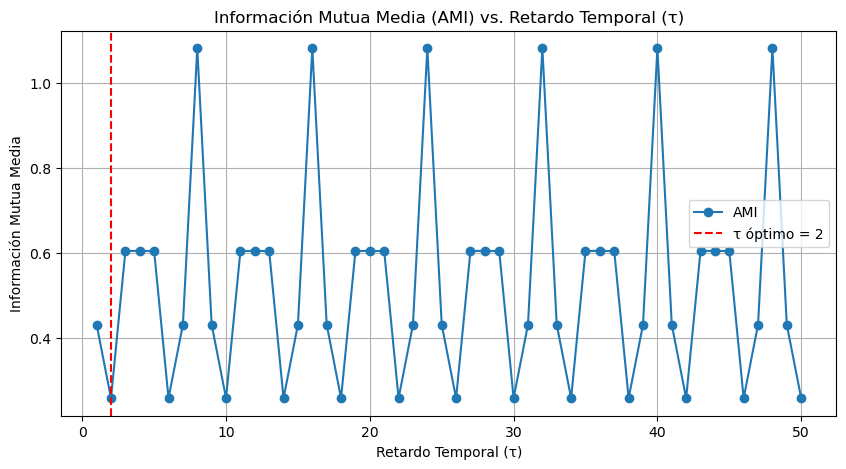


--- Calculando Dimensión de Embedding Óptima (d) ---
Dimensión de embedding óptima (d) encontrada: 2


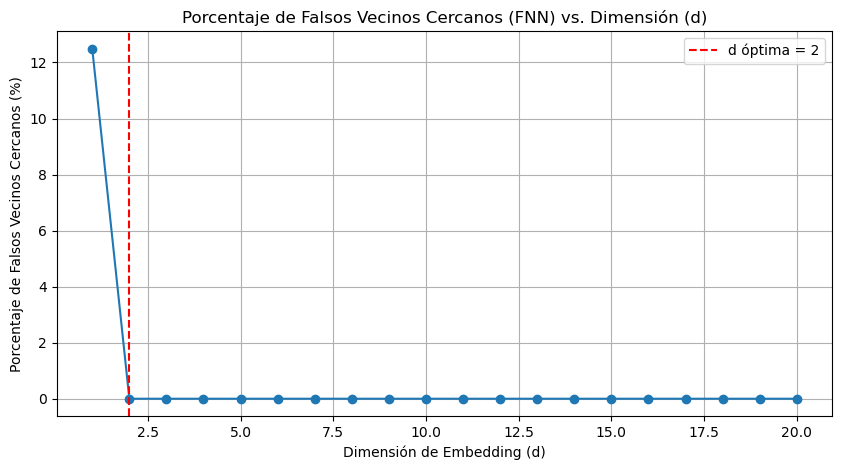


Parámetros de embedding detectados para 'Filtrada (Primo 7)': Dimensión (d) = 2, Retardo (τ) = 2
🌱 Fijando semilla aleatoria de NumPy en: 42

📈 Generando gráficas para los tipos: ['discreta', 'spline3']


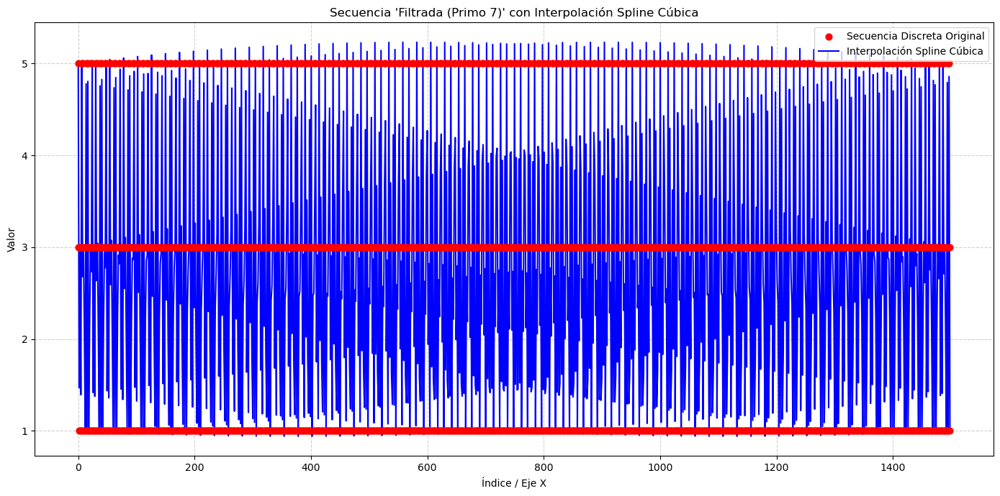


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 7) - Discreta ---


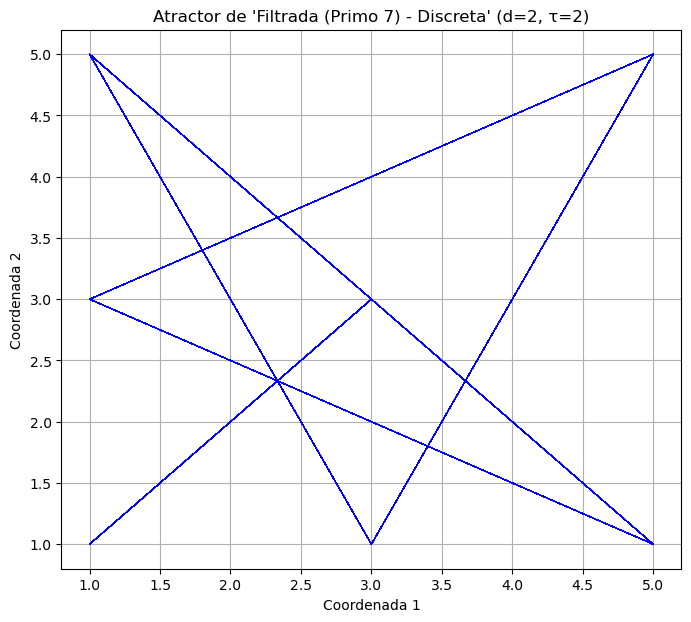

La nube de puntos (1497) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


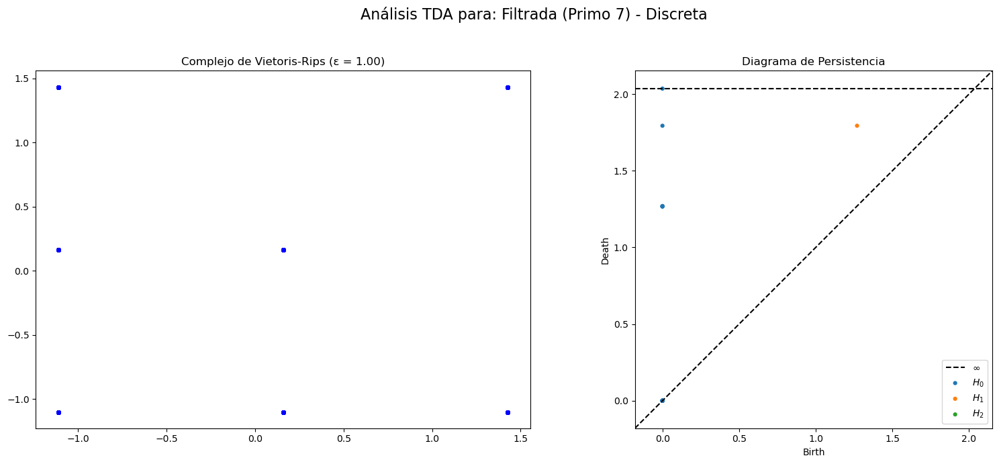

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 7) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 7) - Spline Cúbica ---


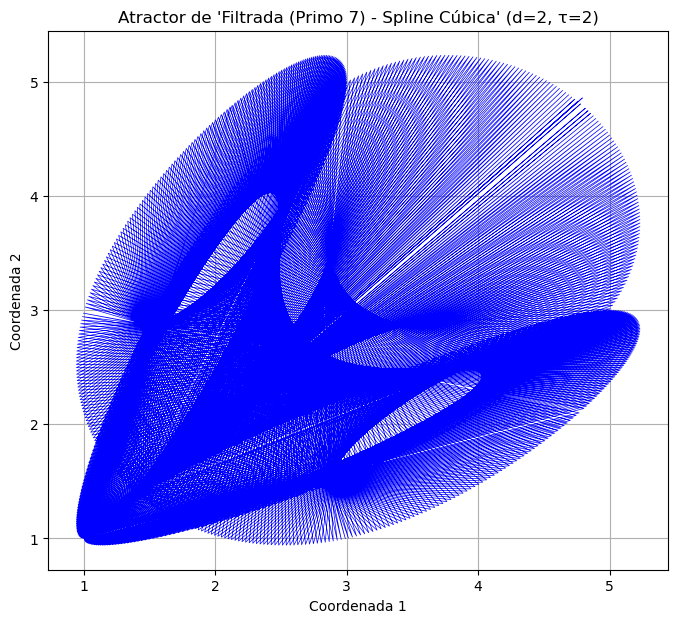

La nube de puntos (998) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


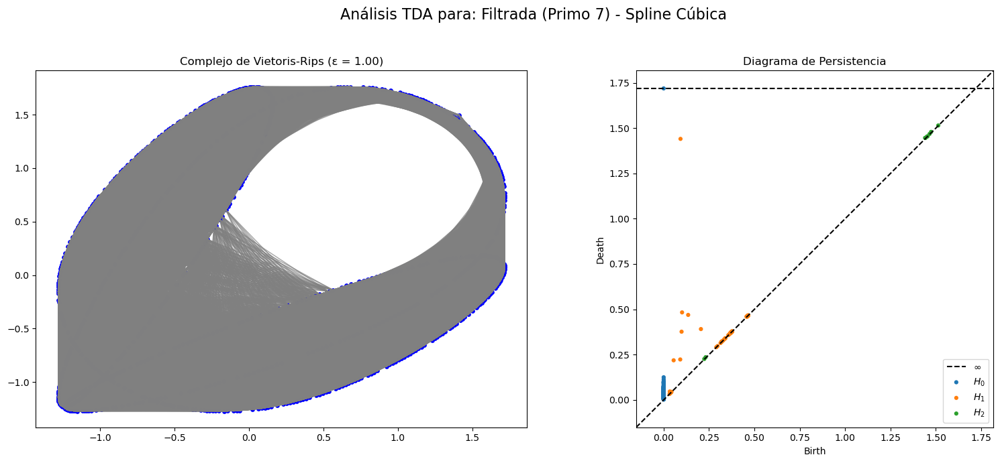

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 7) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 7)' finalizado.


In [9]:
# ==============================================================================
# BLOQUE DE EJECUCIÓN PRINCIPAL
# ==============================================================================
if __name__ == '__main__':
    # --- 1. Parámetros de Configuración ---
    # Parámetros para el análisis TDA y la visualización.
    PARAMETROS_TDA = {
        "puntos_interpolacion": 1000,
        "epsilon_vr": 1.0,
        "num_componentes_trig": 50,
        "max_puntos_tda": 750,
        "semilla": 42
    }
    # Parámetros para la detección automática de d y τ.
    PARAMETROS_AUTO_EMBEDDING = {
        "max_tau_ami": 50,
        "max_dim_fnn": 20
    }

    # --- 2. Elige la Secuencia a Analizar ---
    # Descomenta la línea de la secuencia que quieras usar:
    secuencia_a_analizar = generar_secuencia_filtrada(primo_base=7, longitud_deseada=1500)
    nombre = "Filtrada (Primo 7)"

    # secuencia_a_analizar = generar_secuencia_diferencia_primos(n_primos=1500)
    # nombre = "Diferencia de Primos"

    # secuencia_a_analizar = generar_secuencia_xor_primos_naturales(n_elementos=1500)
    # nombre = "XOR Primos y Naturales"

    # --- 3. Detección Automática de Parámetros de Embedding ---
    # Se convierte la secuencia a un array de NumPy por si acaso es una lista.
    secuencia_np = np.array(secuencia_a_analizar)
    
    # Se llama a las funciones de selección para obtener los parámetros óptimos.
    tau_optimo = seleccionar_tau_optimo(secuencia_np, max_tau=PARAMETROS_AUTO_EMBEDDING["max_tau_ami"])
    dim_optima = seleccionar_dim_optima(secuencia_np, tau=tau_optimo, max_dim=PARAMETROS_AUTO_EMBEDDING["max_dim_fnn"])

    print(f"\nParámetros de embedding detectados para '{nombre}': Dimensión (d) = {dim_optima}, Retardo (τ) = {tau_optimo}")

    # --- 4. Elige qué Análisis Realizar con los parámetros detectados ---
    ejecutar_analisis_completo(
        secuencia_discreta=secuencia_a_analizar,
        nombre_secuencia=nombre,
        dim_emb=dim_optima, 
        tau_emb=tau_optimo,
        # Aquí eliges qué versiones de la secuencia analizar:
        # Opciones: 'discreta', 'spline1', 'spline3', 'trigonometrica'
        tipos_TDA=['discreta', 'spline3'], # <--- ¡MODIFICA ESTA LISTA!
        **PARAMETROS_TDA
    )

# Experimentos

## Secuencia $s_n = n⊕p_n$


➤ Generando secuencia XOR entre naturales y primos para 1500 elementos.

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 17


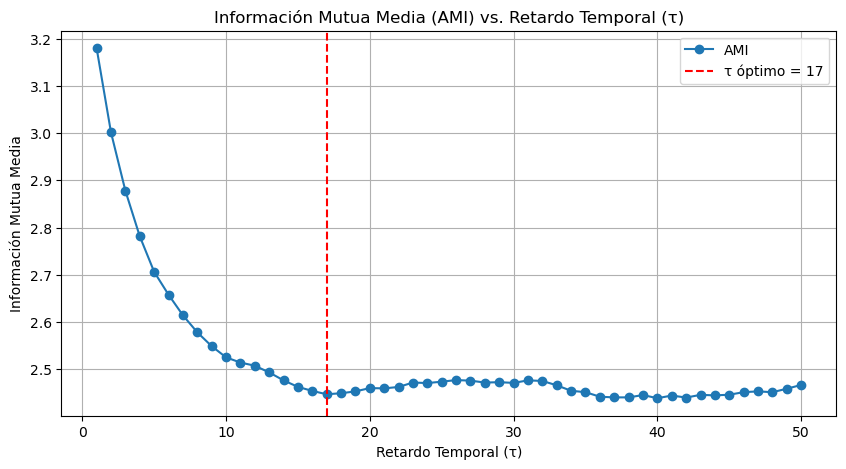


--- Calculando Dimensión de Embedding Óptima (d) ---
Dimensión de embedding óptima (d) encontrada: 8


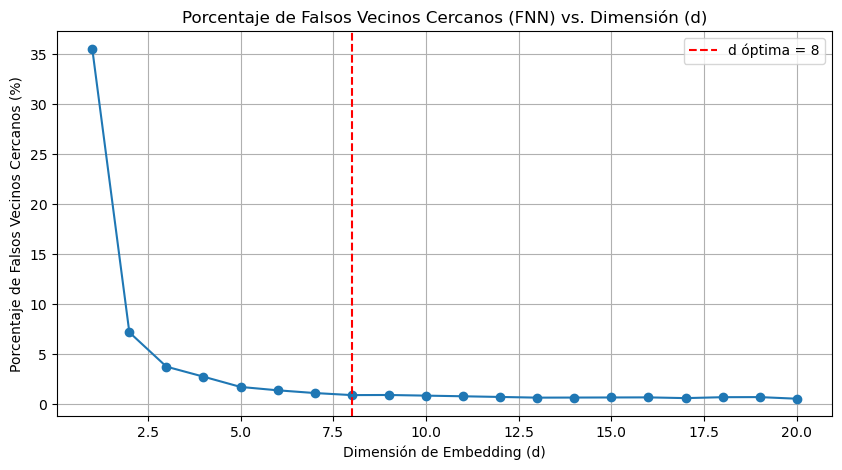


Parámetros de embedding detectados para 'XOR Primos y Naturales': Dimensión (d) = 8, Retardo (τ) = 17
🌱 Fijando semilla aleatoria de NumPy en: 42

📈 Generando gráficas para los tipos: ['discreta', 'spline3']


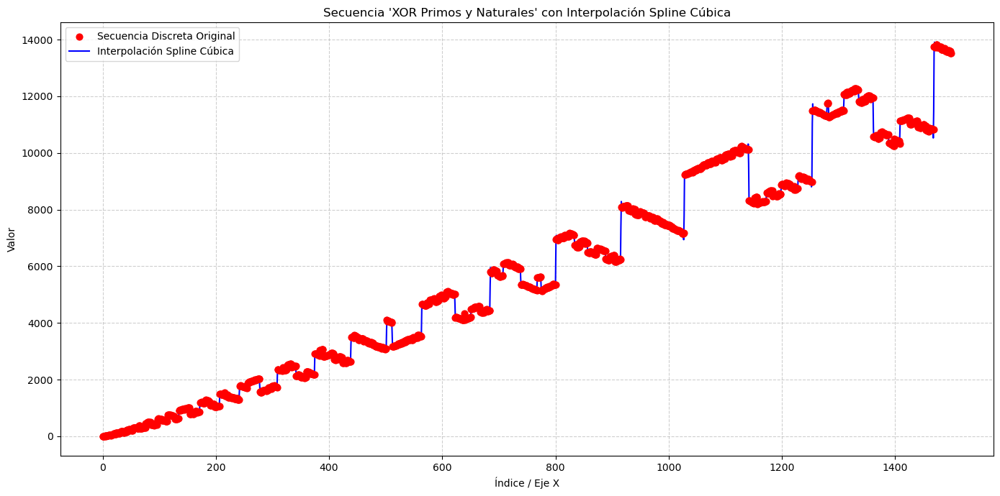


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: XOR Primos y Naturales - Discreta ---


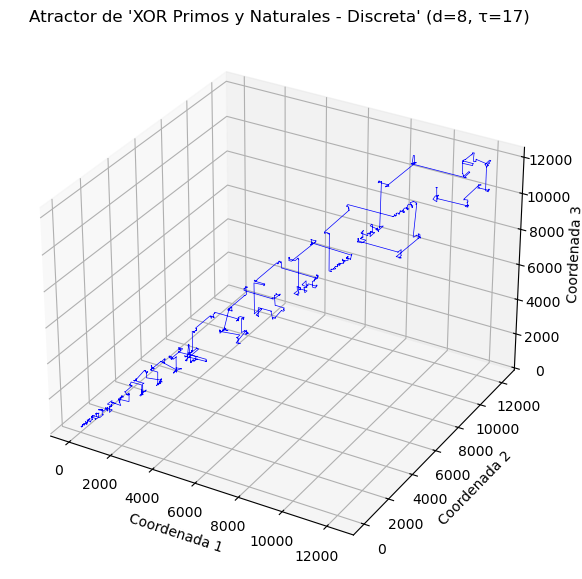

La nube de puntos (1381) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


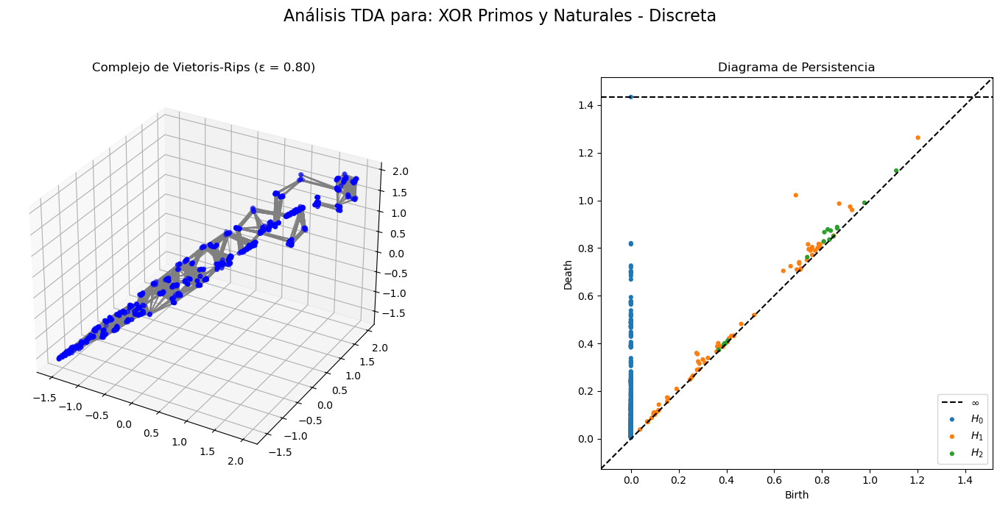

--- ANÁLISIS TDA FINALIZADO PARA: XOR Primos y Naturales - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: XOR Primos y Naturales - Spline Cúbica ---


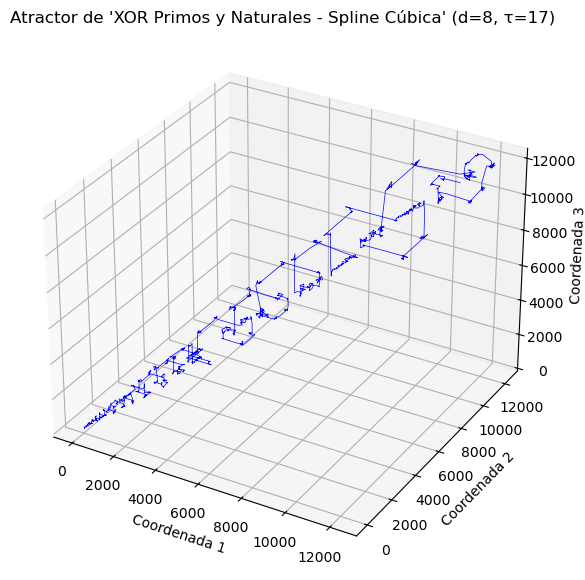

La nube de puntos (1881) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


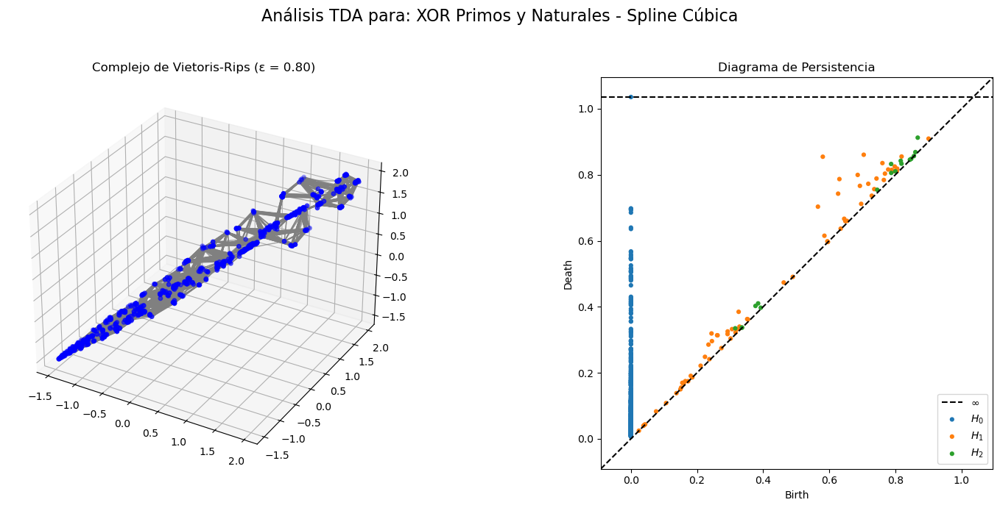

--- ANÁLISIS TDA FINALIZADO PARA: XOR Primos y Naturales - Spline Cúbica ---

✅ Análisis para 'XOR Primos y Naturales' finalizado.


In [28]:
# ==============================================================================
# BLOQUE DE EJECUCIÓN PRINCIPAL
# ==============================================================================
if __name__ == '__main__':
    # --- 1. Parámetros de Configuración ---
    # Parámetros para el análisis TDA y la visualización.
    PARAMETROS_TDA = {
        "puntos_interpolacion": 2000,
        "epsilon_vr": 0.8,
        "num_componentes_trig": 50,
        "max_puntos_tda": 750,
        "semilla": 42
    }
    # Parámetros para la detección automática de d y τ.
    PARAMETROS_AUTO_EMBEDDING = {
        "max_tau_ami": 50,
        "max_dim_fnn": 20
    }

    secuencia_a_analizar = generar_secuencia_xor_primos_naturales(n_elementos=1500)
    nombre = "XOR Primos y Naturales"

    # --- 3. Detección Automática de Parámetros de Embedding ---
    secuencia_np = np.array(secuencia_a_analizar)
    
    # Se llama a las funciones de selección para obtener los parámetros óptimos.
    tau_optimo = seleccionar_tau_optimo(secuencia_np, max_tau=PARAMETROS_AUTO_EMBEDDING["max_tau_ami"])
    dim_optima = seleccionar_dim_optima(secuencia_np, tau=tau_optimo, max_dim=PARAMETROS_AUTO_EMBEDDING["max_dim_fnn"])

    print(f"\nParámetros de embedding detectados para '{nombre}': Dimensión (d) = {dim_optima}, Retardo (τ) = {tau_optimo}")

    # --- 4. Elige qué Análisis Realizar con los parámetros detectados ---
    ejecutar_analisis_completo(
        secuencia_discreta=secuencia_a_analizar,
        nombre_secuencia=nombre,
        dim_emb=dim_optima, 
        tau_emb=tau_optimo,
        tipos_TDA=['discreta', 'spline3'], 
        **PARAMETROS_TDA
    )

## Secuencia derivada de múltiplos primos (análisis colectivo)

### Análisis 1 (Incluido en el informe)


➤ Analizando para el primo: 7
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 2


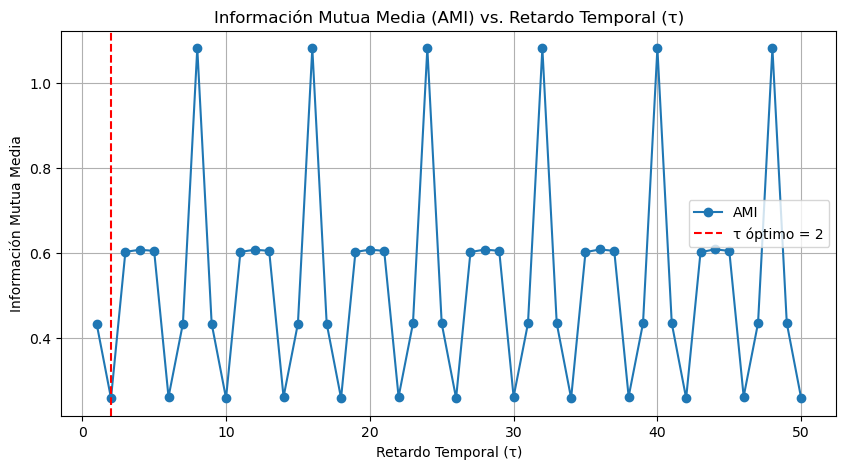


--- Calculando Dimensión de Embedding Óptima (d) ---
Dimensión de embedding óptima (d) encontrada: 2


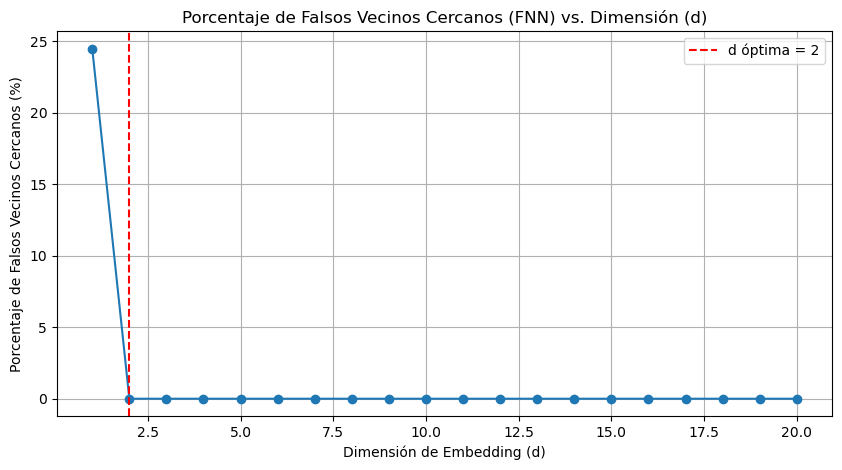


Parámetros de embedding detectados para 'Filtrada (Primo 7)': Dimensión (d) = 2, Retardo (τ) = 2
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


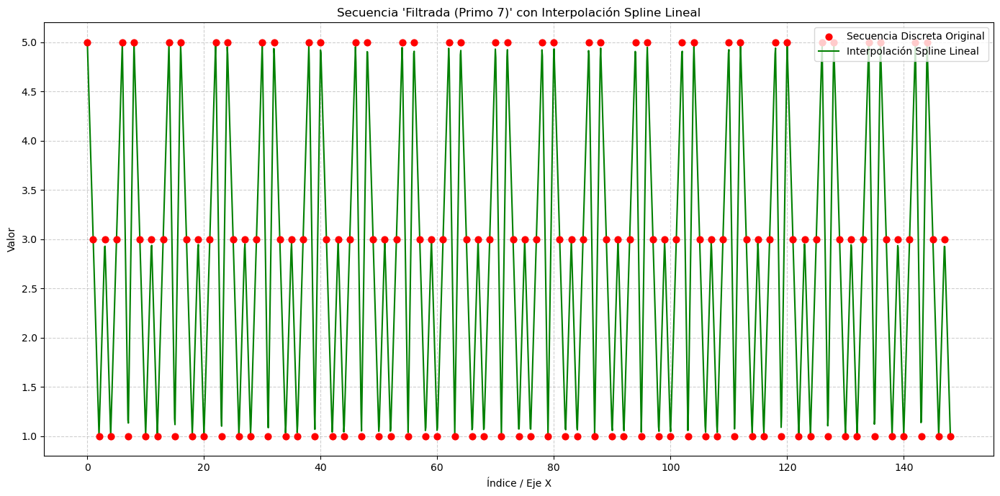

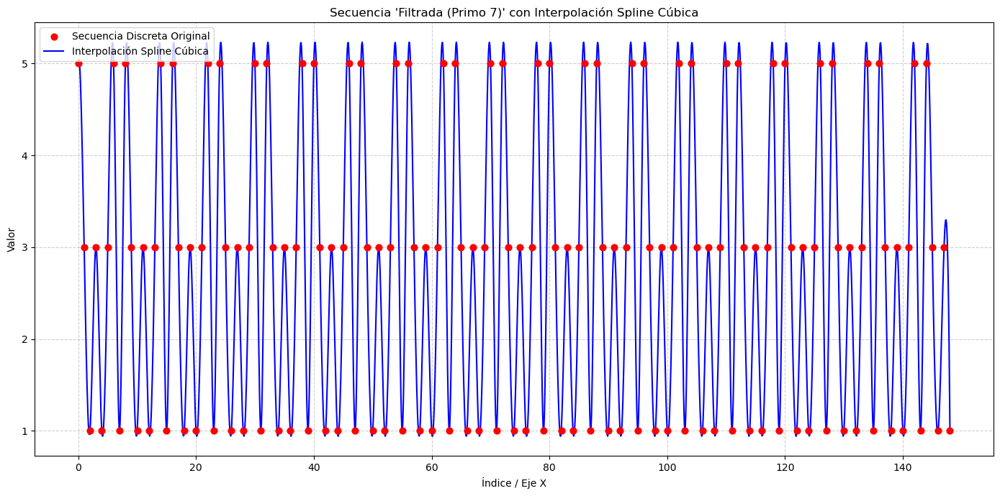


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 7) - Discreta ---


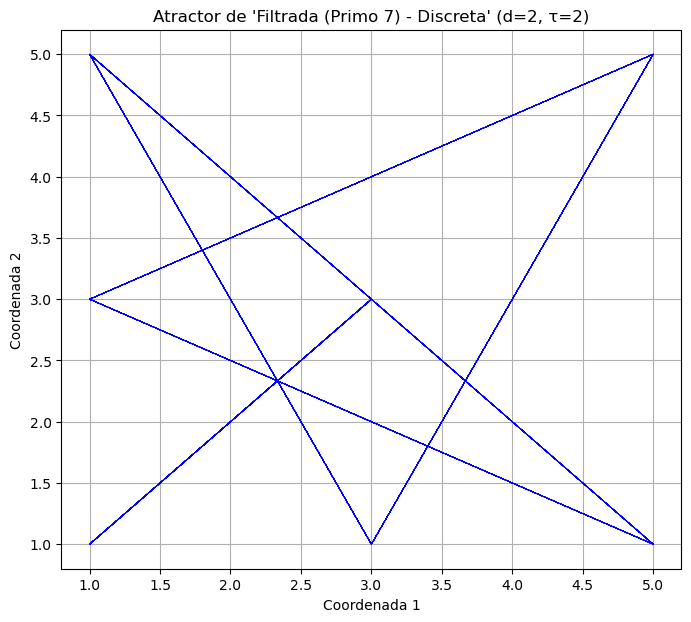

Análisis de persistencia se realizará en 147 puntos.


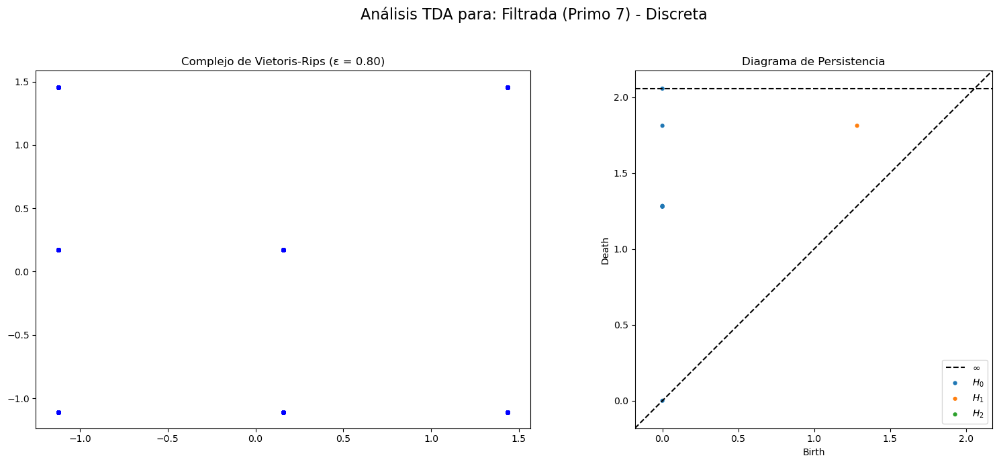

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 7) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 7) - Spline Lineal ---


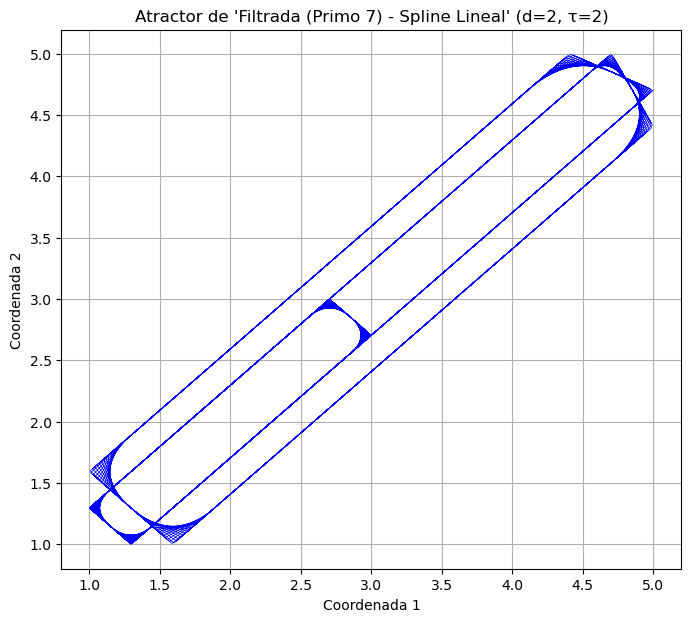

La nube de puntos (1998) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


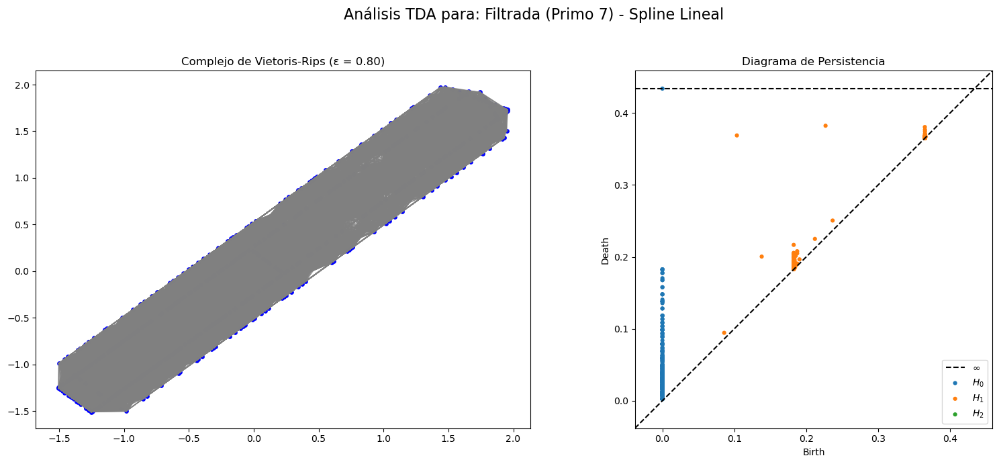

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 7) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 7) - Spline Cúbica ---


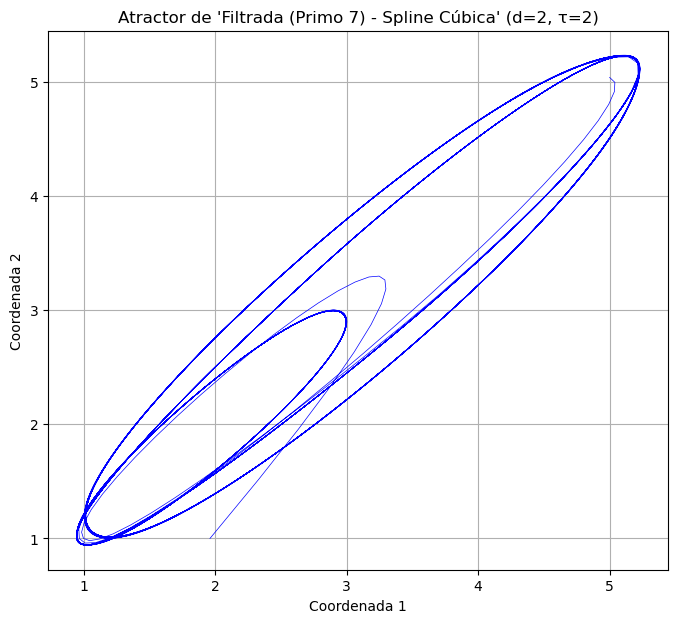

La nube de puntos (1998) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


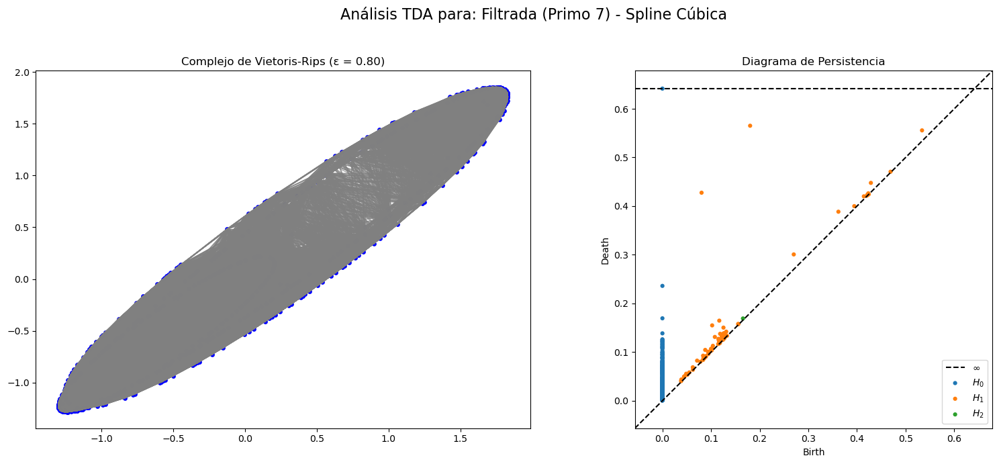

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 7) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 7)' finalizado.

➤ Analizando para el primo: 11
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 2


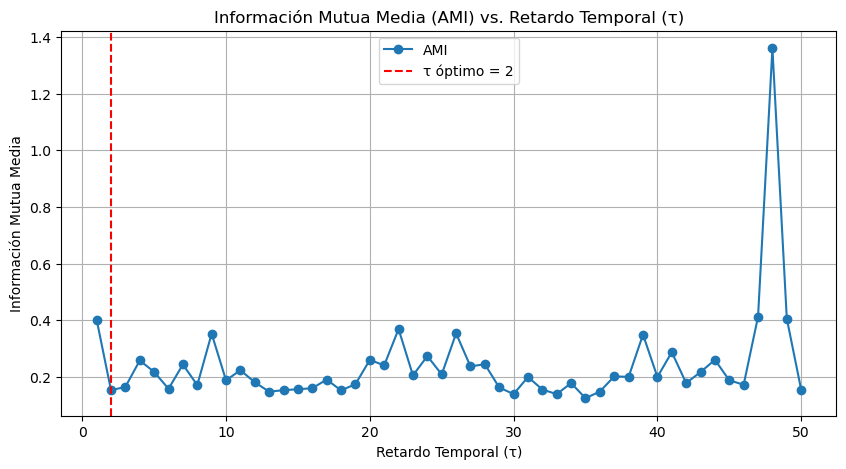


--- Calculando Dimensión de Embedding Óptima (d) ---
Dimensión de embedding óptima (d) encontrada: 3


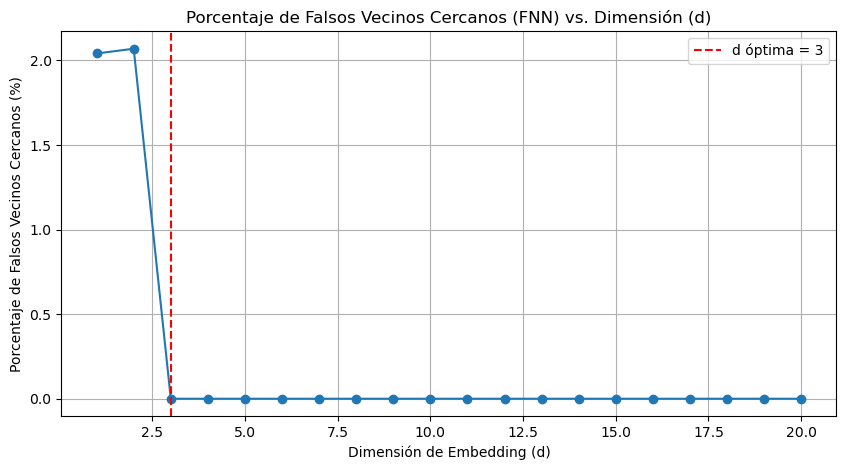


Parámetros de embedding detectados para 'Filtrada (Primo 11)': Dimensión (d) = 3, Retardo (τ) = 2
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


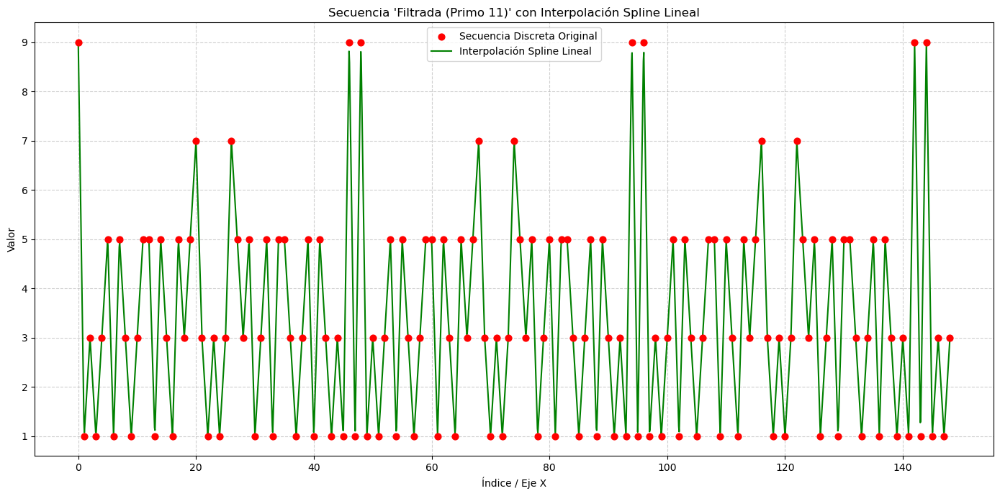

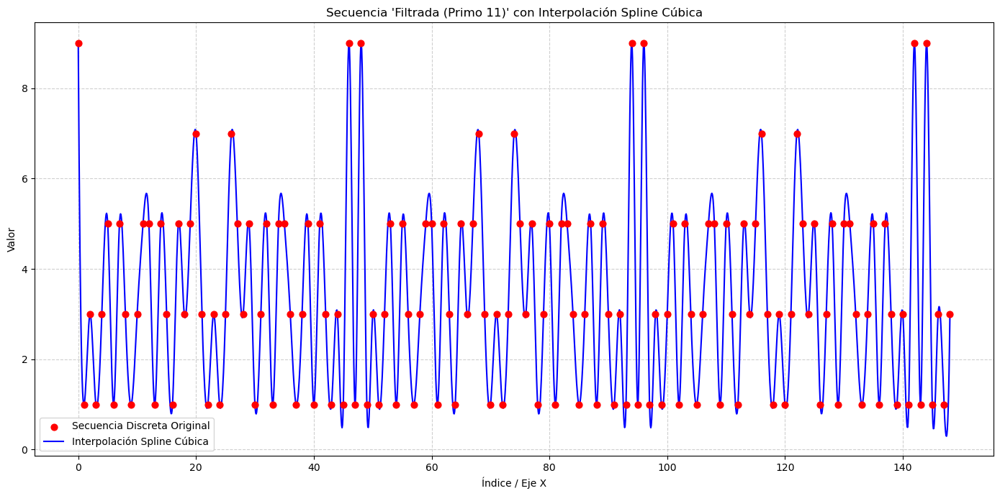


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 11) - Discreta ---


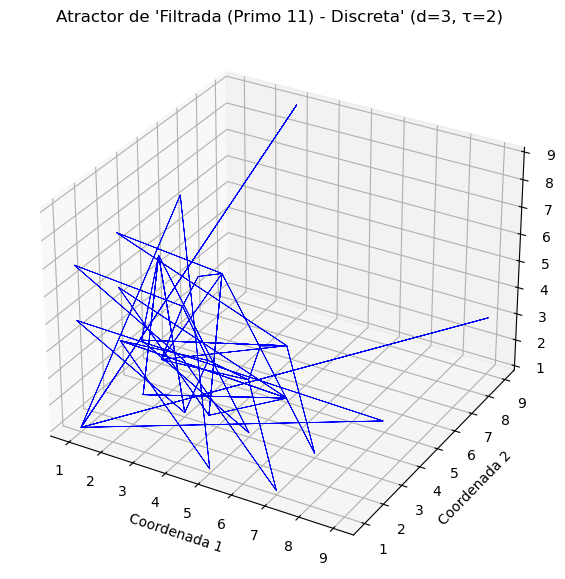

Análisis de persistencia se realizará en 145 puntos.


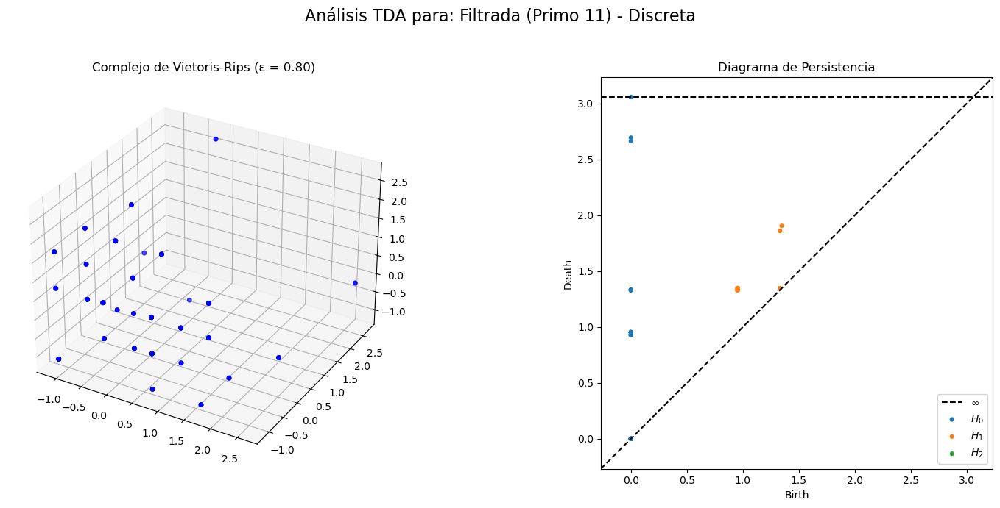

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 11) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 11) - Spline Lineal ---


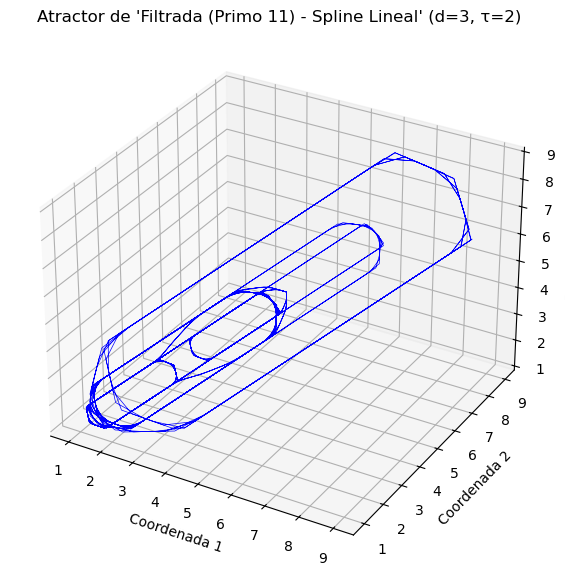

La nube de puntos (1996) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


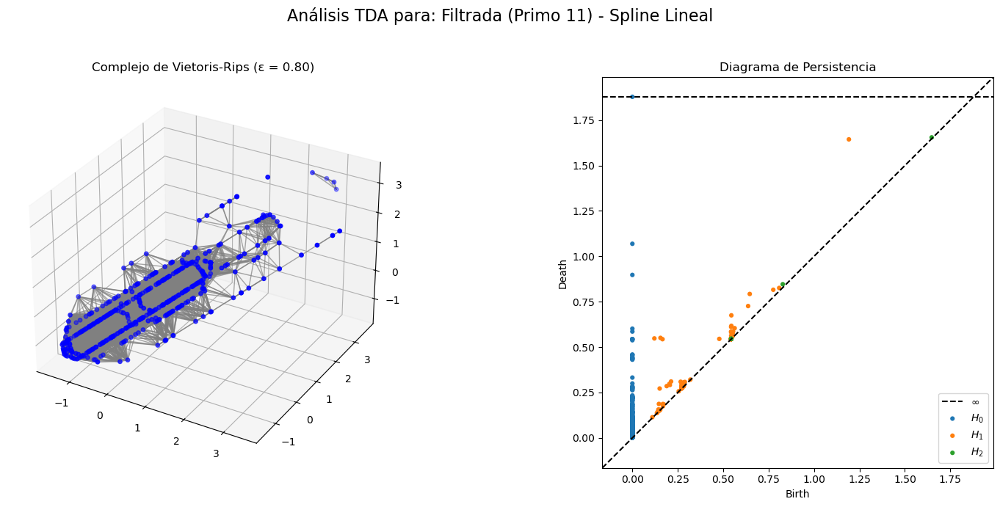

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 11) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 11) - Spline Cúbica ---


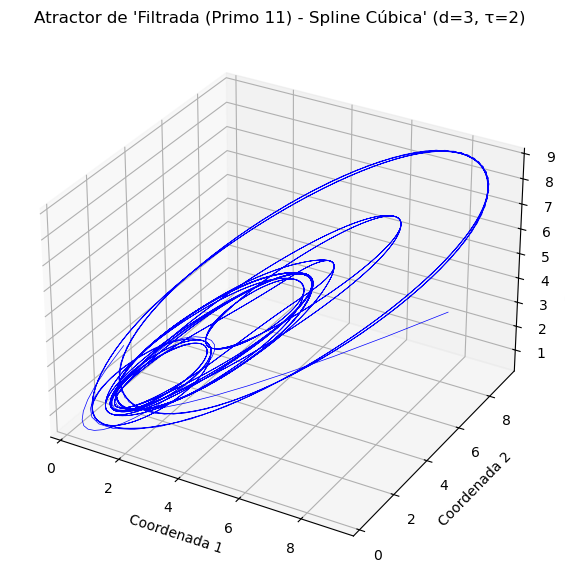

La nube de puntos (1996) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


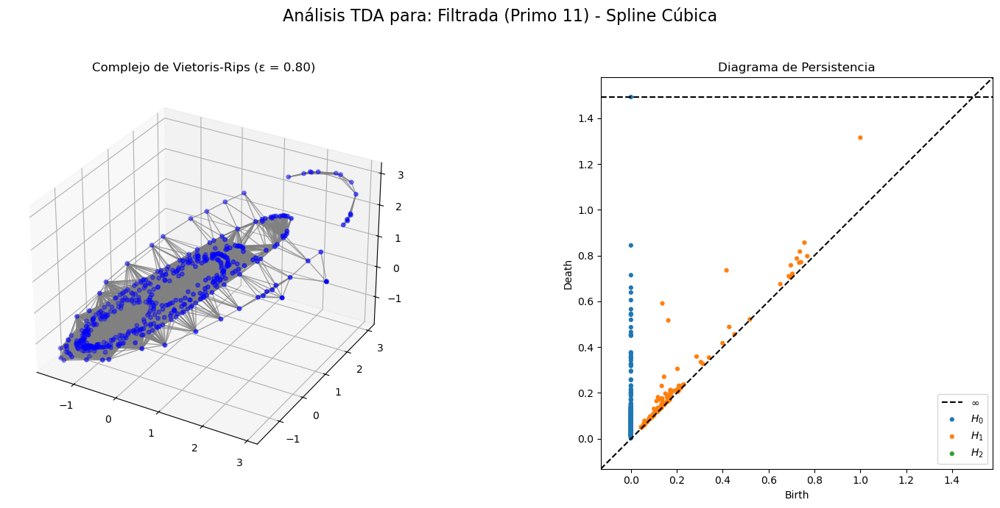

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 11) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 11)' finalizado.

➤ Analizando para el primo: 13
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 3


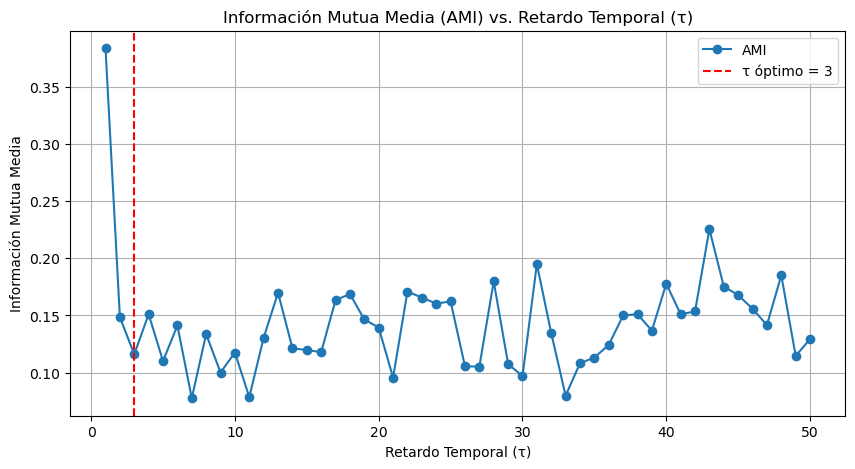


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


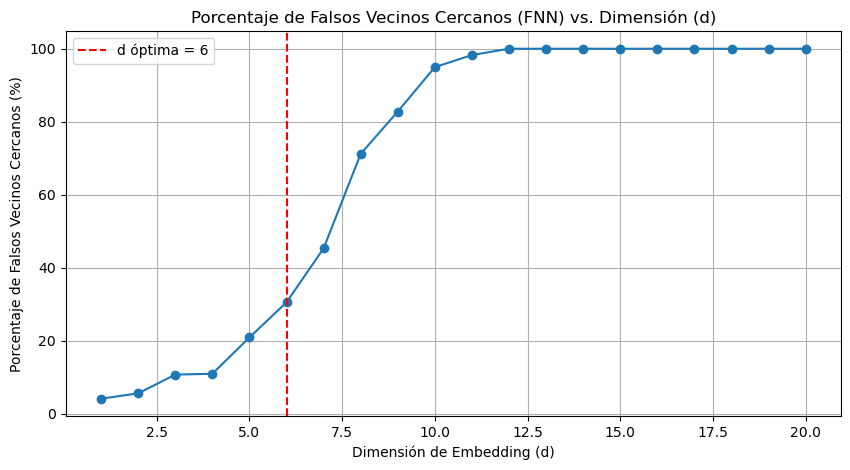


Parámetros de embedding detectados para 'Filtrada (Primo 13)': Dimensión (d) = 6, Retardo (τ) = 3
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


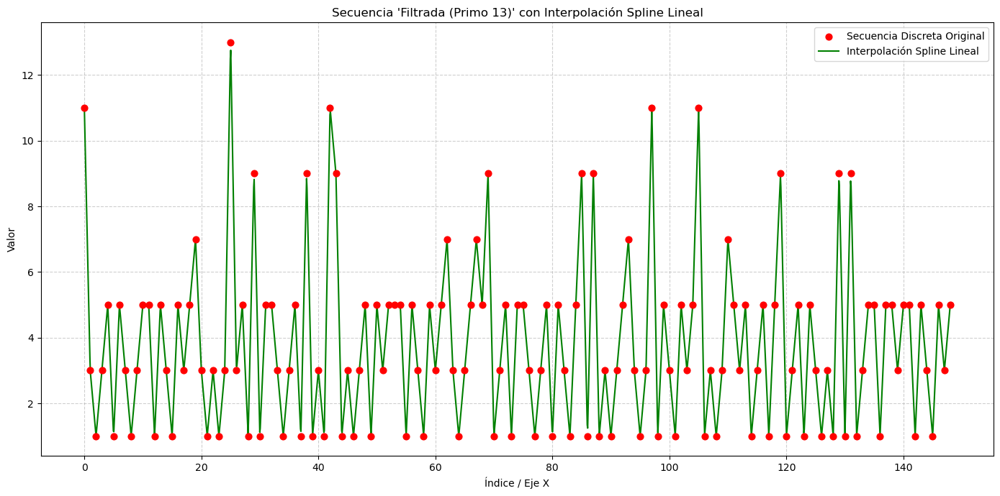

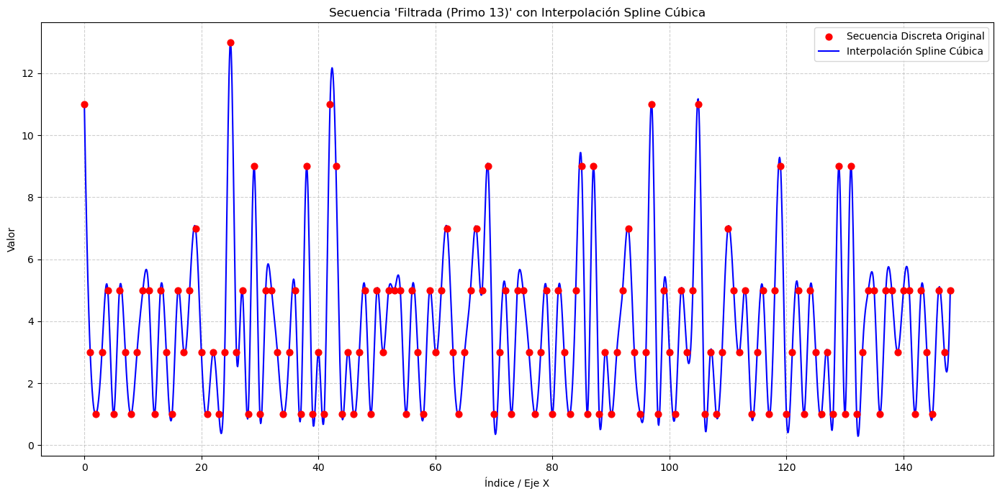


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 13) - Discreta ---


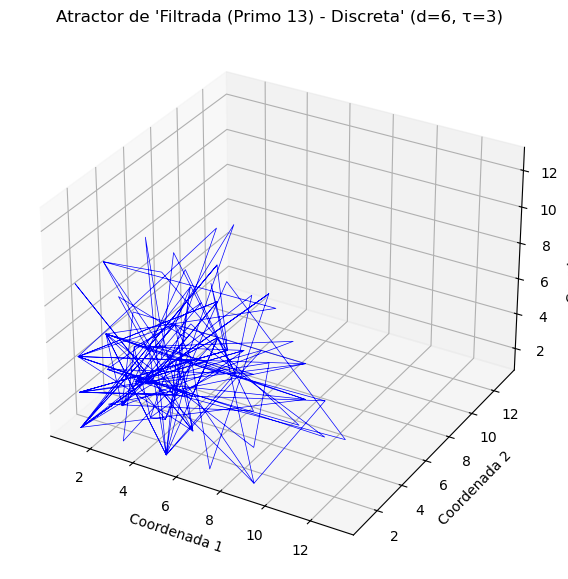

Análisis de persistencia se realizará en 134 puntos.


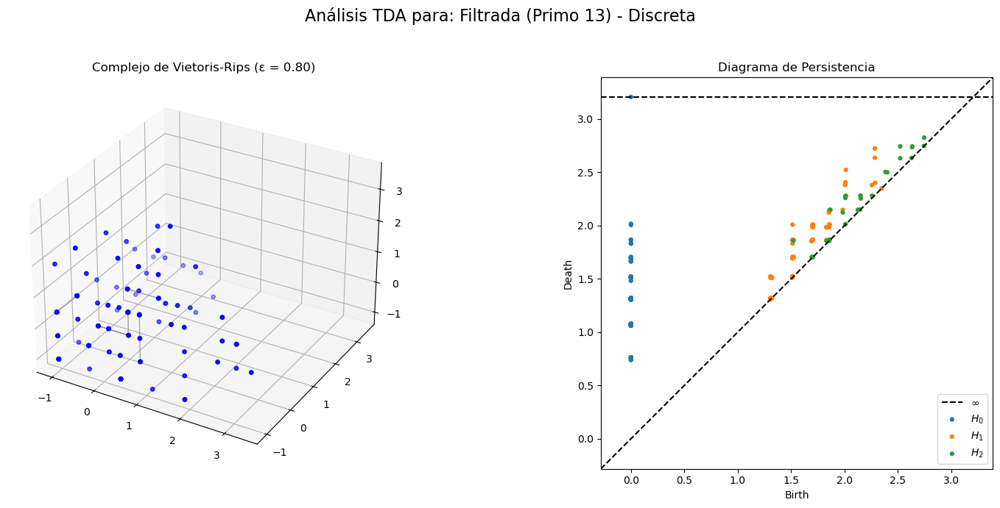

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 13) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 13) - Spline Lineal ---


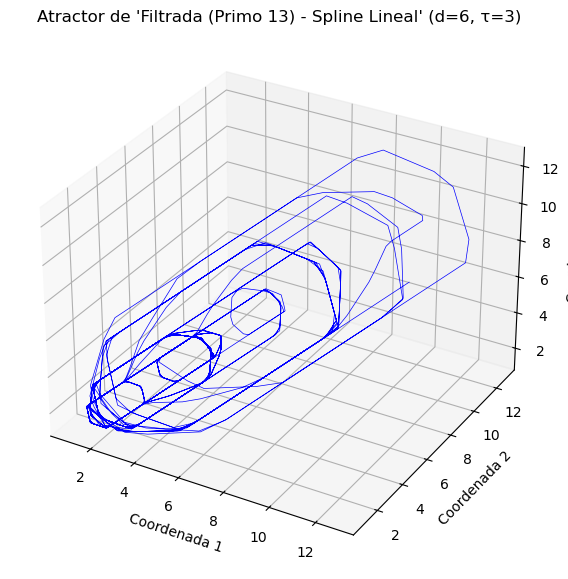

La nube de puntos (1985) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


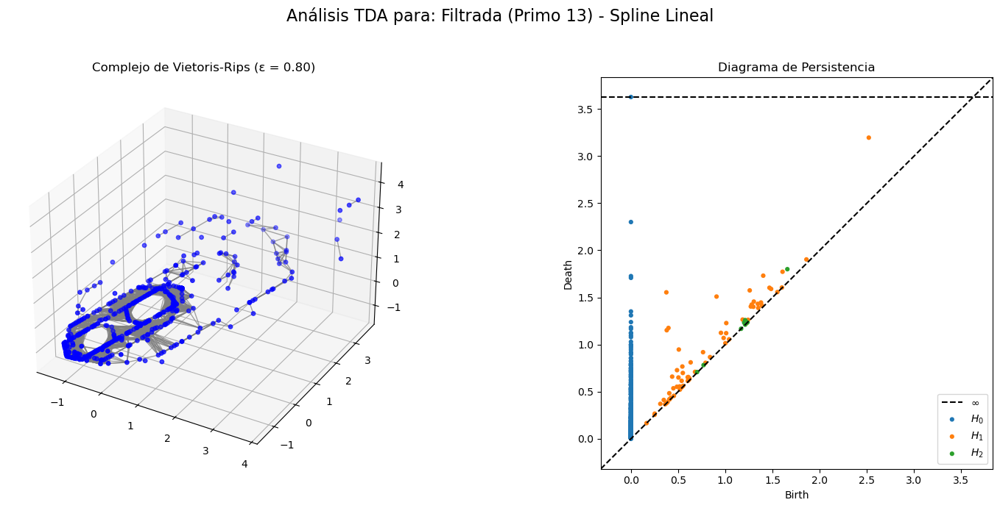

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 13) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 13) - Spline Cúbica ---


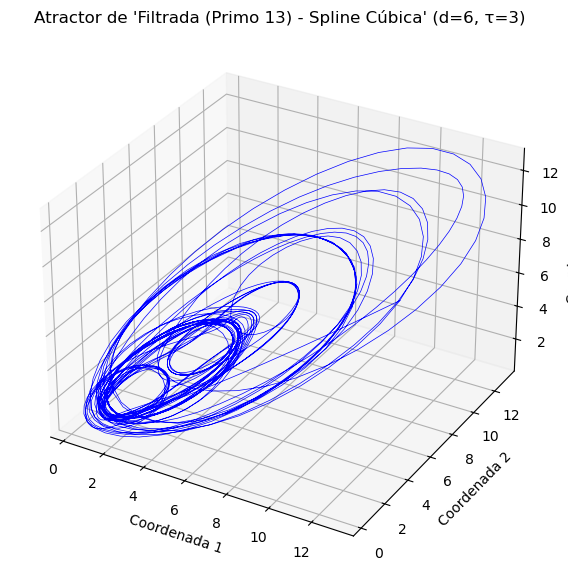

La nube de puntos (1985) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


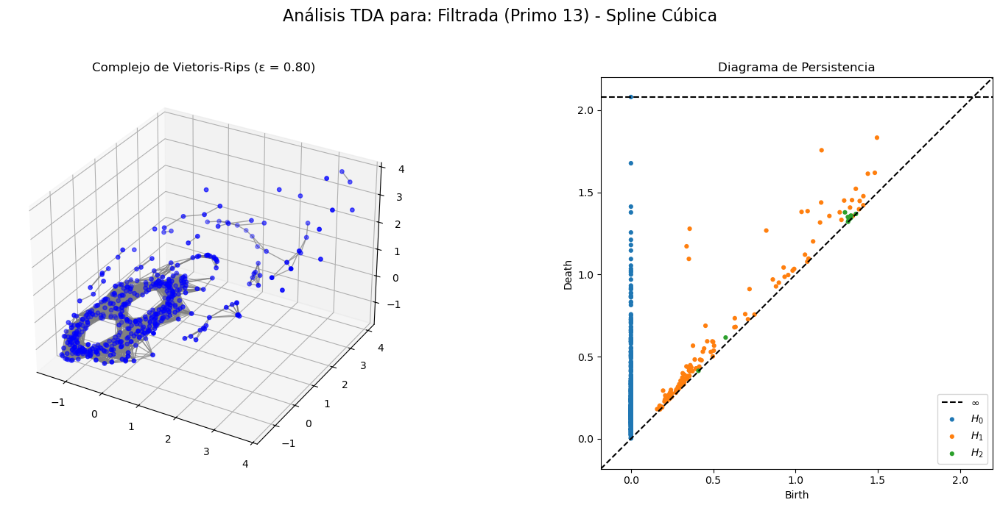

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 13) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 13)' finalizado.

➤ Analizando para el primo: 17
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 3


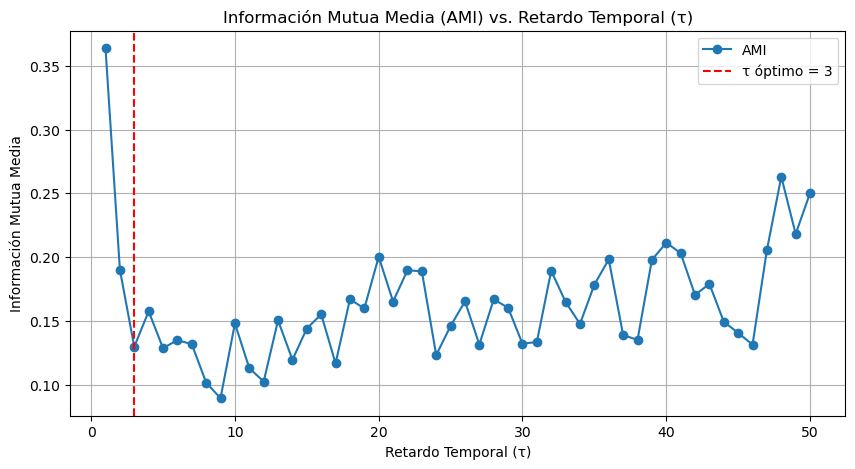


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


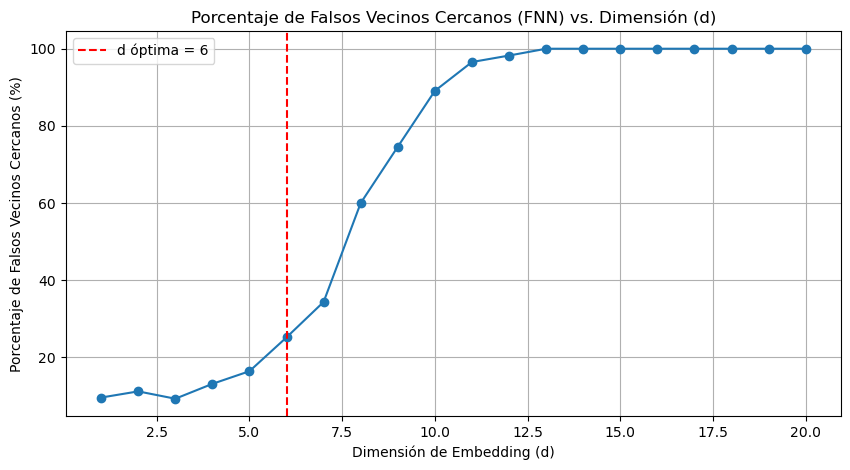


Parámetros de embedding detectados para 'Filtrada (Primo 17)': Dimensión (d) = 6, Retardo (τ) = 3
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


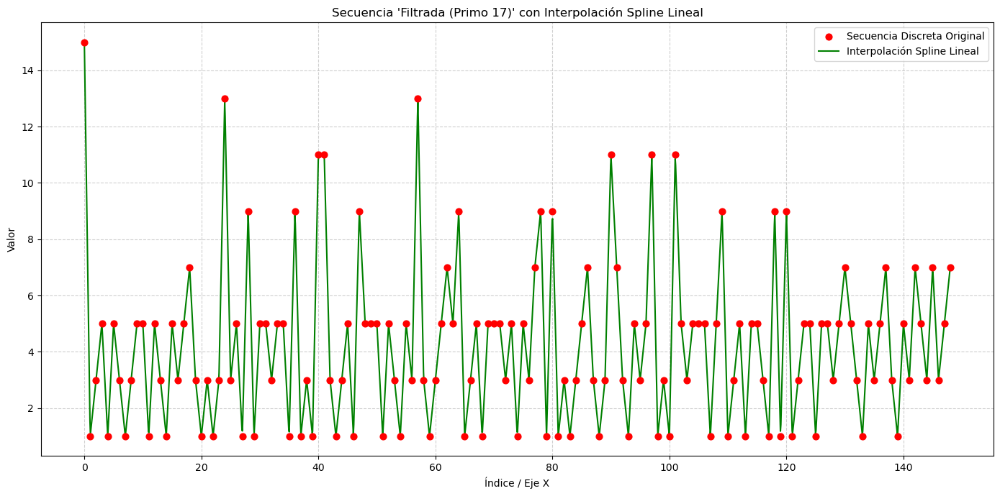

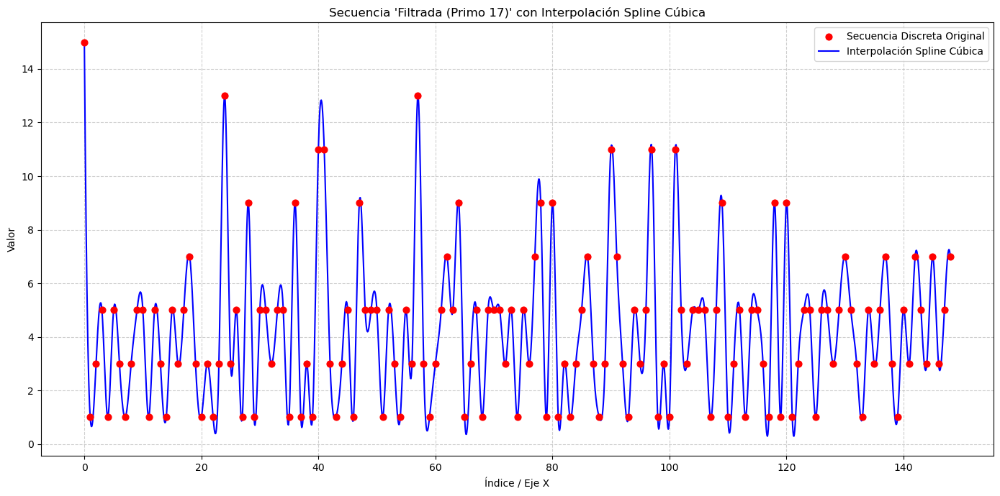


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 17) - Discreta ---


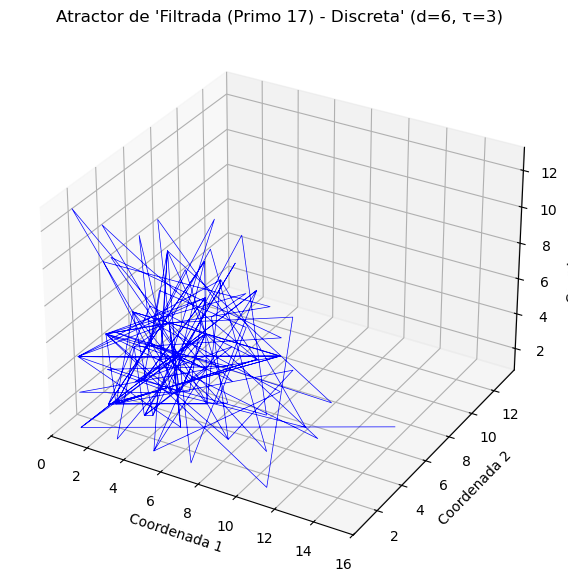

Análisis de persistencia se realizará en 134 puntos.


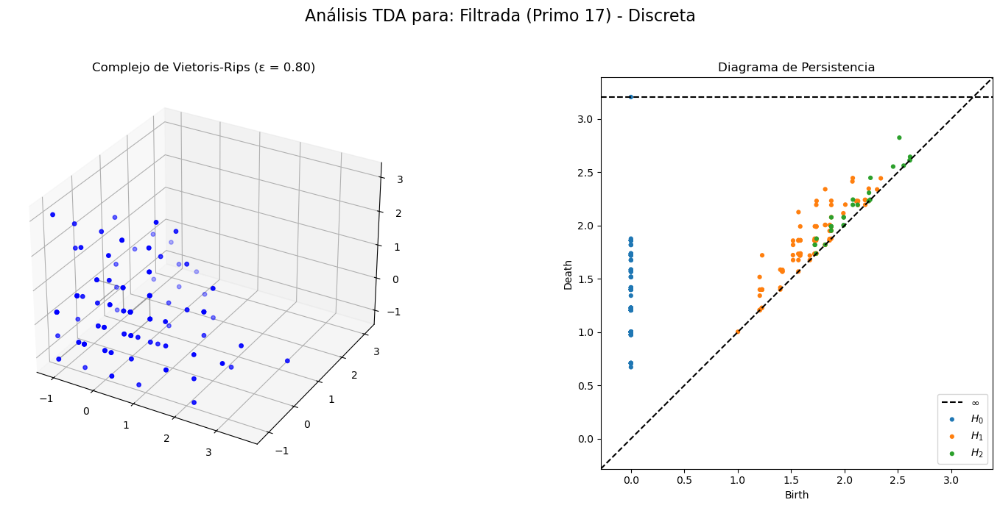

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 17) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 17) - Spline Lineal ---


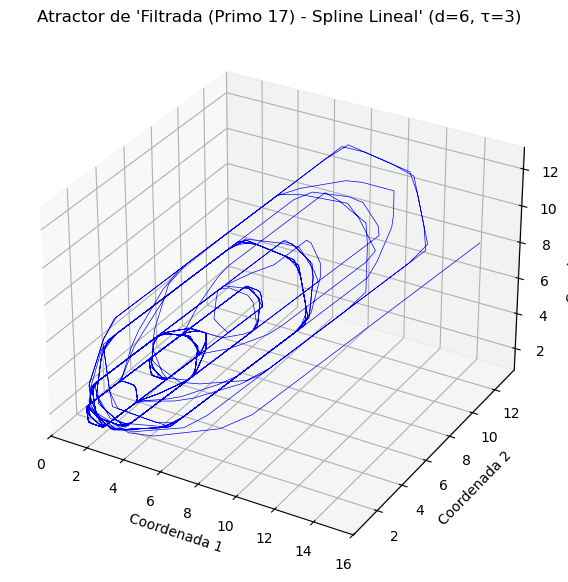

La nube de puntos (1985) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


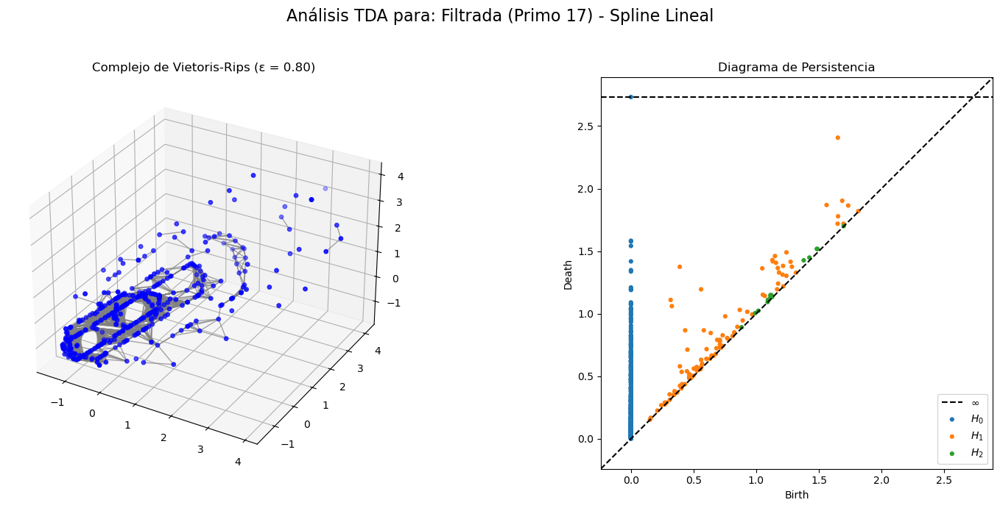

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 17) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 17) - Spline Cúbica ---


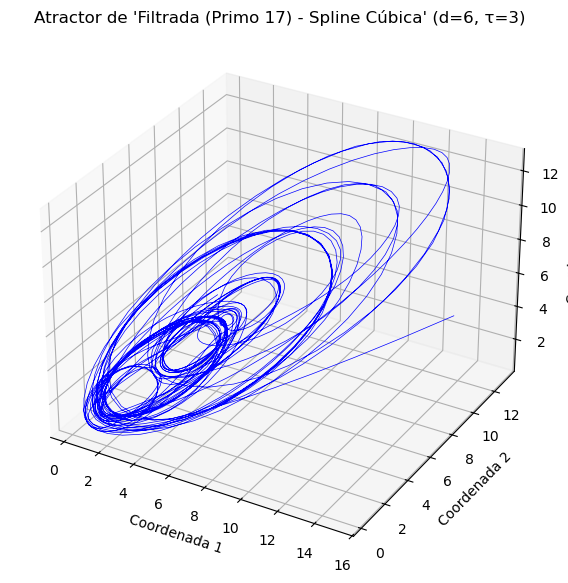

La nube de puntos (1985) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


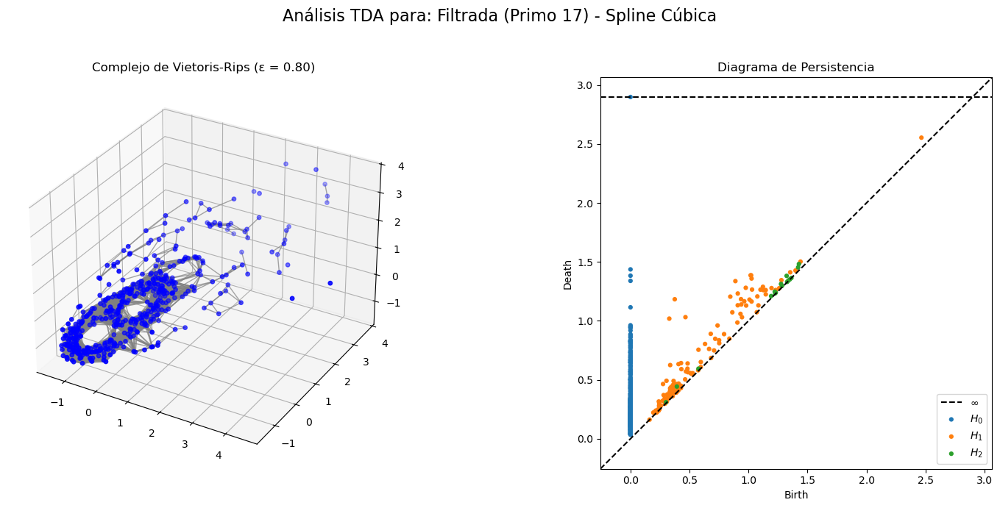

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 17) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 17)' finalizado.

➤ Analizando para el primo: 19
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 4


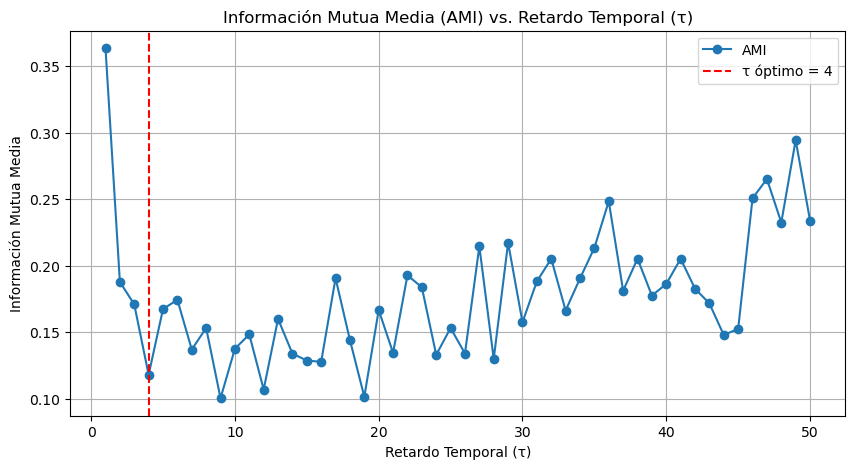


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


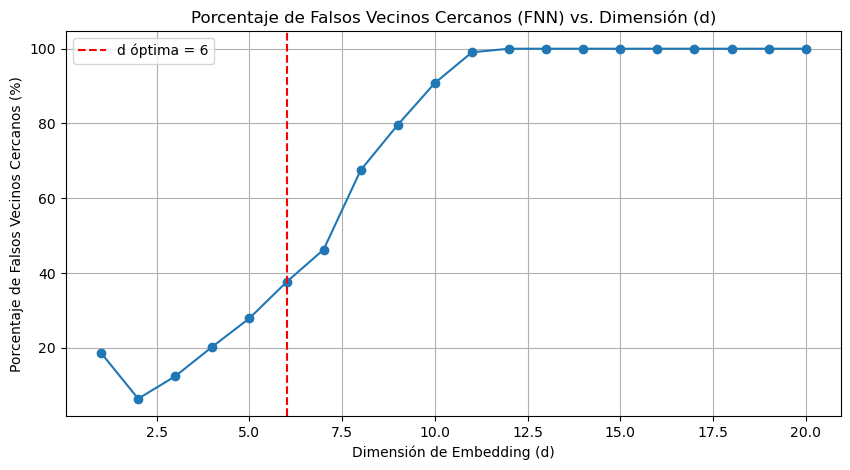


Parámetros de embedding detectados para 'Filtrada (Primo 19)': Dimensión (d) = 6, Retardo (τ) = 4
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


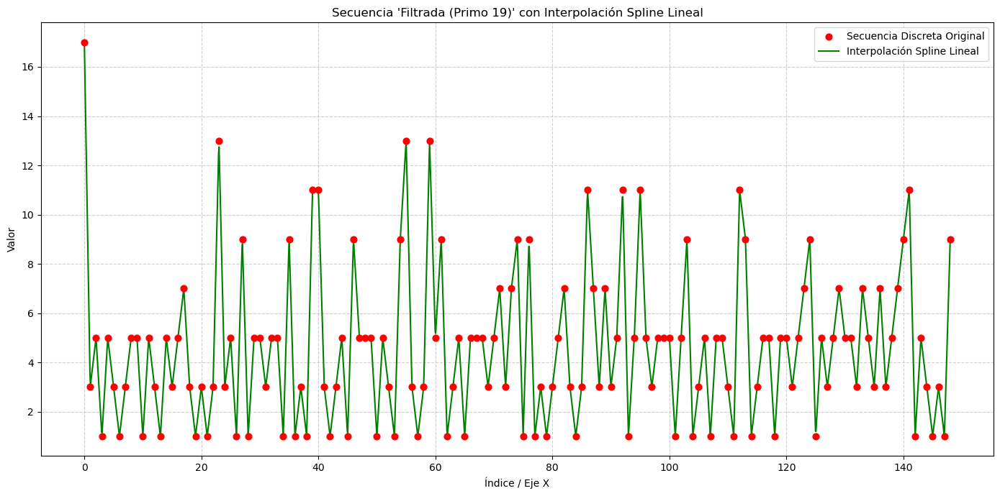

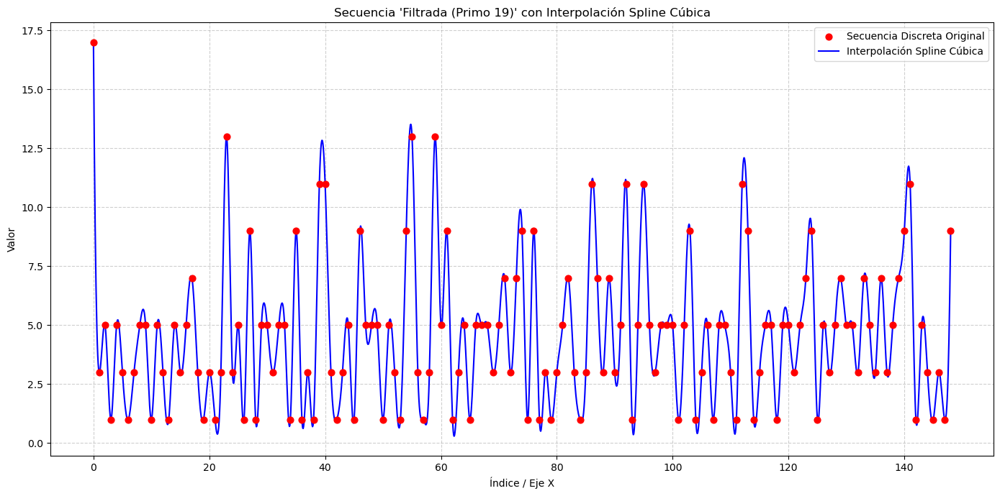


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 19) - Discreta ---


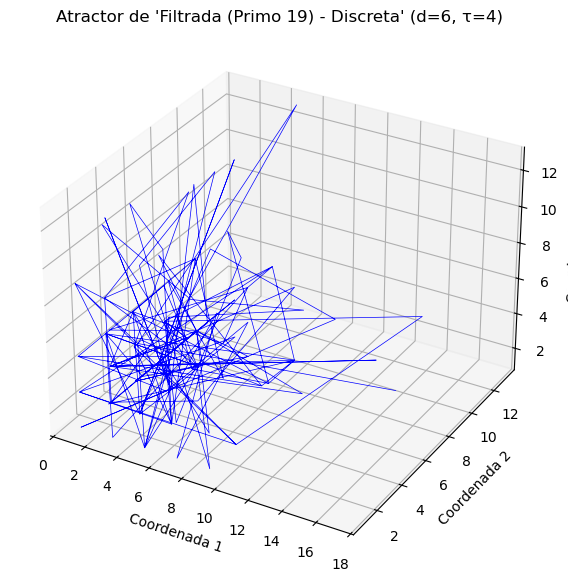

Análisis de persistencia se realizará en 129 puntos.


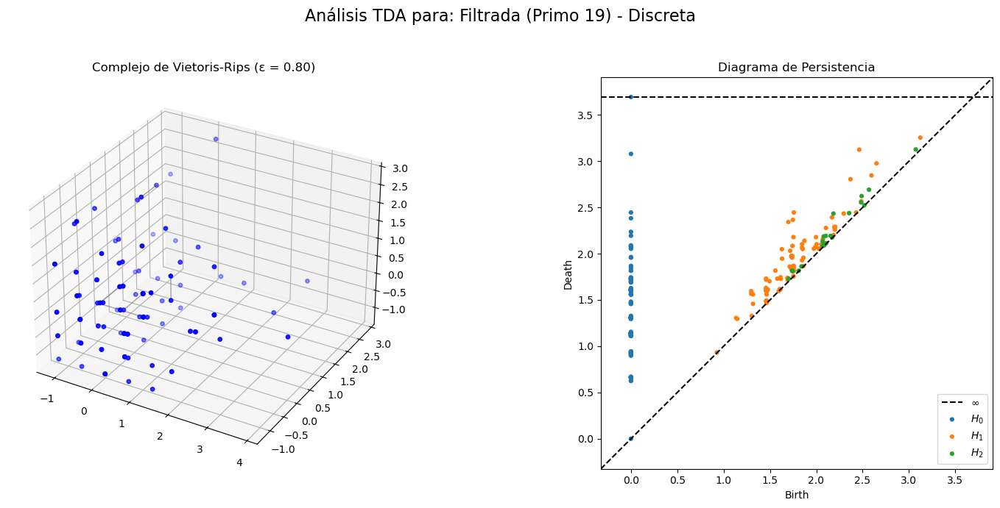

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 19) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 19) - Spline Lineal ---


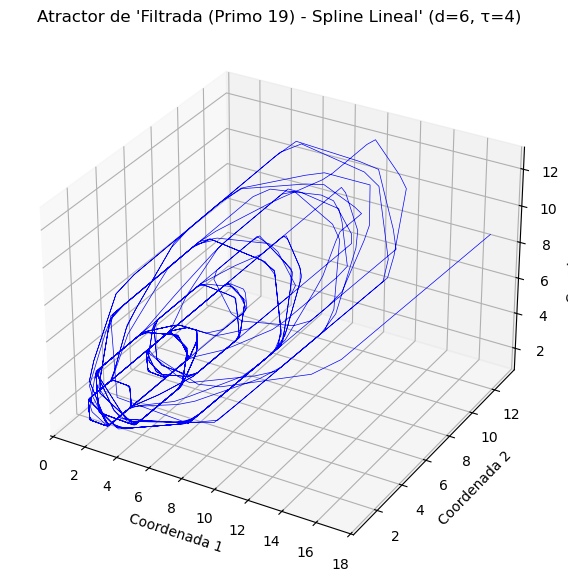

La nube de puntos (1980) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


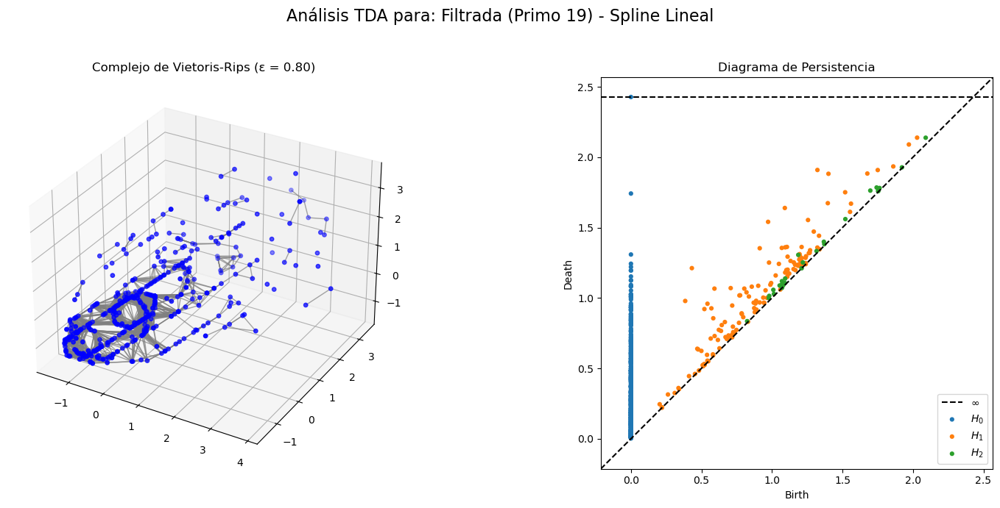

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 19) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 19) - Spline Cúbica ---


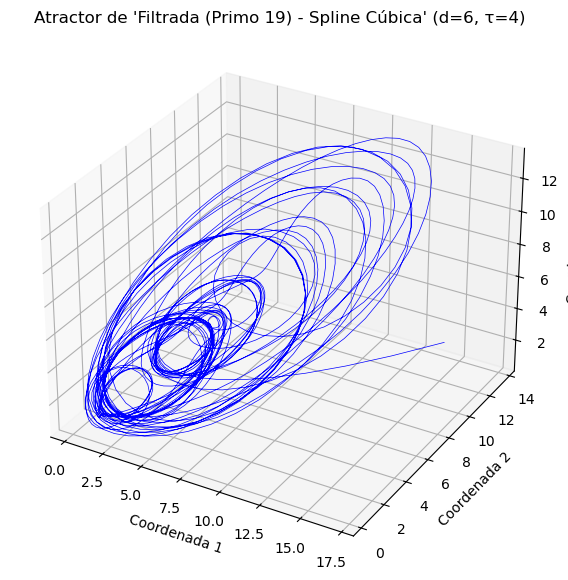

La nube de puntos (1980) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


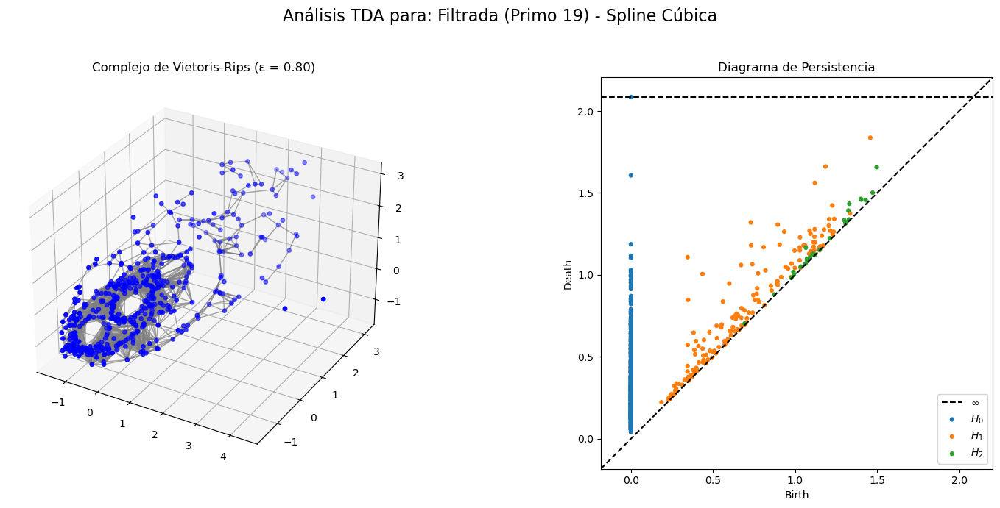

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 19) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 19)' finalizado.

➤ Analizando para el primo: 23
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 2


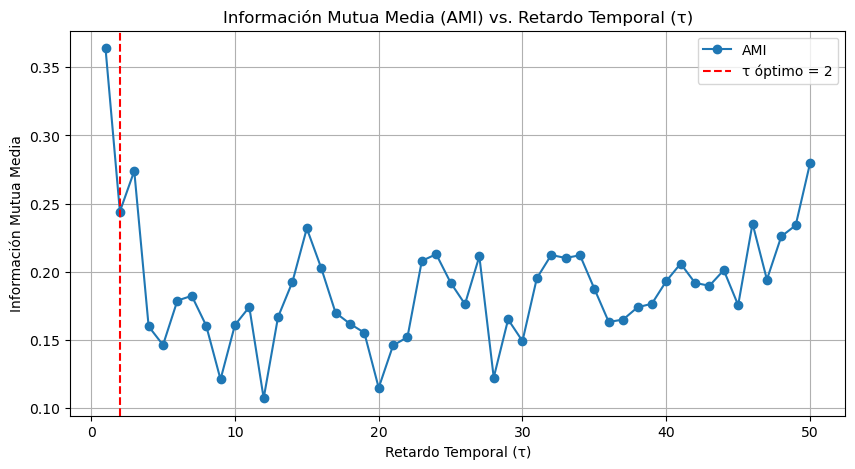


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


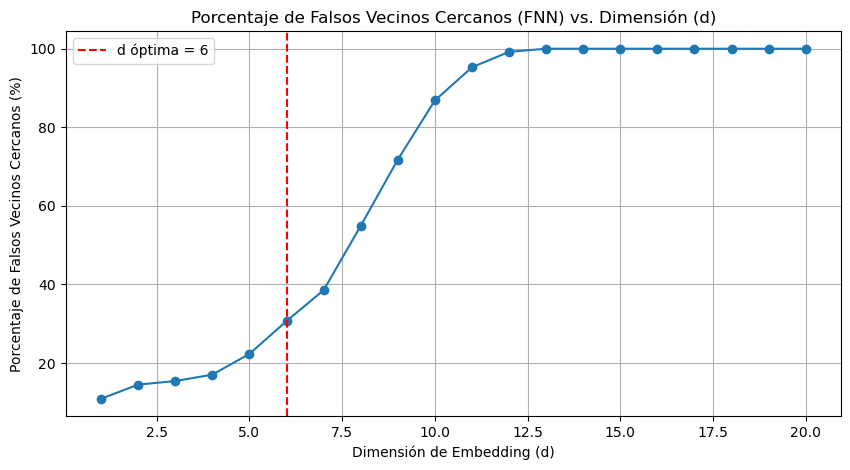


Parámetros de embedding detectados para 'Filtrada (Primo 23)': Dimensión (d) = 6, Retardo (τ) = 2
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


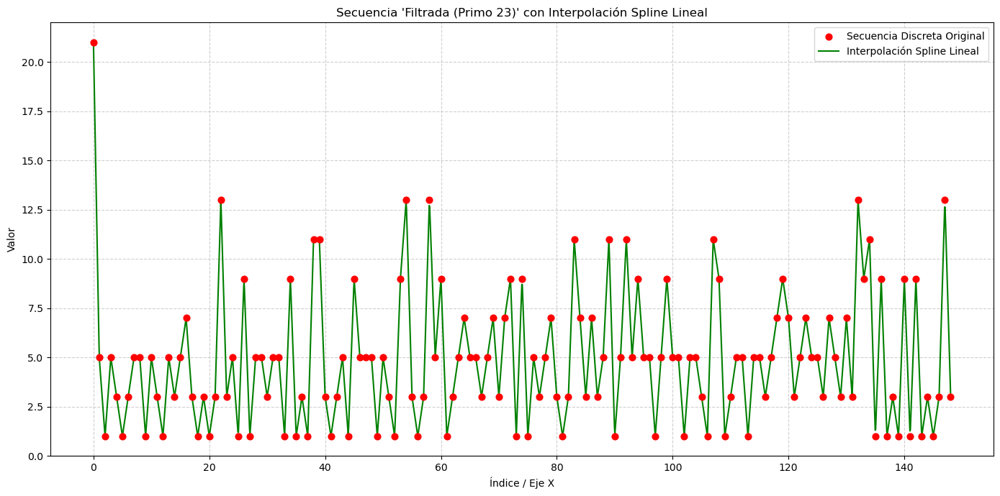

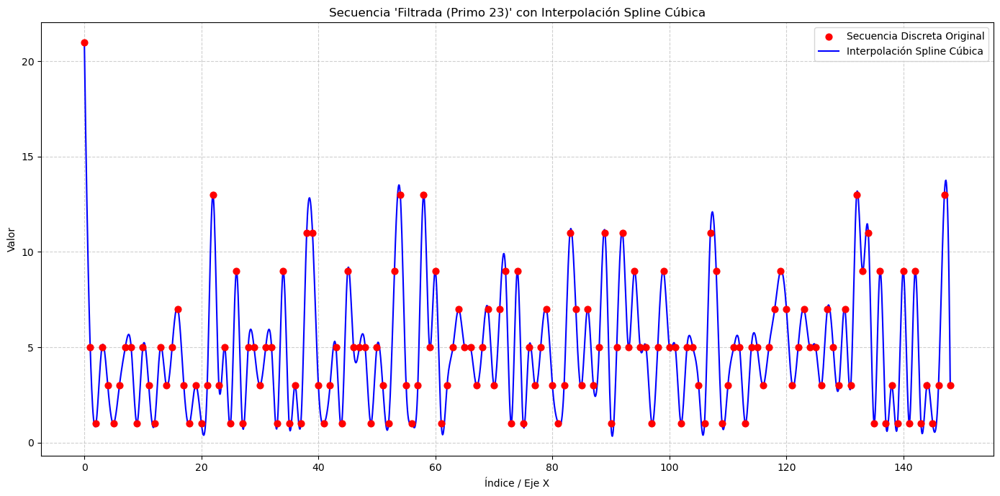


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 23) - Discreta ---


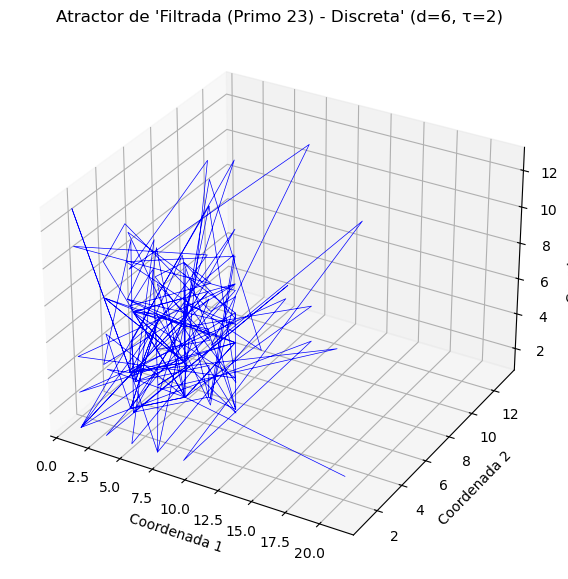

Análisis de persistencia se realizará en 139 puntos.


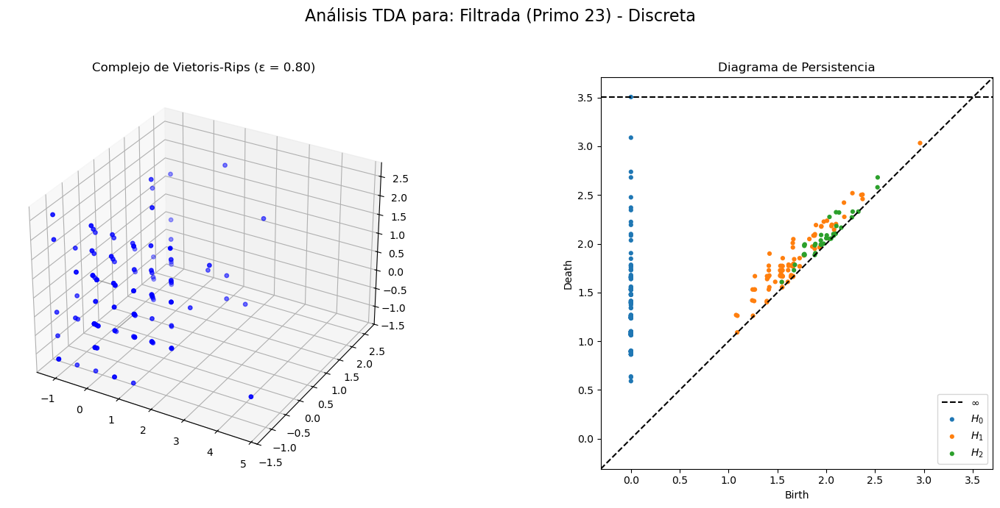

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 23) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 23) - Spline Lineal ---


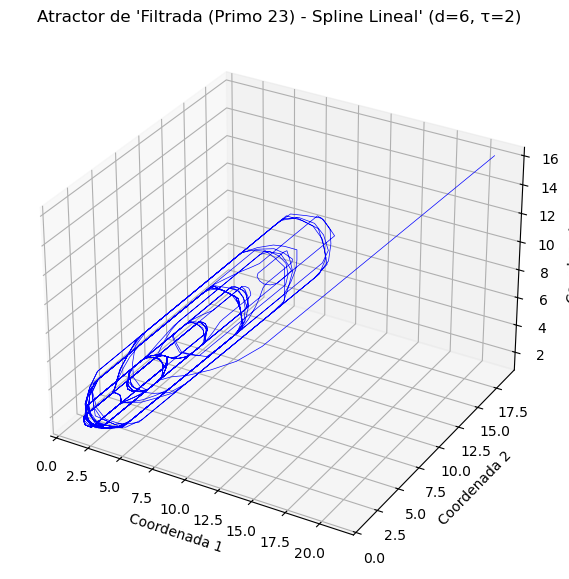

La nube de puntos (1990) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


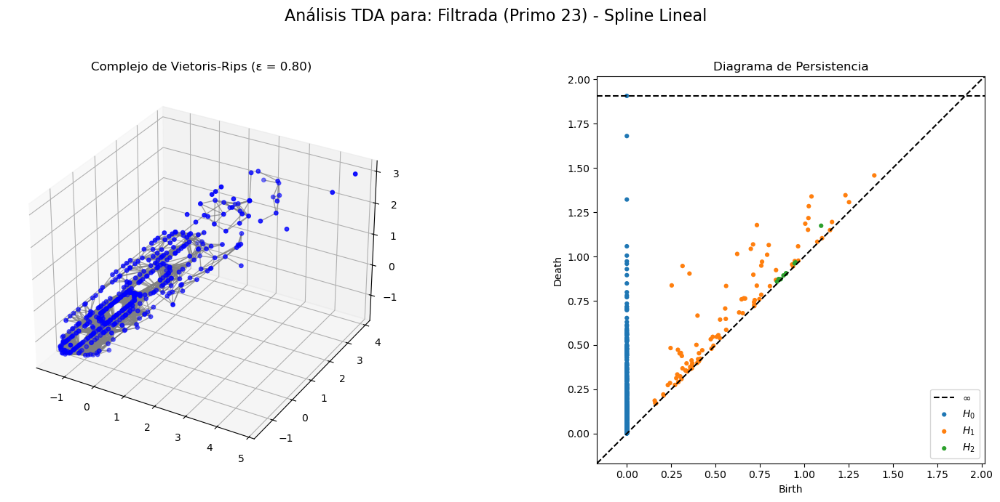

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 23) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 23) - Spline Cúbica ---


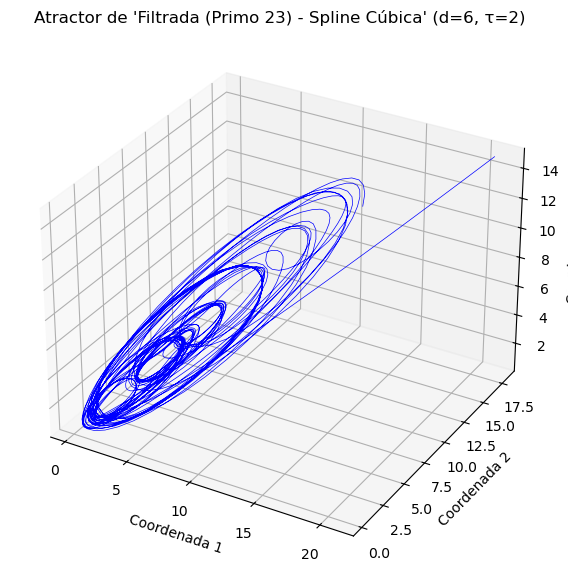

La nube de puntos (1990) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


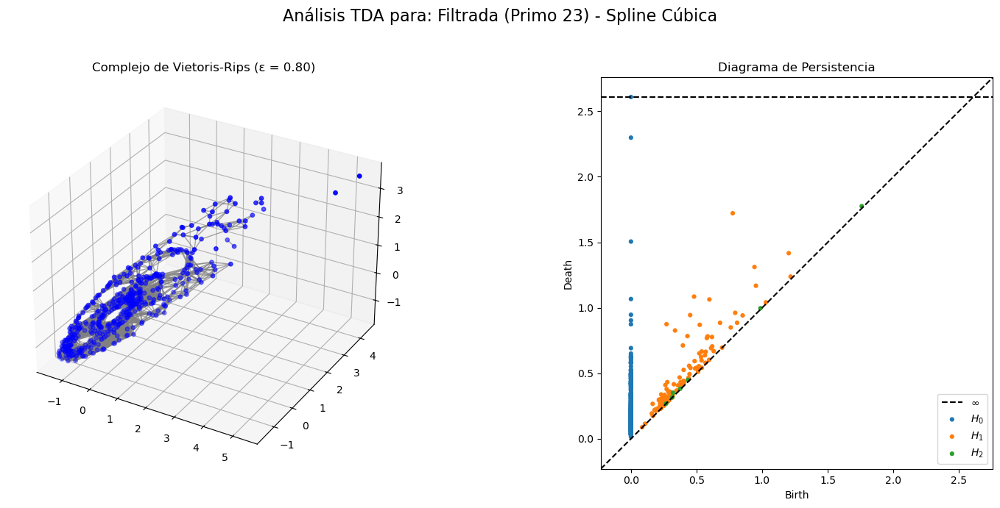

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 23) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 23)' finalizado.

➤ Analizando para el primo: 29
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 5


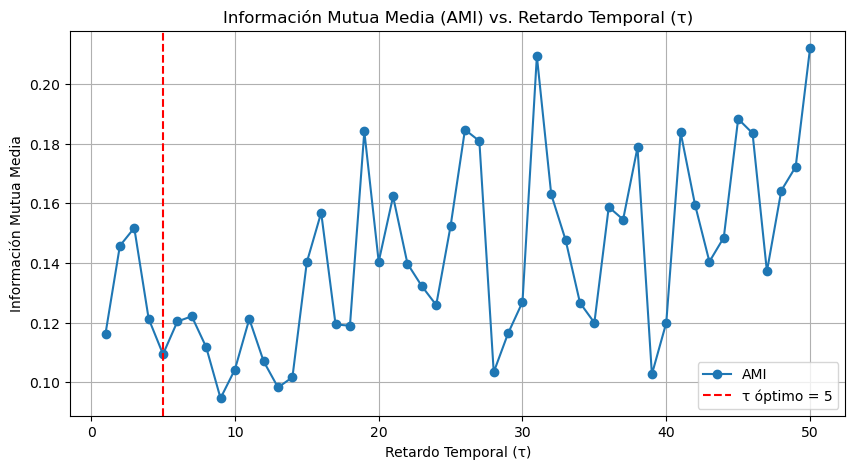


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


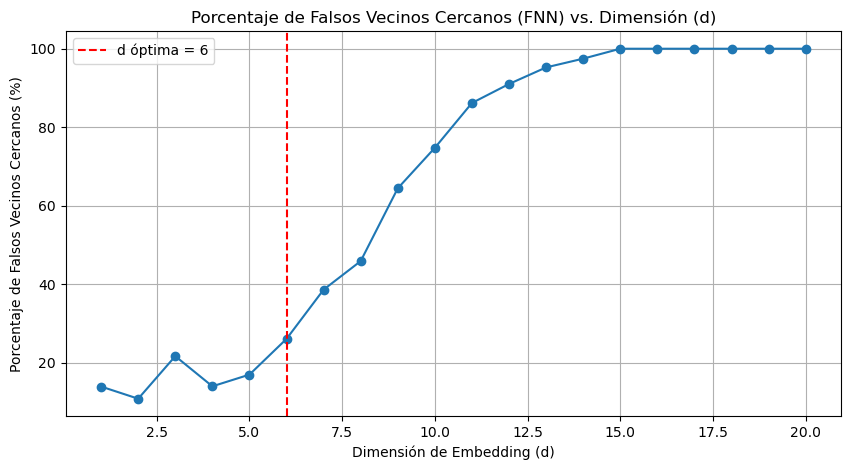


Parámetros de embedding detectados para 'Filtrada (Primo 29)': Dimensión (d) = 6, Retardo (τ) = 5
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


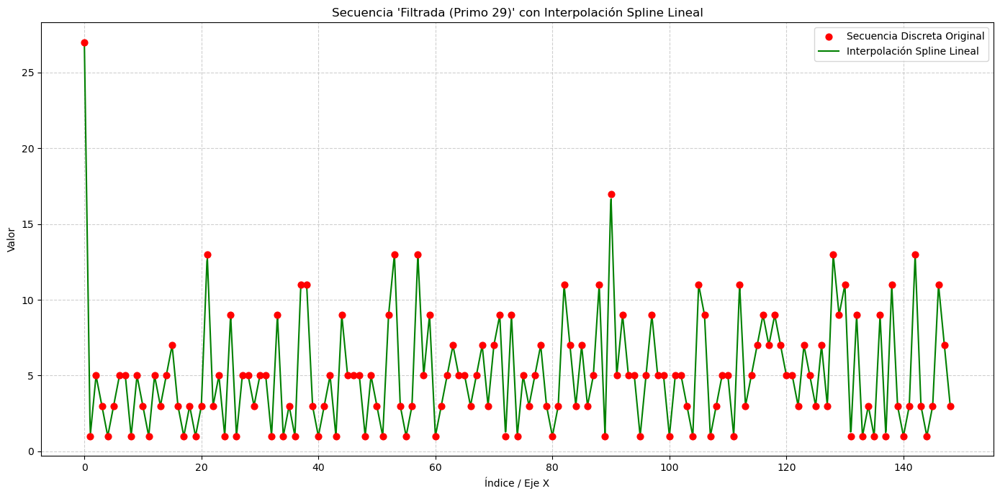

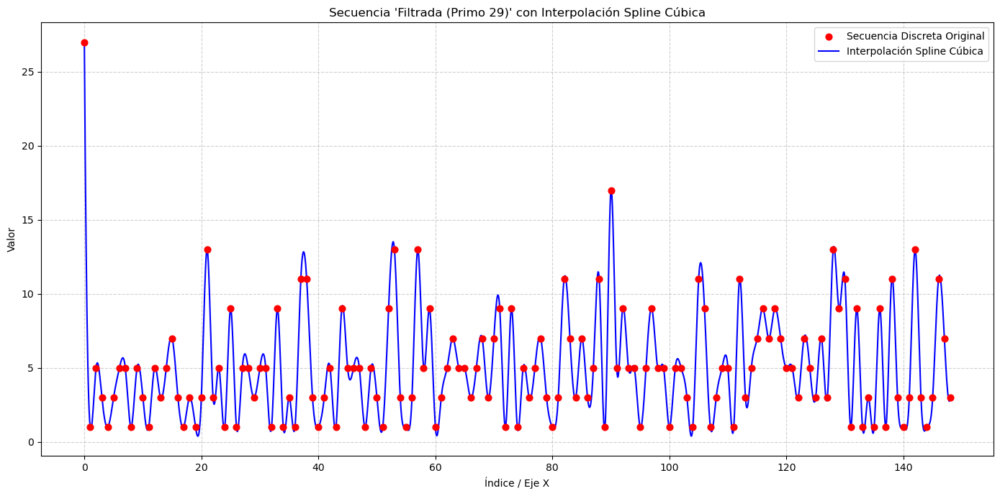


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 29) - Discreta ---


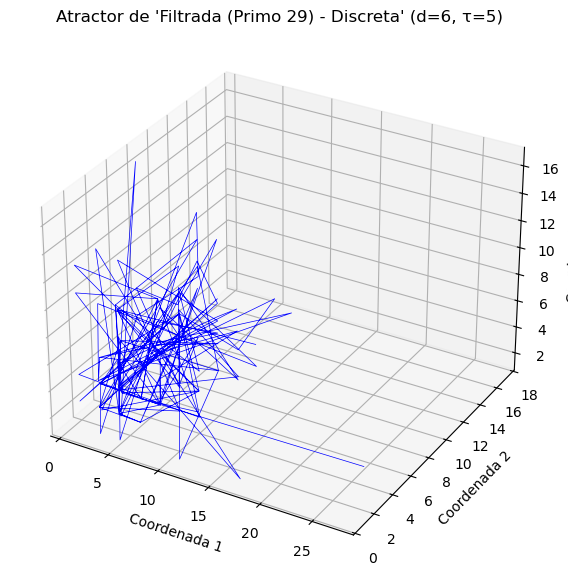

Análisis de persistencia se realizará en 124 puntos.


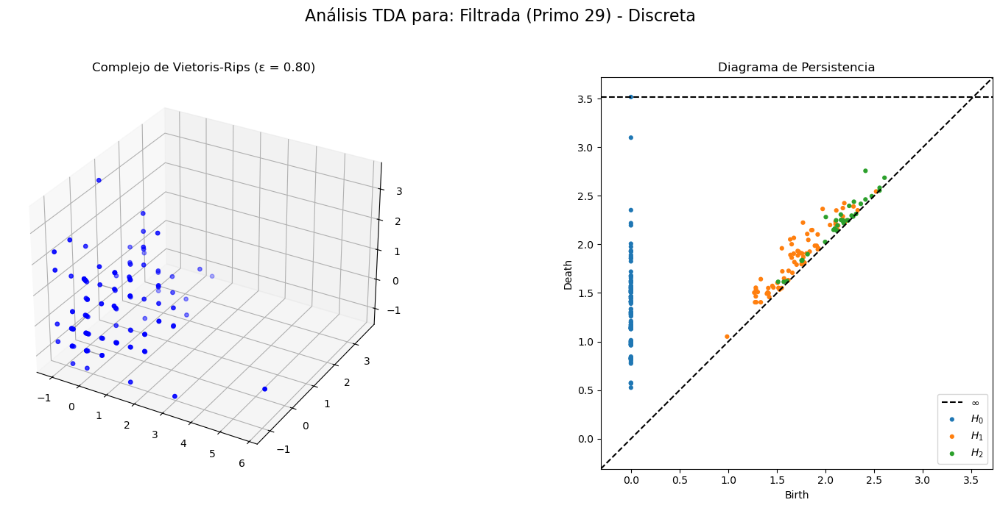

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 29) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 29) - Spline Lineal ---


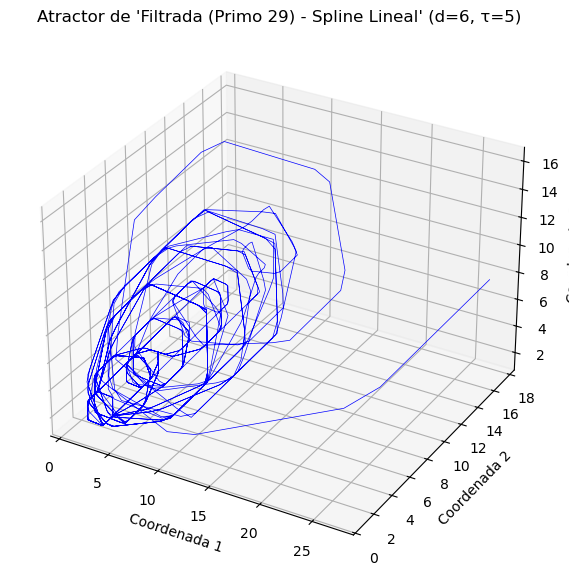

La nube de puntos (1975) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


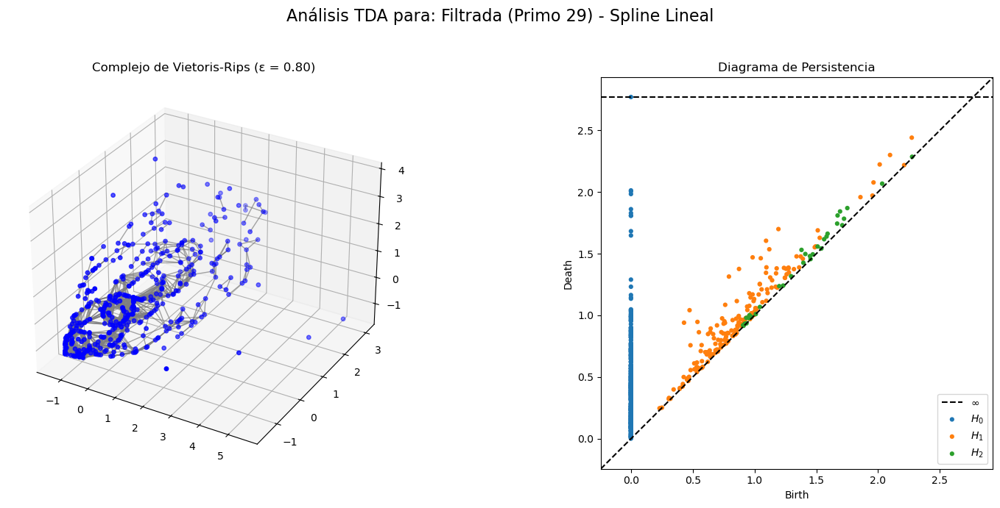

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 29) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 29) - Spline Cúbica ---


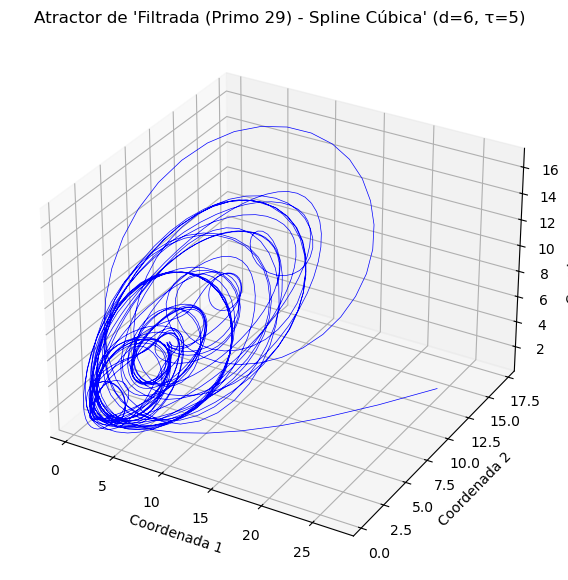

La nube de puntos (1975) excede el máximo (500). Submuestreando...
Análisis de persistencia se realizará en 500 puntos.


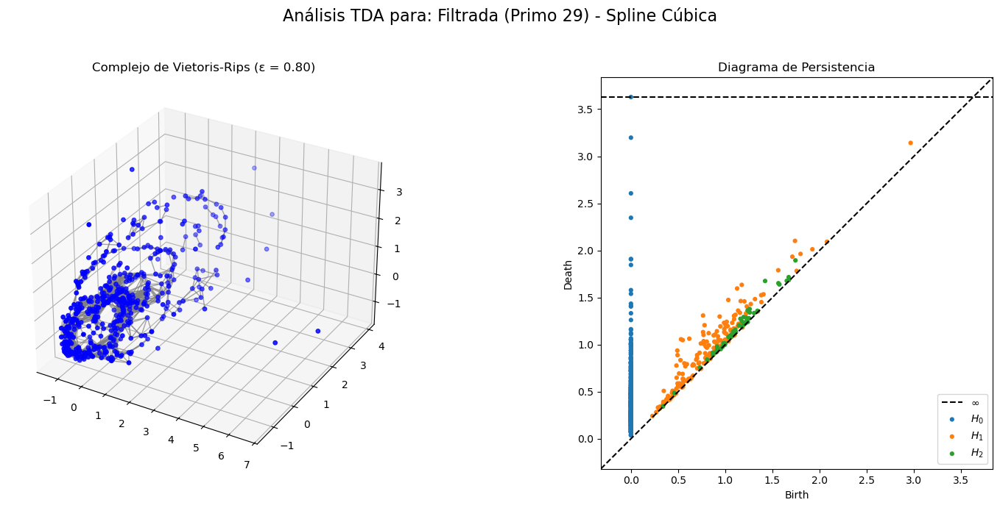

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 29) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 29)' finalizado.


In [26]:
# ==============================================================================
# BLOQUE DE EJECUCIÓN PRINCIPAL
# ==============================================================================
if __name__ == '__main__':    
    # --- 1. Parámetros de Configuración ---
    # Parámetros para el análisis TDA y la visualización.
    PARAMETROS_TDA = {
        "puntos_interpolacion": 2000,
        "epsilon_vr": 0.8,
        "num_componentes_trig": 50,
        "max_puntos_tda": 500,
        "semilla": 52
    }
    # Parámetros para la detección automática de d y τ.
    PARAMETROS_AUTO_EMBEDDING = {
        "max_tau_ami": 50,
        "max_dim_fnn": 20
    }
    for prime in primerange(7,30):
        # --- 2. Elige la Secuencia a Analizar ---
        secuencia_a_analizar = generar_secuencia_filtrada(primo_base=prime, longitud_deseada=150)
        nombre = f"Filtrada (Primo {prime})"
    
        secuencia_np = np.array(secuencia_a_analizar)
        
        # Se llama a las funciones de selección para obtener los parámetros óptimos.
        tau_optimo = seleccionar_tau_optimo(secuencia_np, max_tau=PARAMETROS_AUTO_EMBEDDING["max_tau_ami"])
        dim_optima = seleccionar_dim_optima(secuencia_np, tau=tau_optimo, max_dim=PARAMETROS_AUTO_EMBEDDING["max_dim_fnn"])
    
        print(f"\nParámetros de embedding detectados para '{nombre}': Dimensión (d) = {dim_optima}, Retardo (τ) = {tau_optimo}")
    
        # --- 4. Elige qué Análisis Realizar con los parámetros detectados ---
        ejecutar_analisis_completo(
            secuencia_discreta=secuencia_a_analizar,
            nombre_secuencia=nombre,
            dim_emb=dim_optima, 
            tau_emb=tau_optimo,
            tipos_TDA=['discreta','spline1', 'spline3'],
            **PARAMETROS_TDA
        )

### Análisis 2


➤ Analizando para el primo: 7
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 2


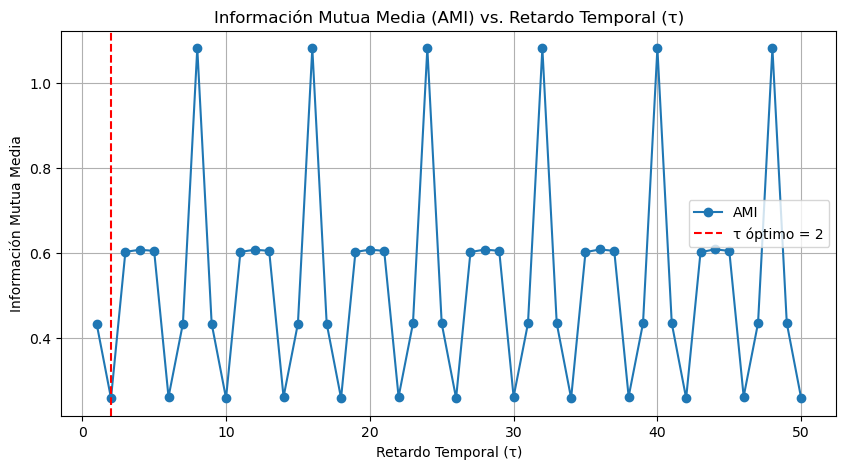


--- Calculando Dimensión de Embedding Óptima (d) ---
Dimensión de embedding óptima (d) encontrada: 2


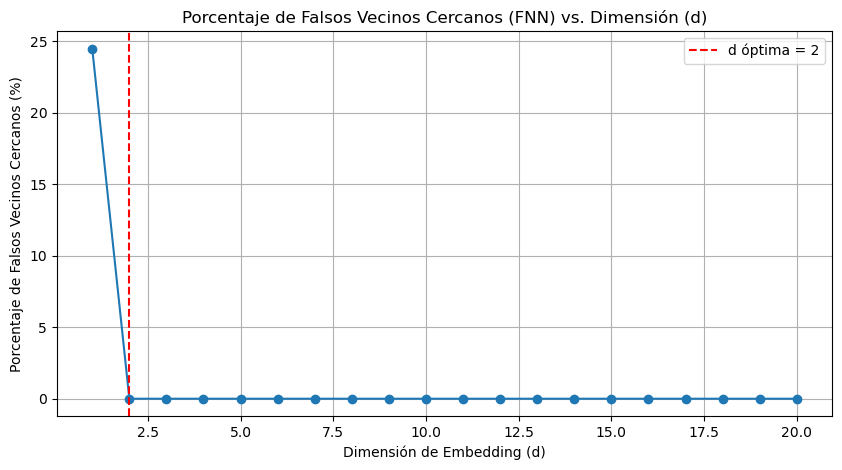


Parámetros de embedding detectados para 'Filtrada (Primo 7)': Dimensión (d) = 2, Retardo (τ) = 2
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


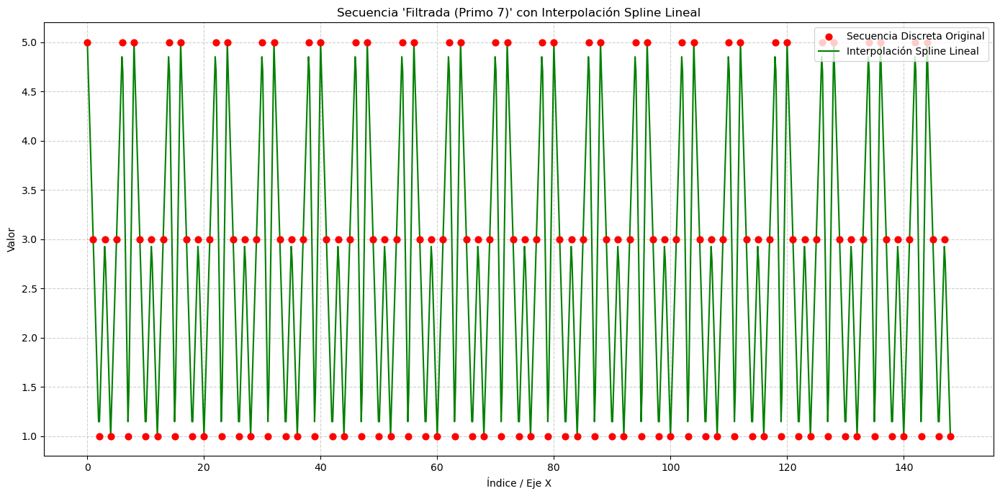

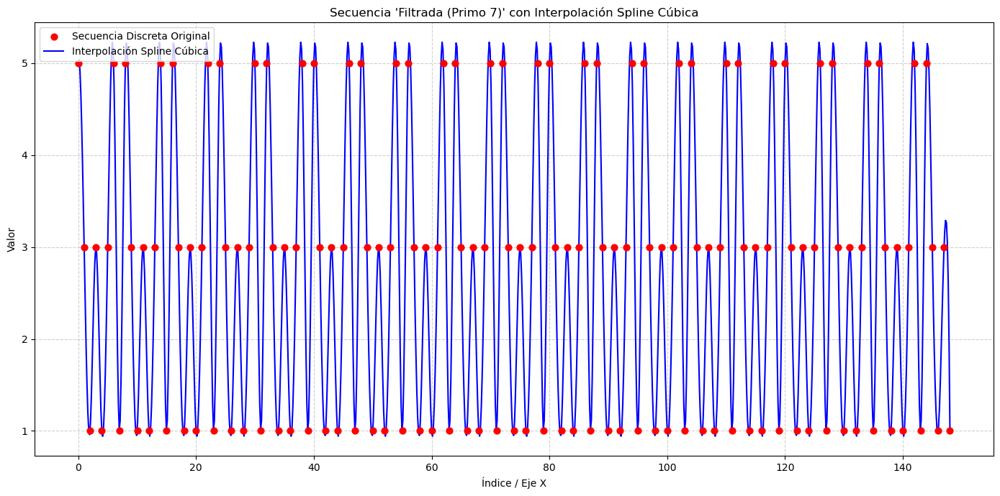


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 7) - Discreta ---


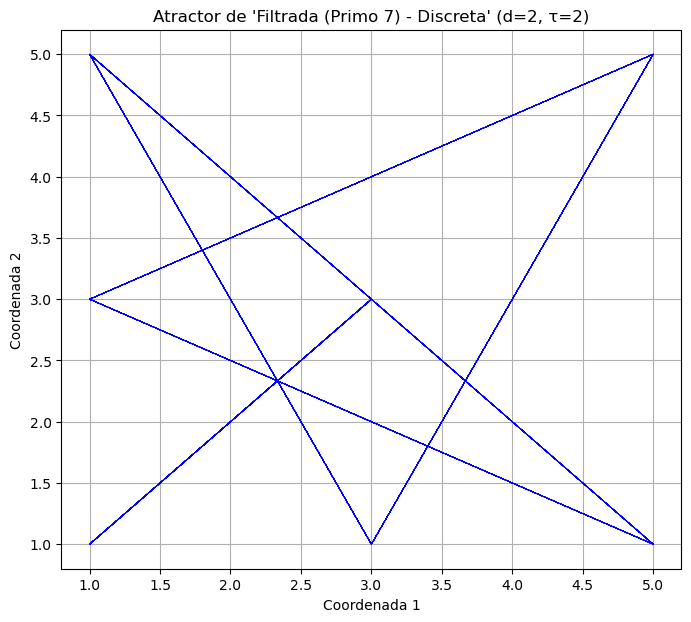

Análisis de persistencia se realizará en 147 puntos.


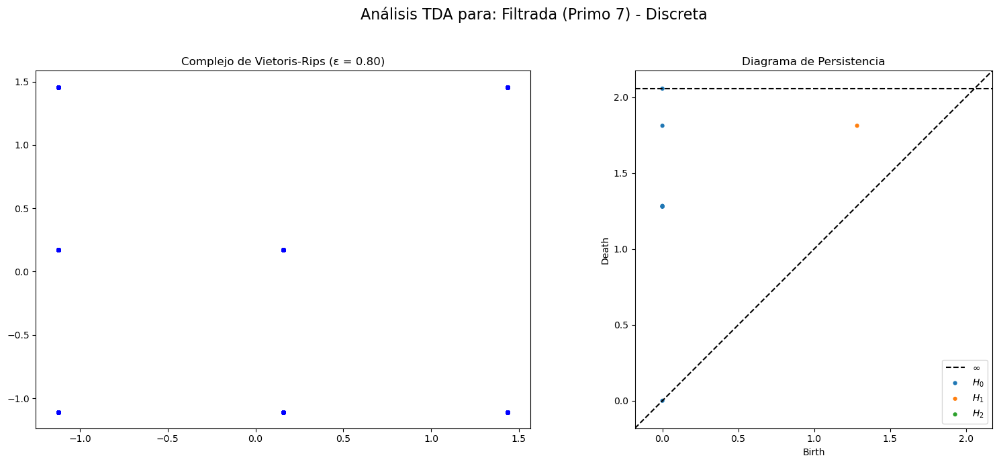

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 7) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 7) - Spline Lineal ---


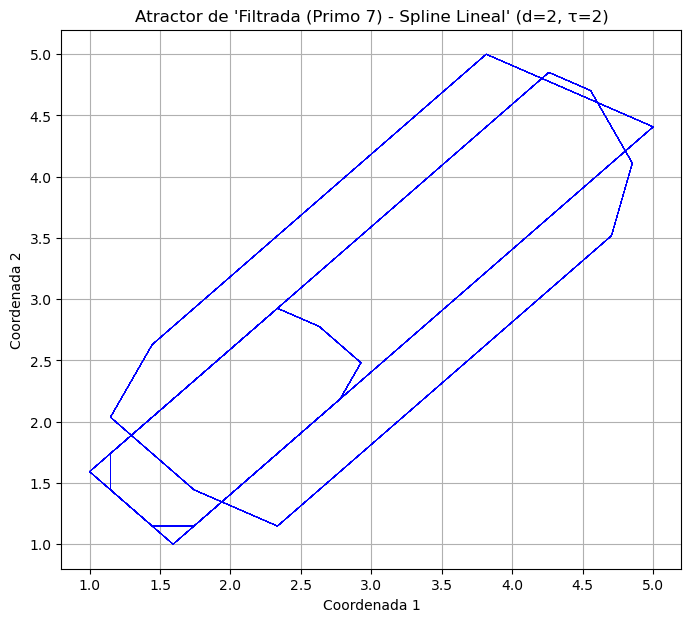

La nube de puntos (998) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


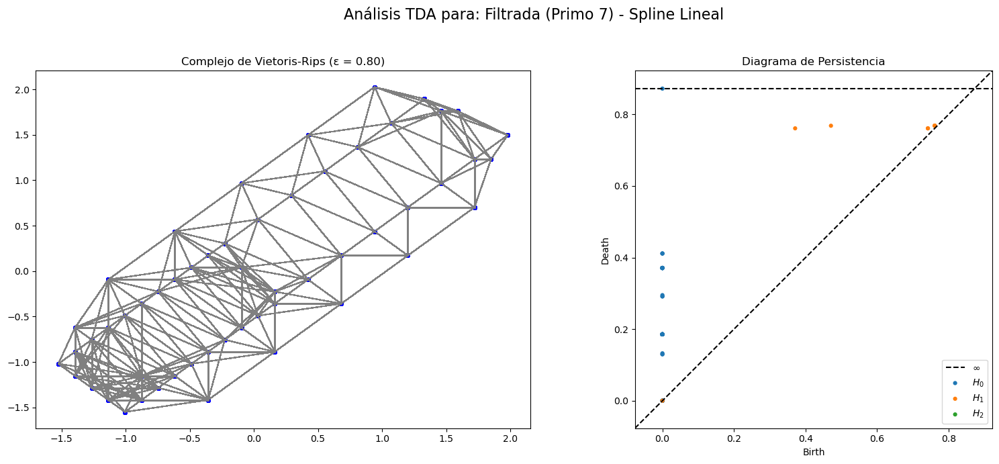

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 7) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 7) - Spline Cúbica ---


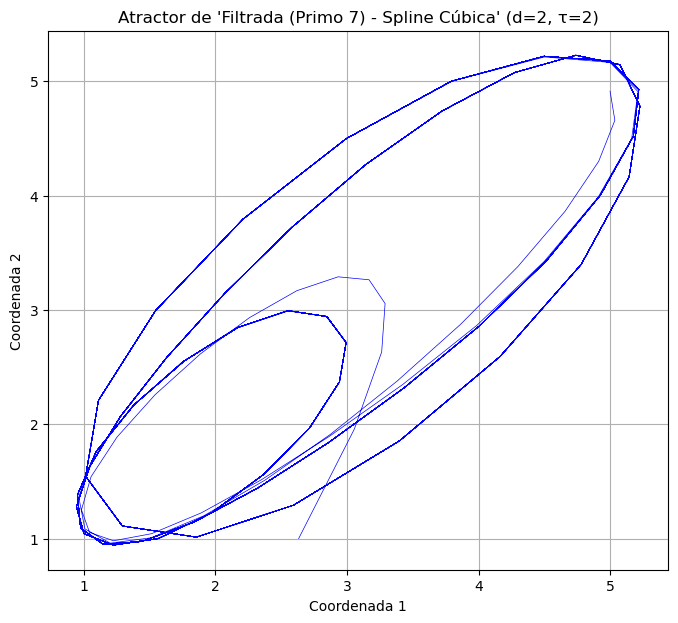

La nube de puntos (998) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


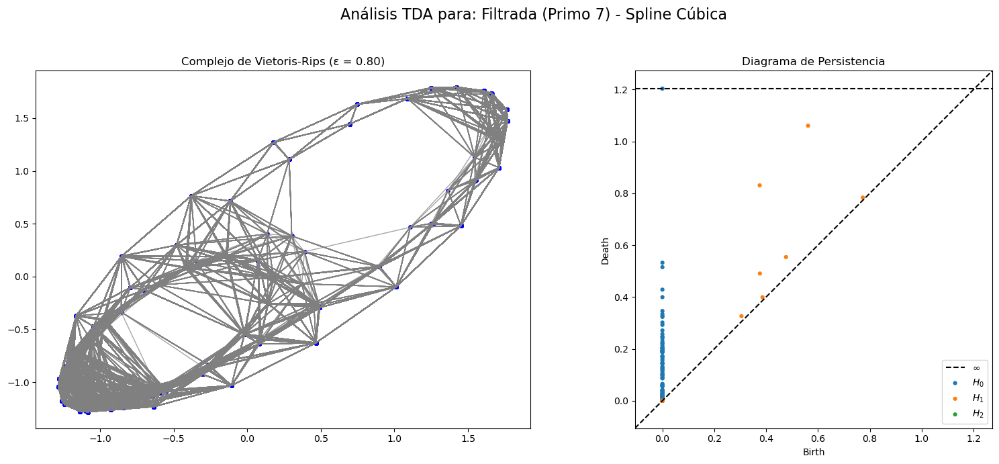

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 7) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 7)' finalizado.

➤ Analizando para el primo: 11
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 2


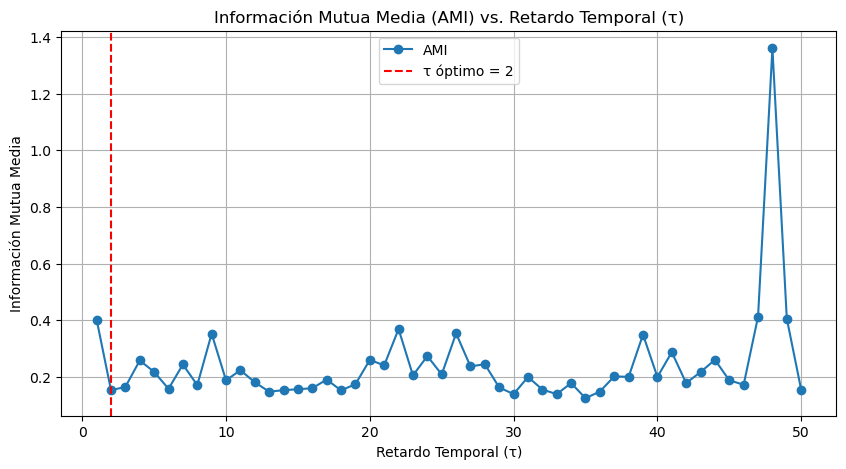


--- Calculando Dimensión de Embedding Óptima (d) ---
Dimensión de embedding óptima (d) encontrada: 3


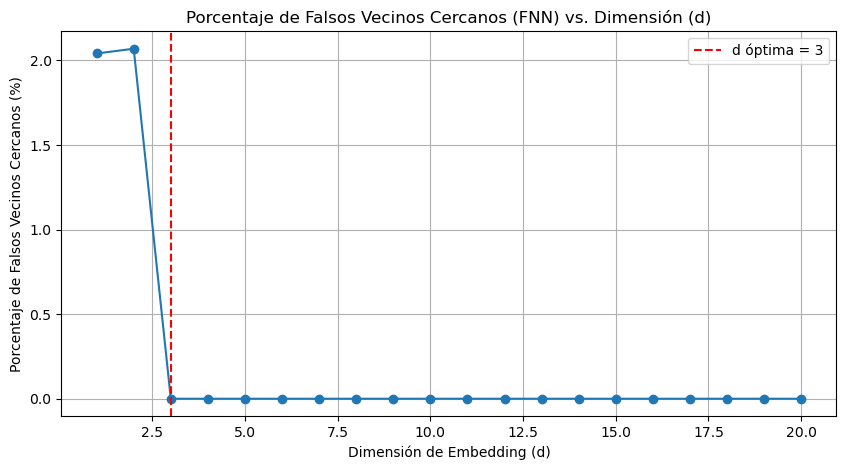


Parámetros de embedding detectados para 'Filtrada (Primo 11)': Dimensión (d) = 3, Retardo (τ) = 2
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


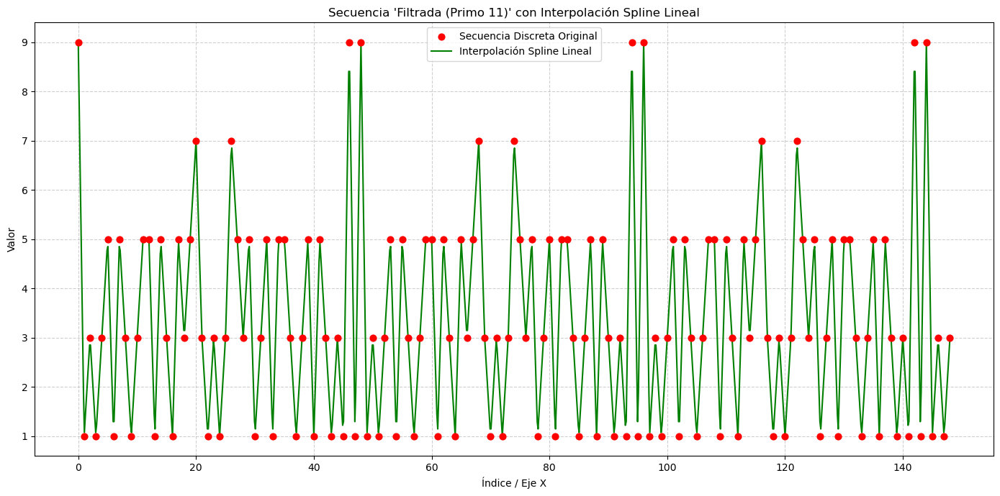

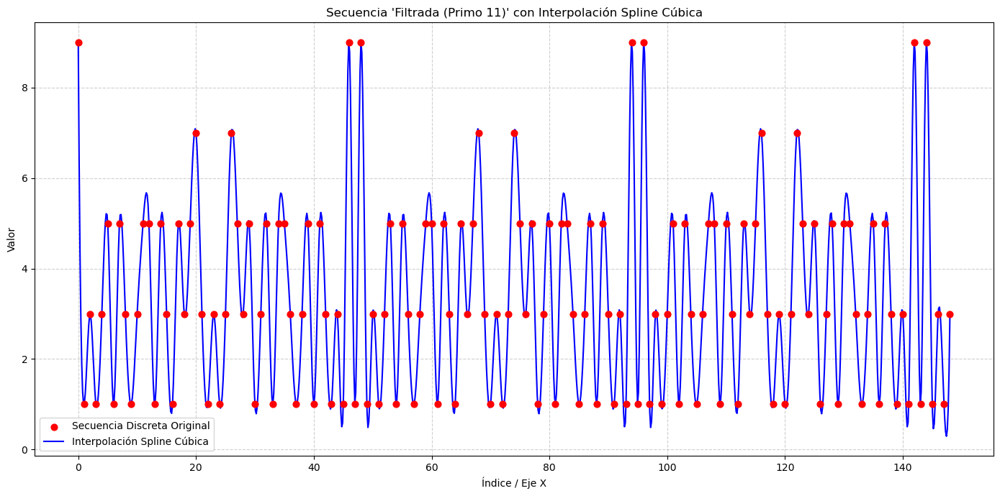


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 11) - Discreta ---


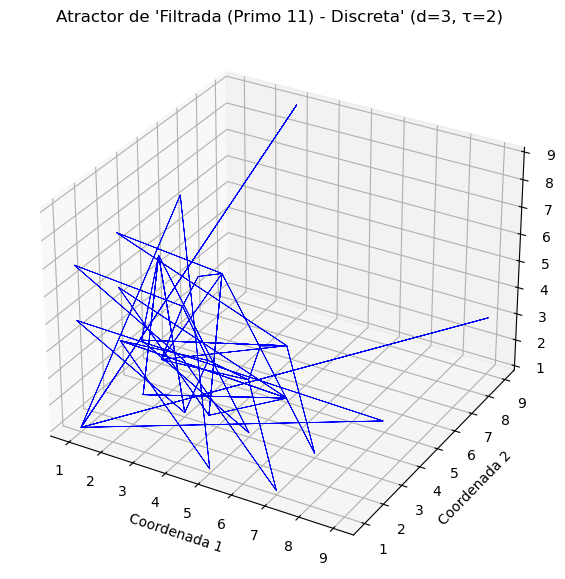

Análisis de persistencia se realizará en 145 puntos.


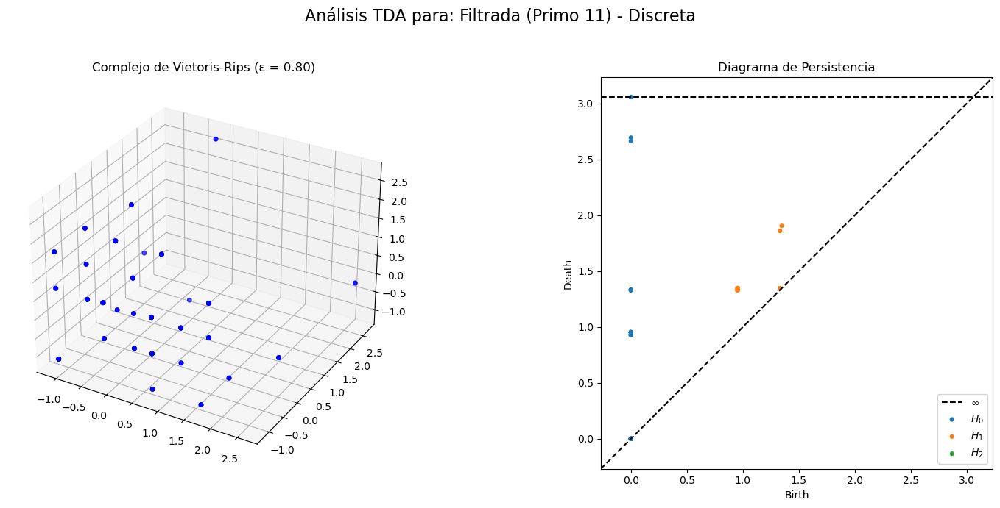

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 11) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 11) - Spline Lineal ---


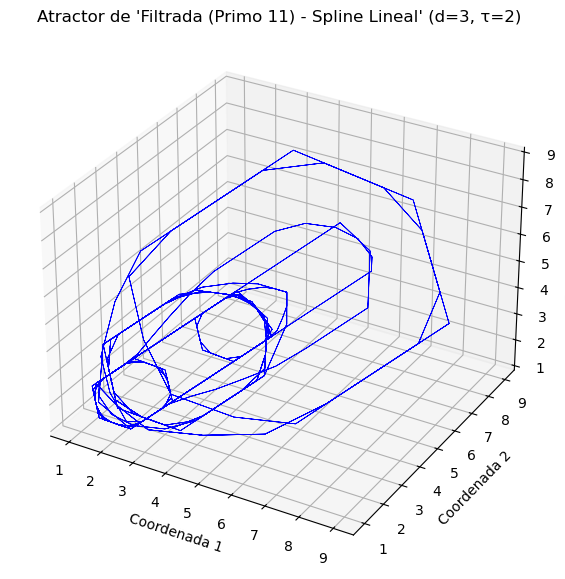

La nube de puntos (996) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


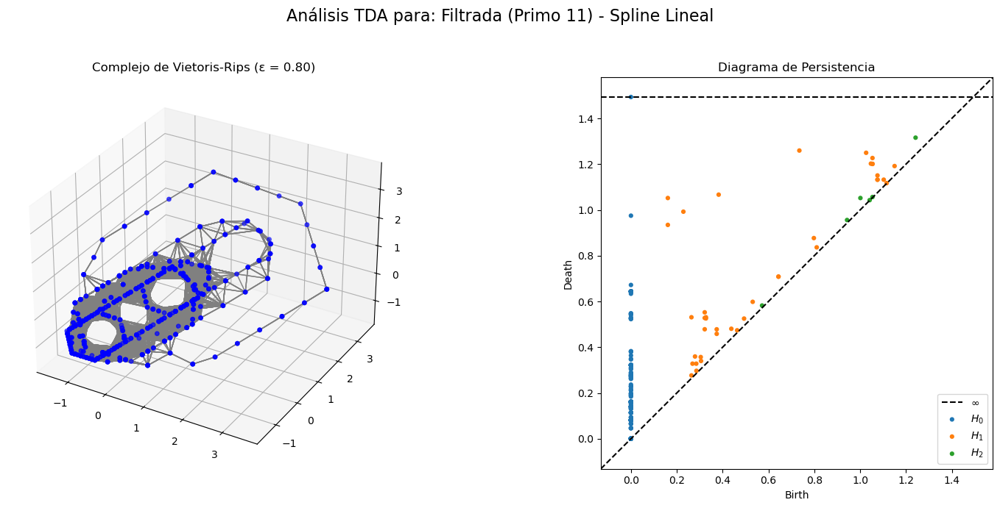

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 11) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 11) - Spline Cúbica ---


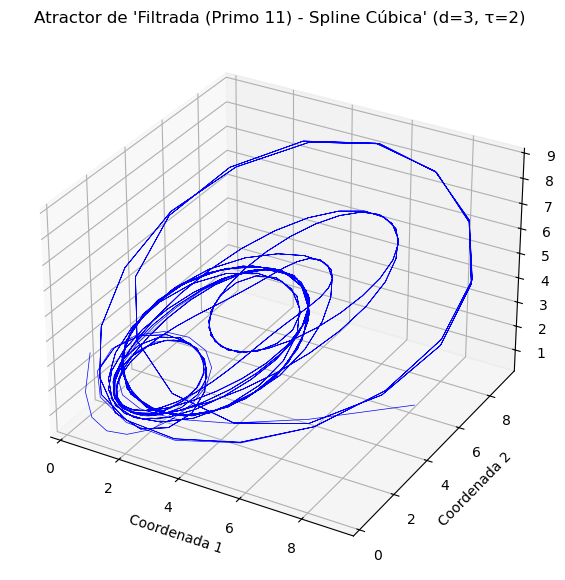

La nube de puntos (996) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


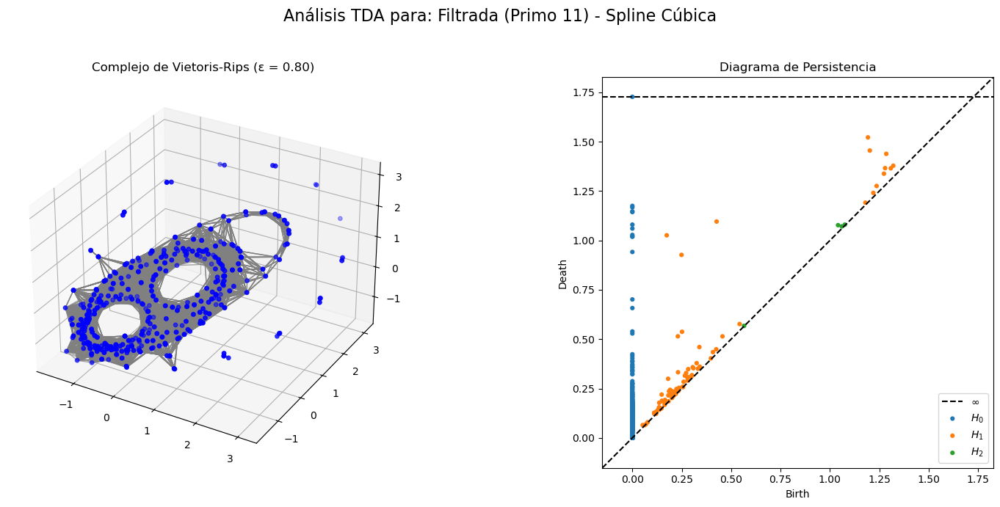

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 11) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 11)' finalizado.

➤ Analizando para el primo: 13
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 3


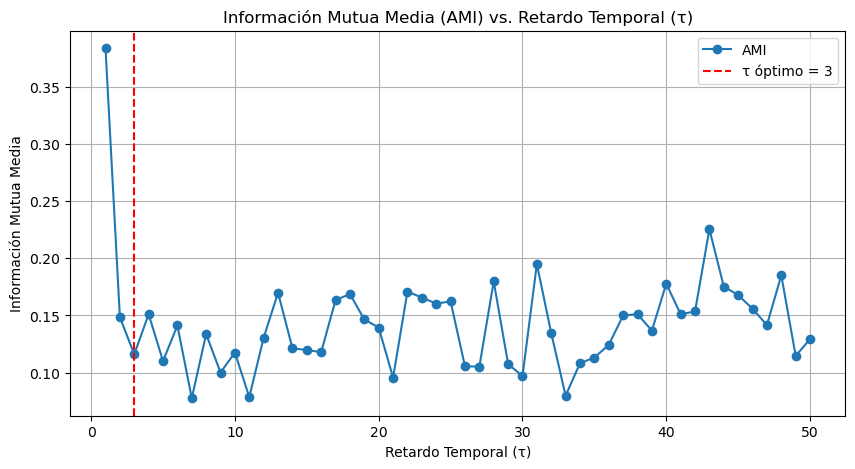


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


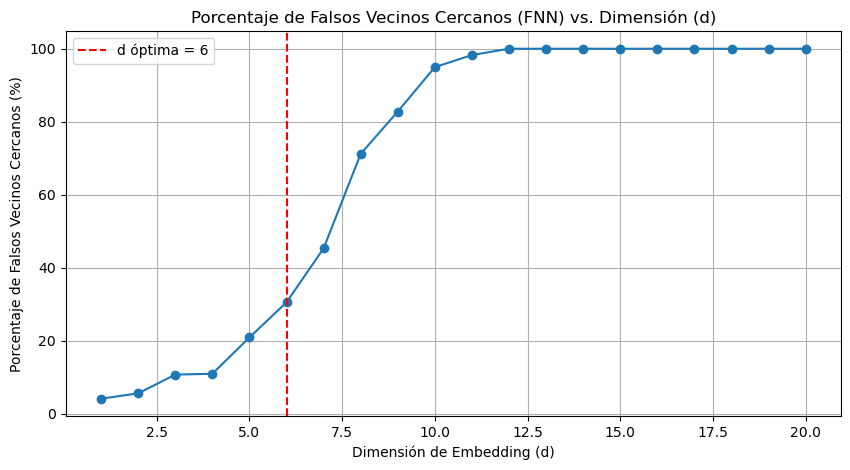


Parámetros de embedding detectados para 'Filtrada (Primo 13)': Dimensión (d) = 6, Retardo (τ) = 3
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


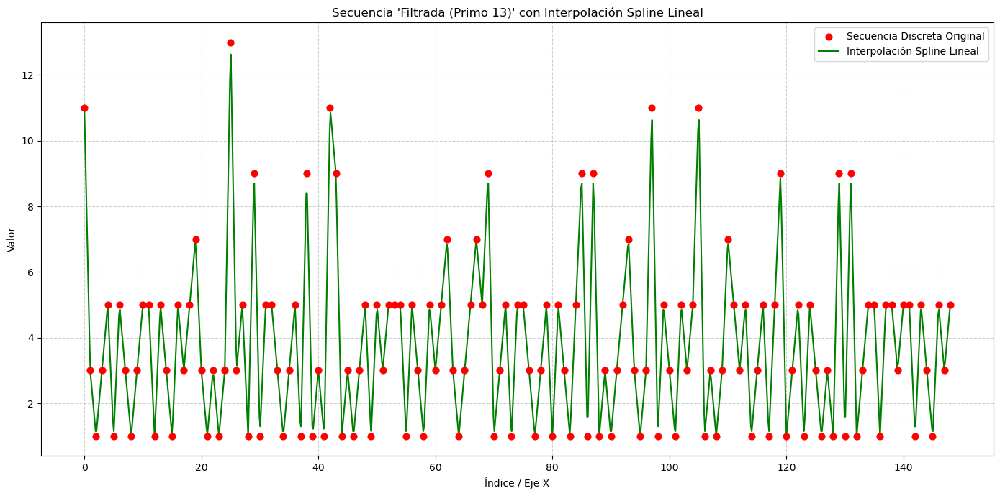

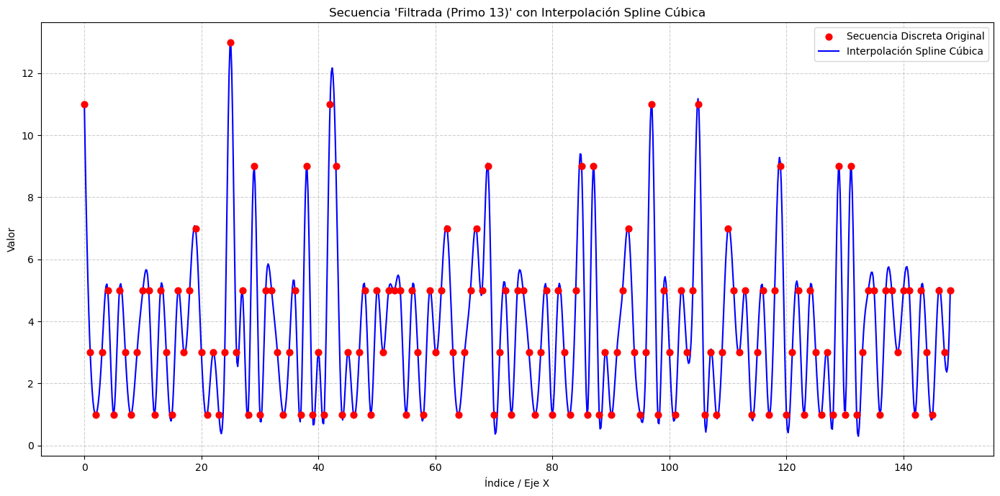


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 13) - Discreta ---


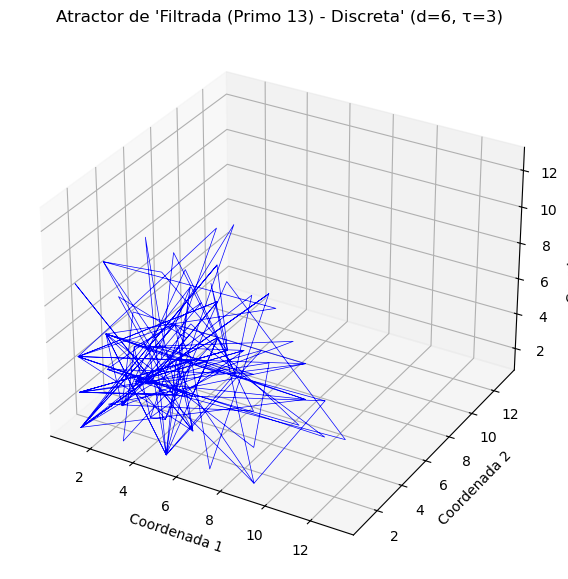

Análisis de persistencia se realizará en 134 puntos.


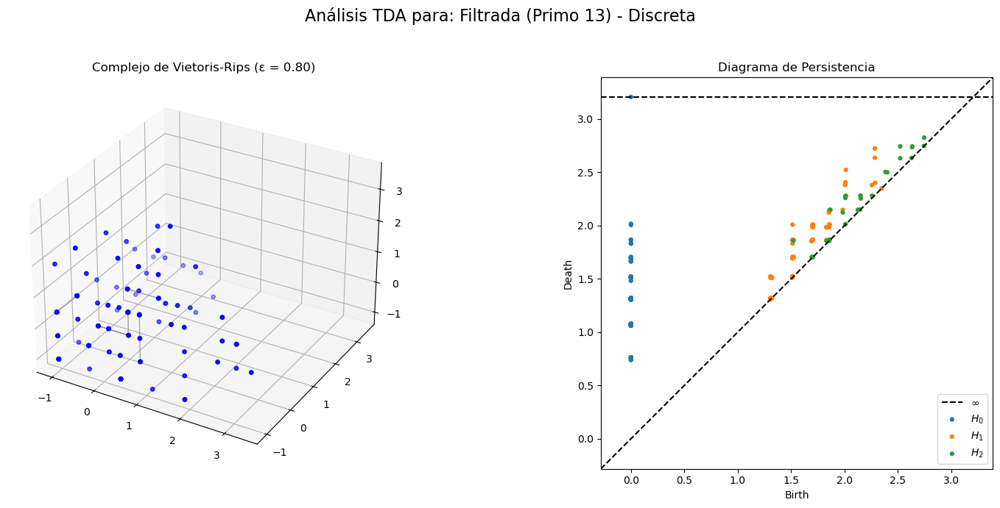

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 13) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 13) - Spline Lineal ---


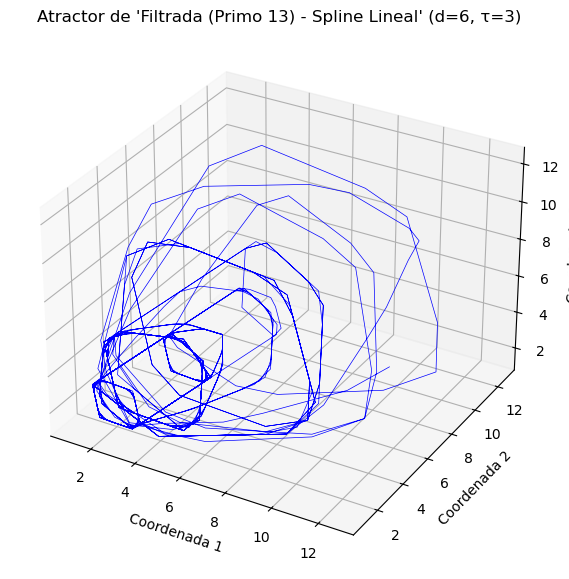

La nube de puntos (985) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


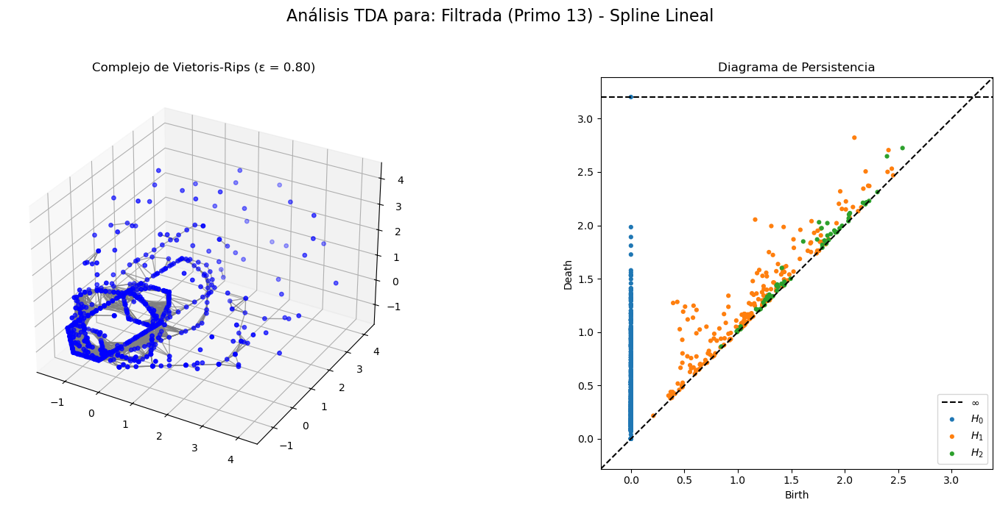

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 13) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 13) - Spline Cúbica ---


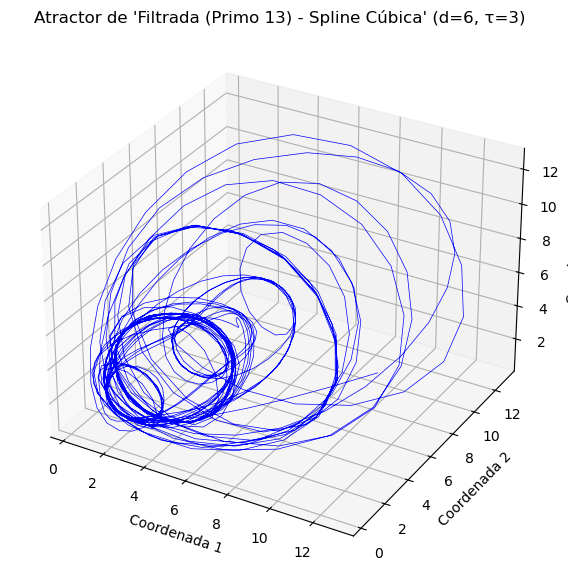

La nube de puntos (985) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


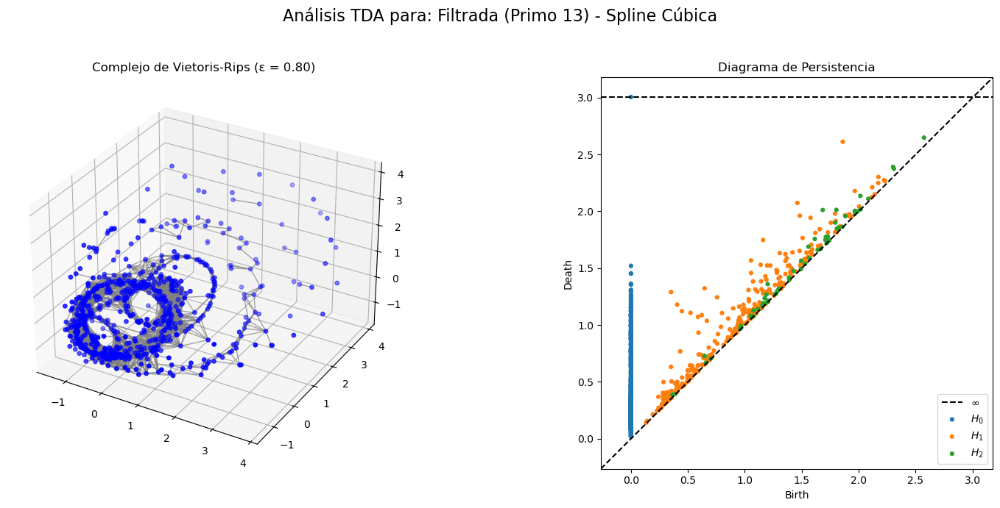

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 13) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 13)' finalizado.

➤ Analizando para el primo: 17
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 3


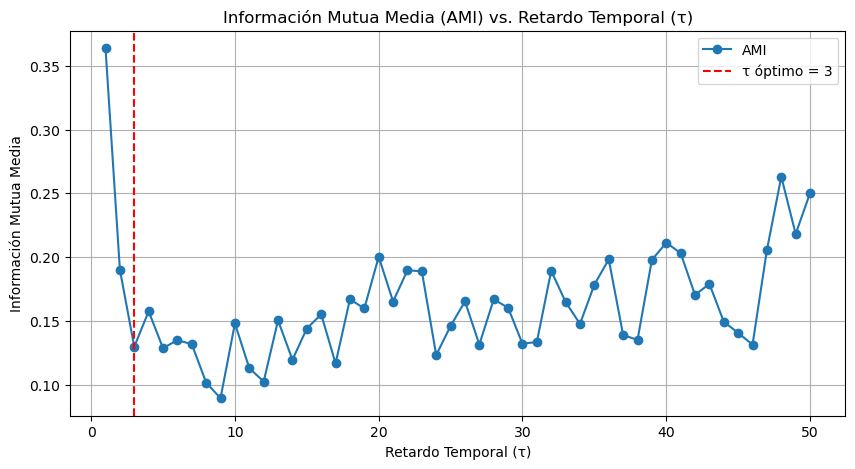


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


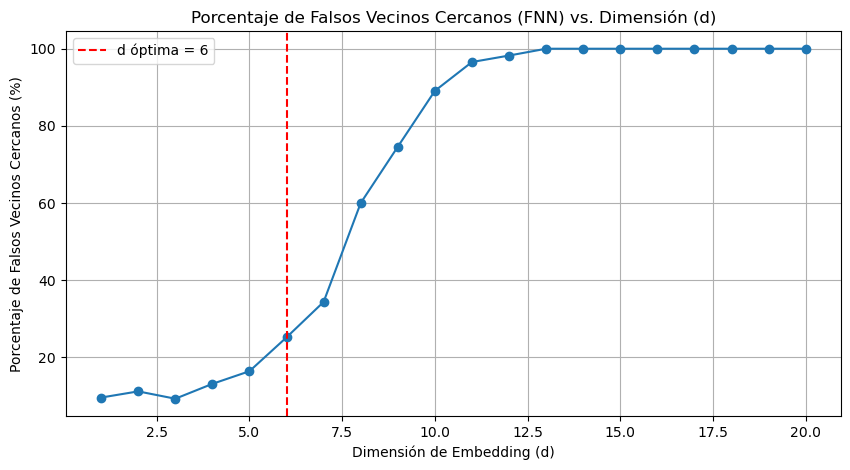


Parámetros de embedding detectados para 'Filtrada (Primo 17)': Dimensión (d) = 6, Retardo (τ) = 3
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


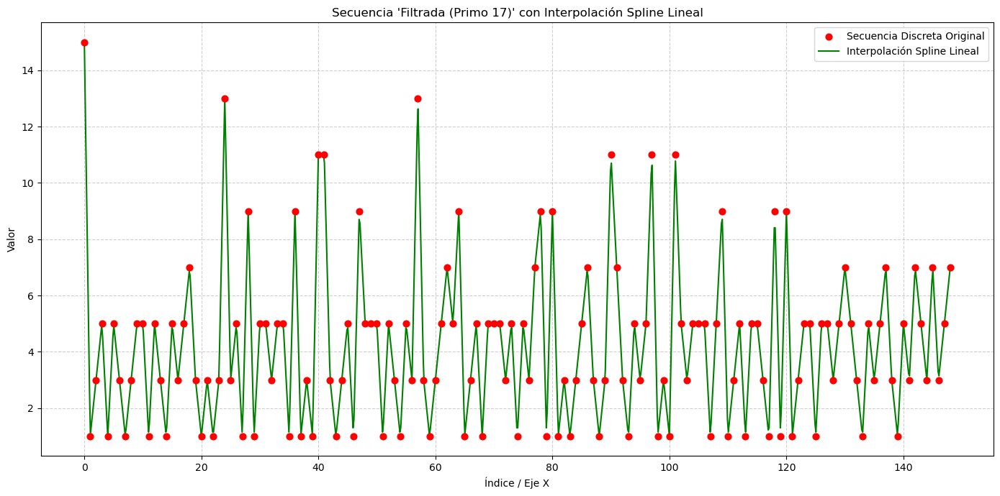

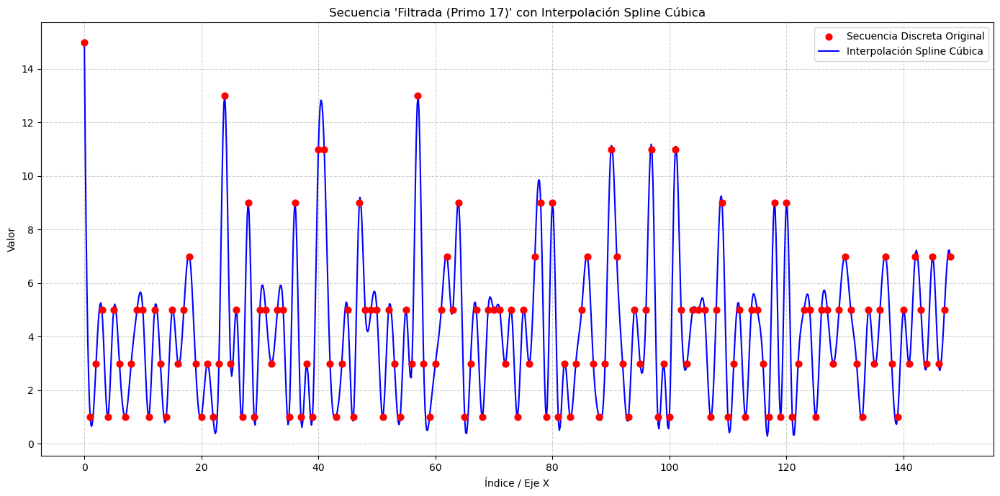


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 17) - Discreta ---


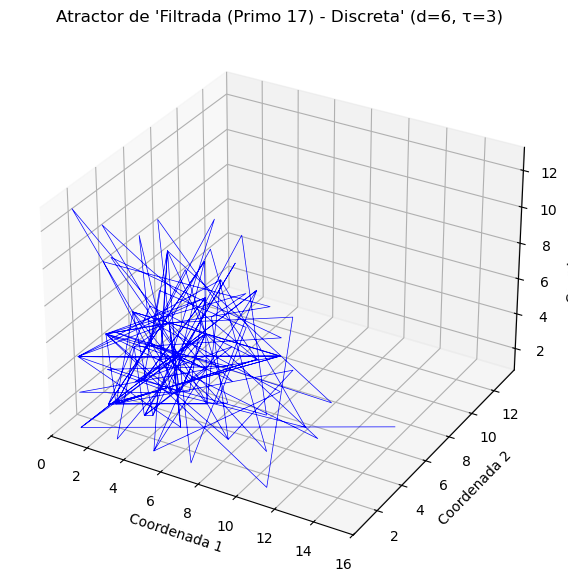

Análisis de persistencia se realizará en 134 puntos.


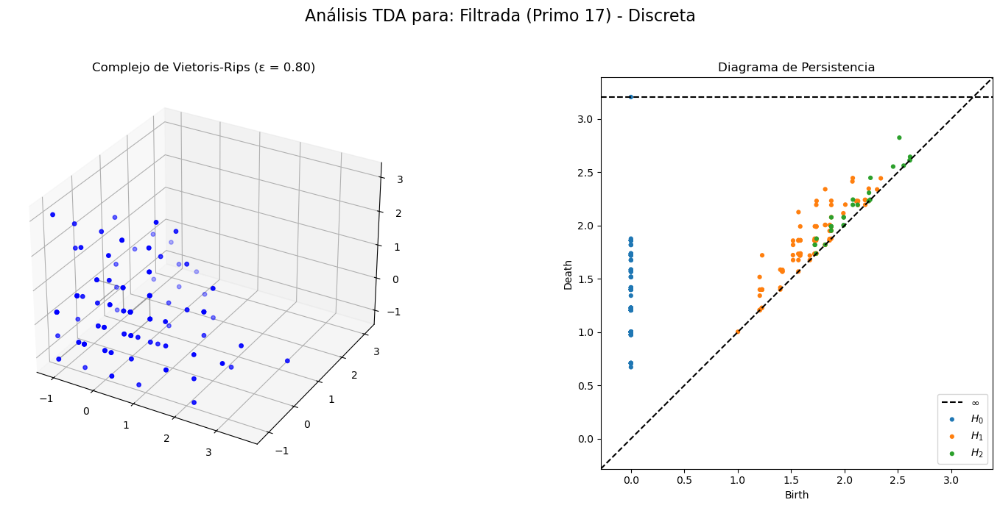

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 17) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 17) - Spline Lineal ---


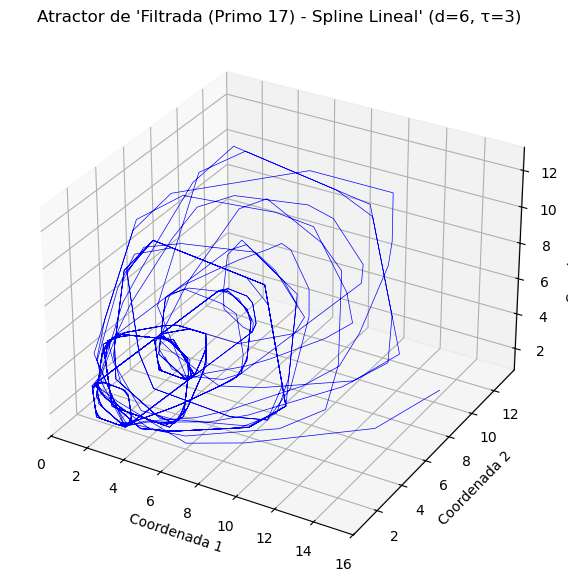

La nube de puntos (985) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


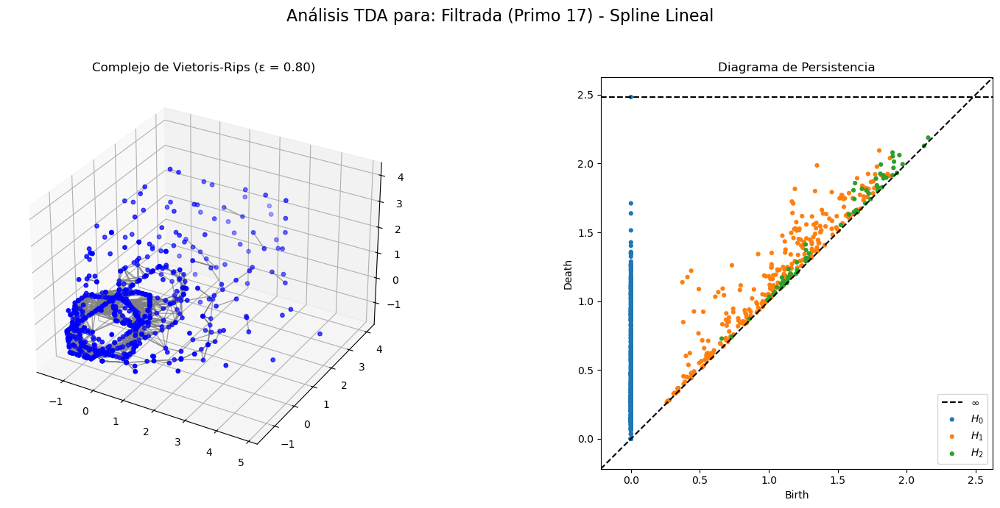

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 17) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 17) - Spline Cúbica ---


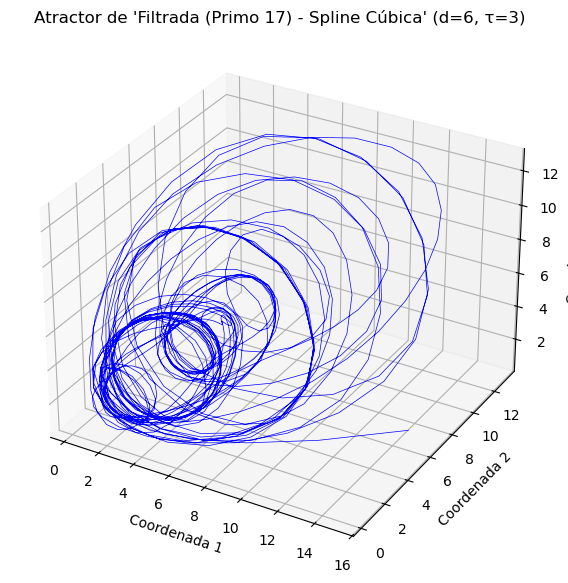

La nube de puntos (985) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


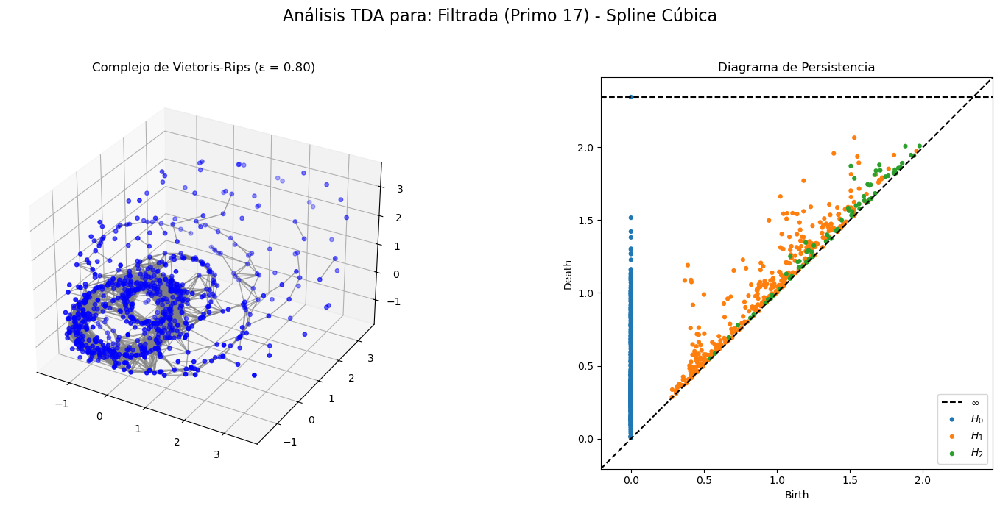

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 17) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 17)' finalizado.

➤ Analizando para el primo: 19
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 4


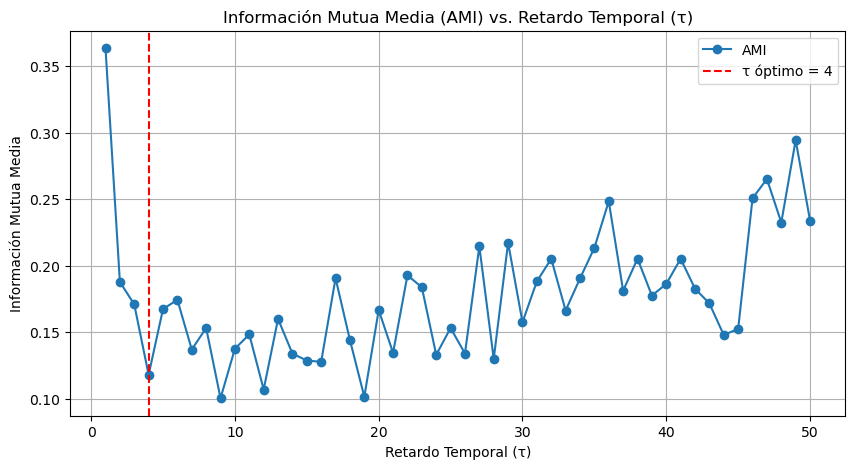


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


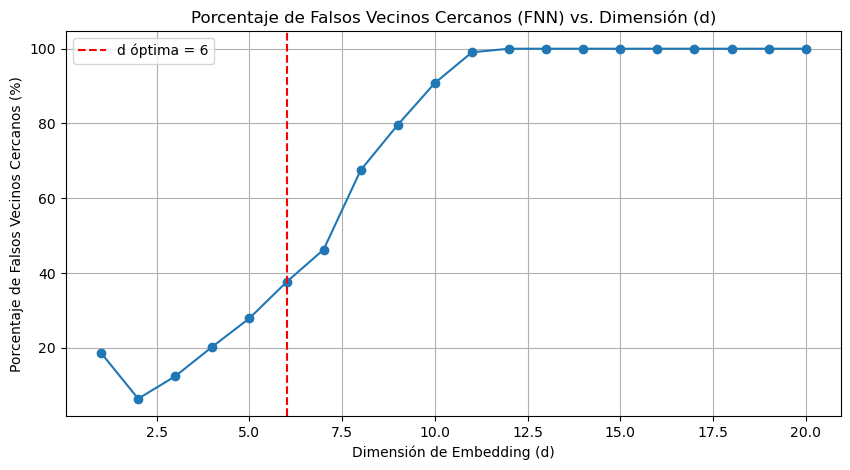


Parámetros de embedding detectados para 'Filtrada (Primo 19)': Dimensión (d) = 6, Retardo (τ) = 4
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


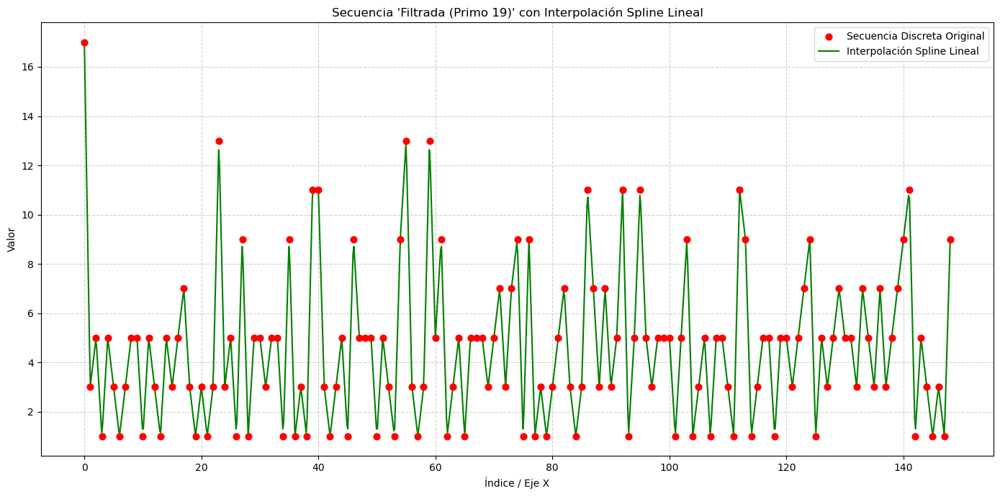

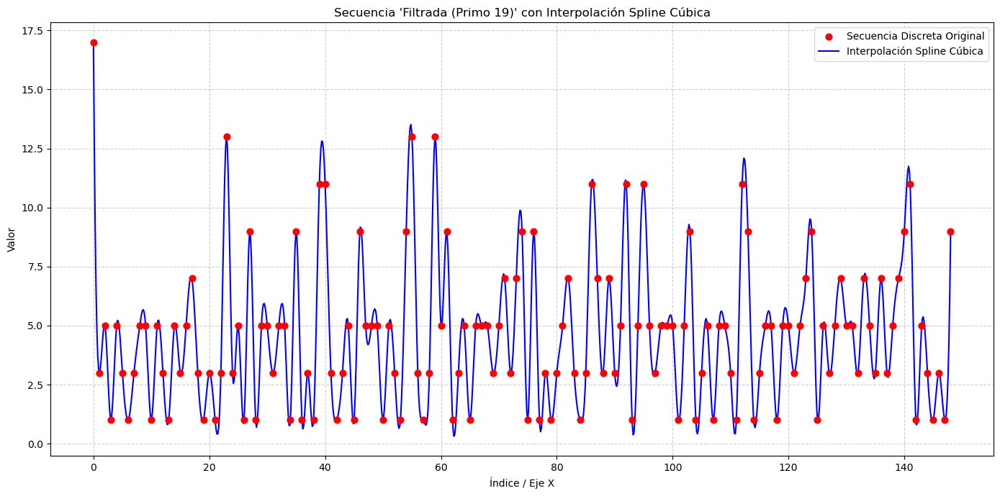


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 19) - Discreta ---


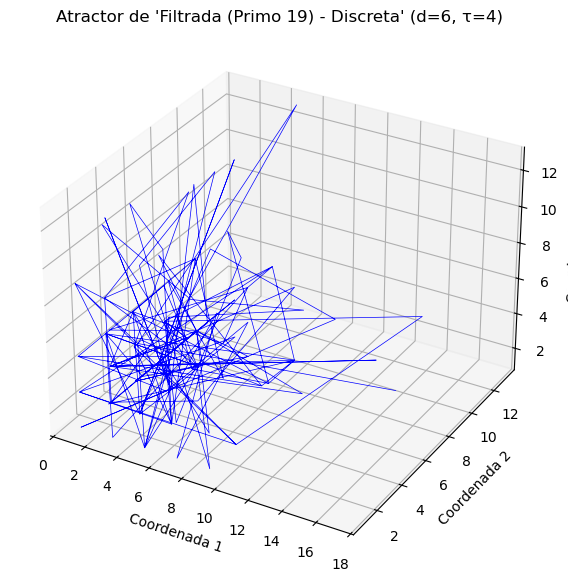

Análisis de persistencia se realizará en 129 puntos.


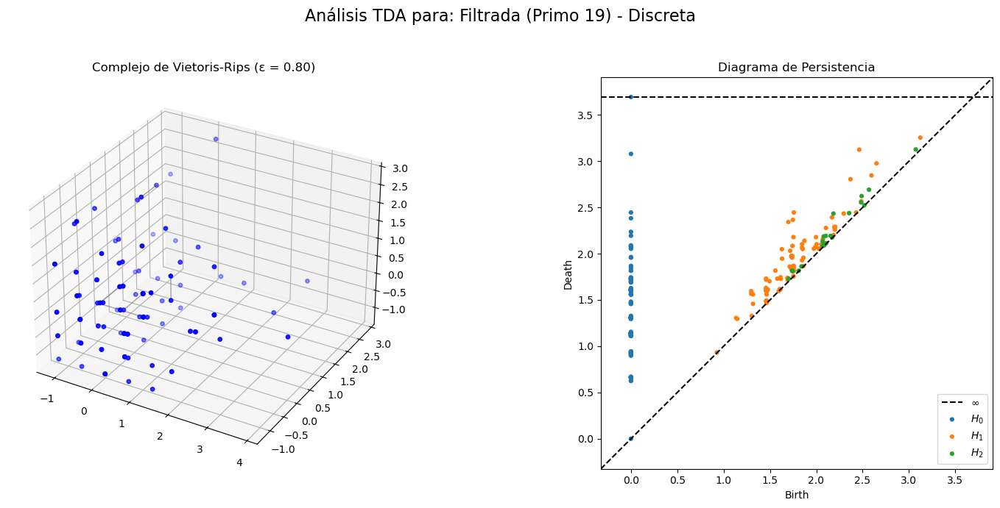

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 19) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 19) - Spline Lineal ---


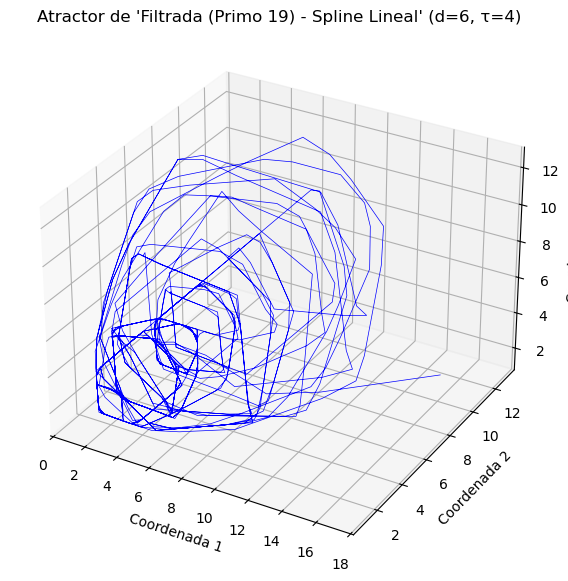

La nube de puntos (980) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


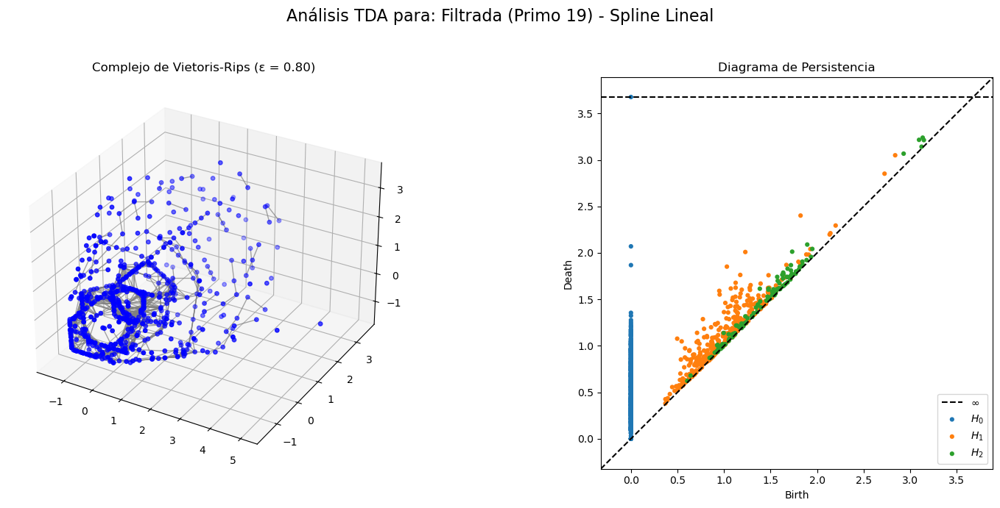

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 19) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 19) - Spline Cúbica ---


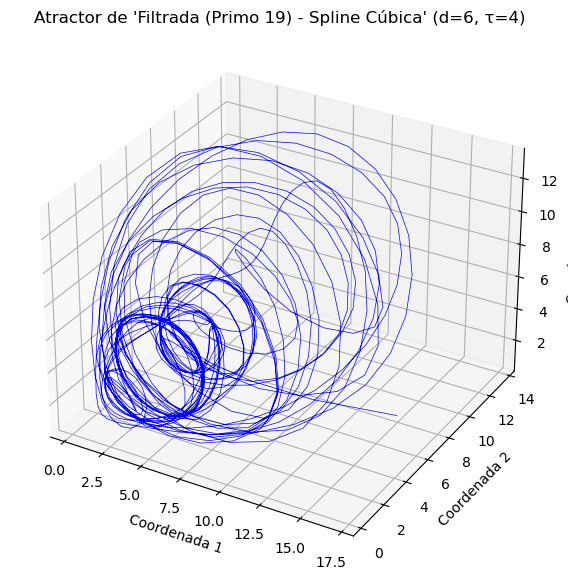

La nube de puntos (980) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


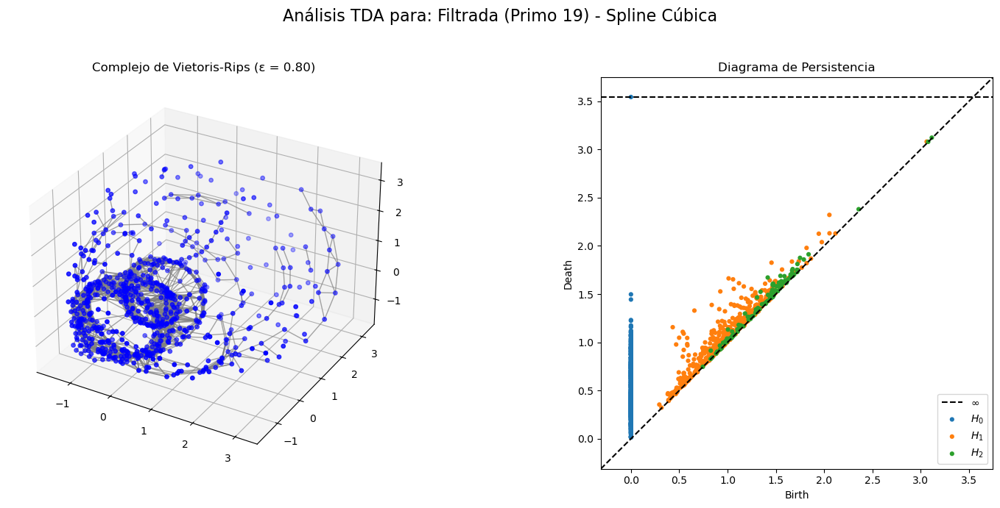

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 19) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 19)' finalizado.

➤ Analizando para el primo: 23
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 2


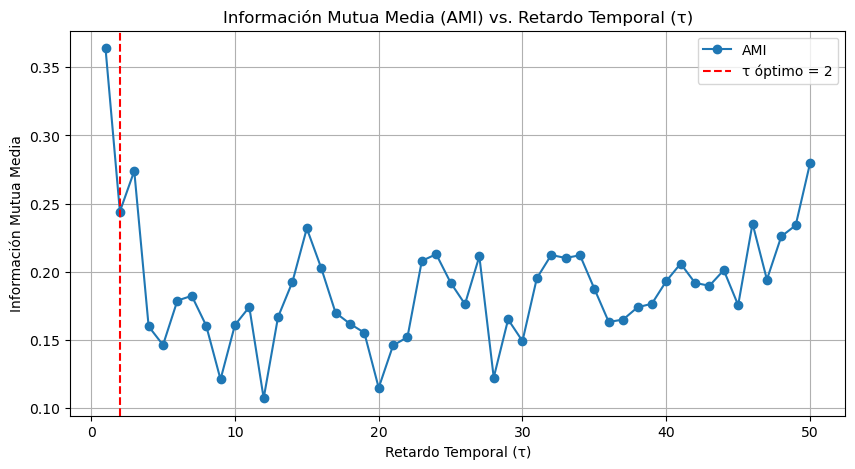


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


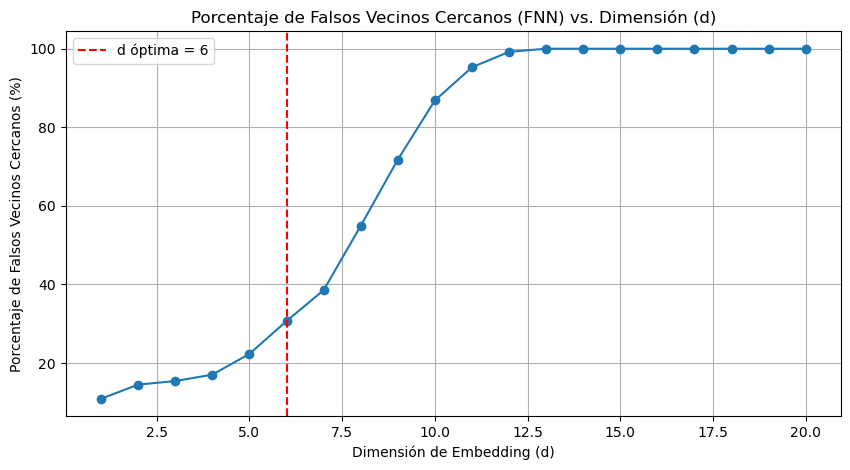


Parámetros de embedding detectados para 'Filtrada (Primo 23)': Dimensión (d) = 6, Retardo (τ) = 2
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


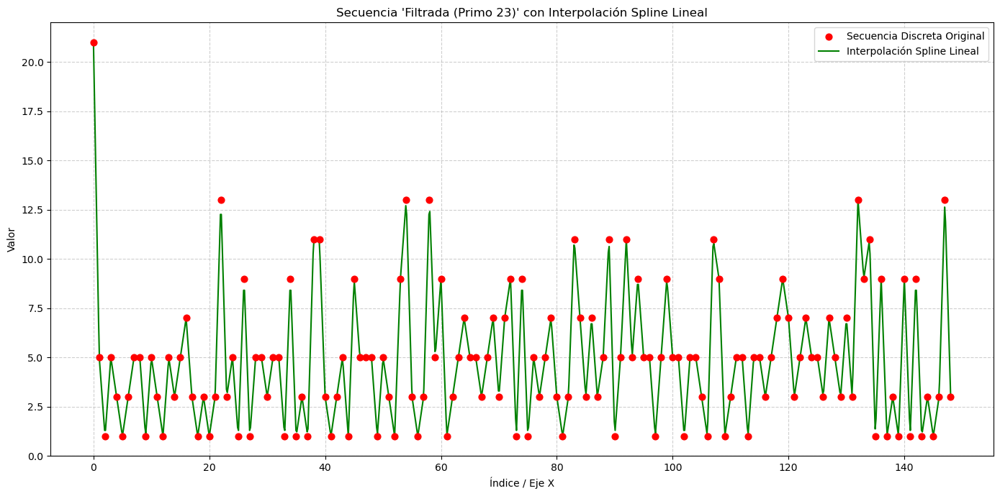

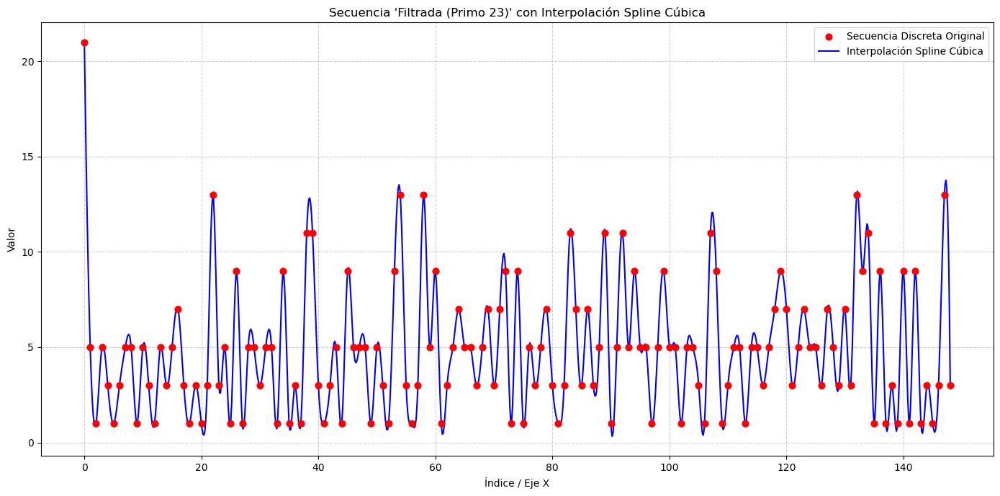


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 23) - Discreta ---


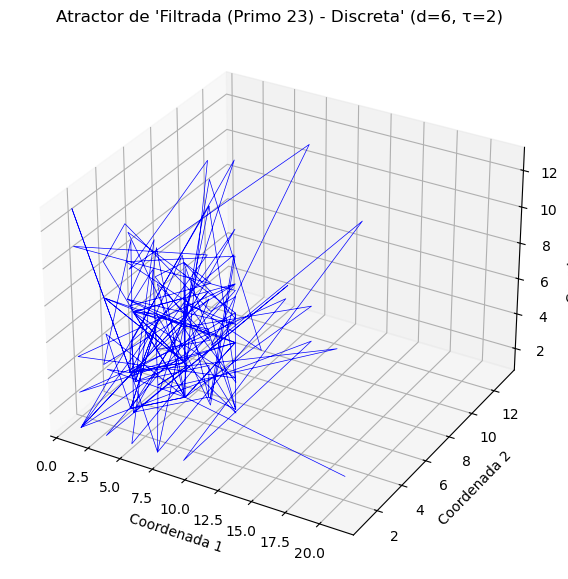

Análisis de persistencia se realizará en 139 puntos.


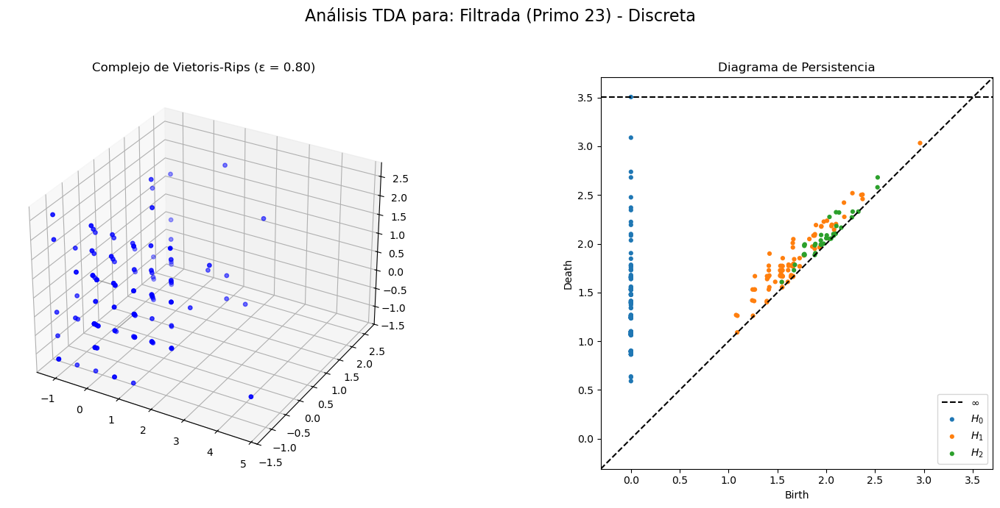

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 23) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 23) - Spline Lineal ---


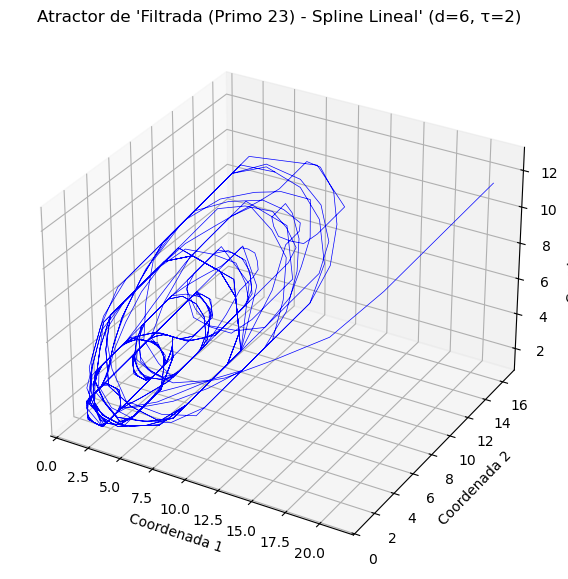

La nube de puntos (990) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


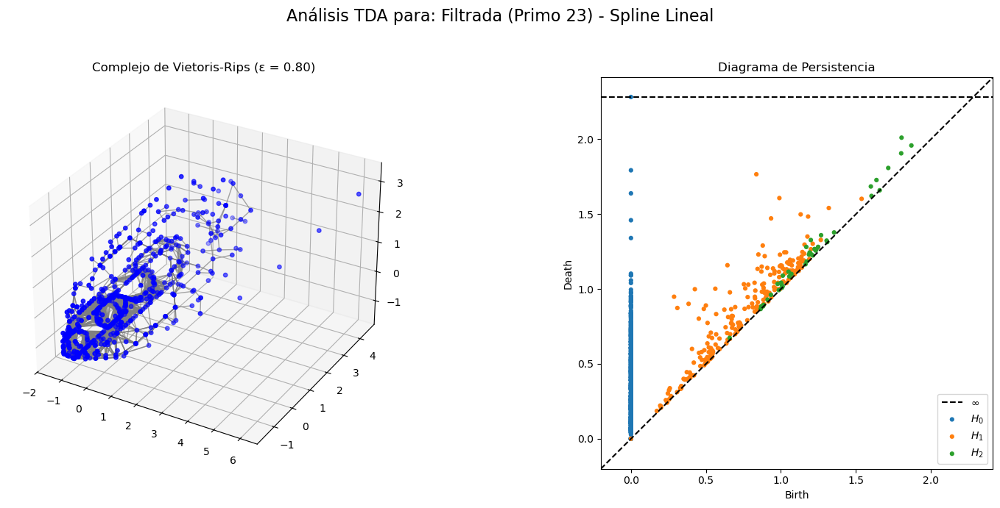

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 23) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 23) - Spline Cúbica ---


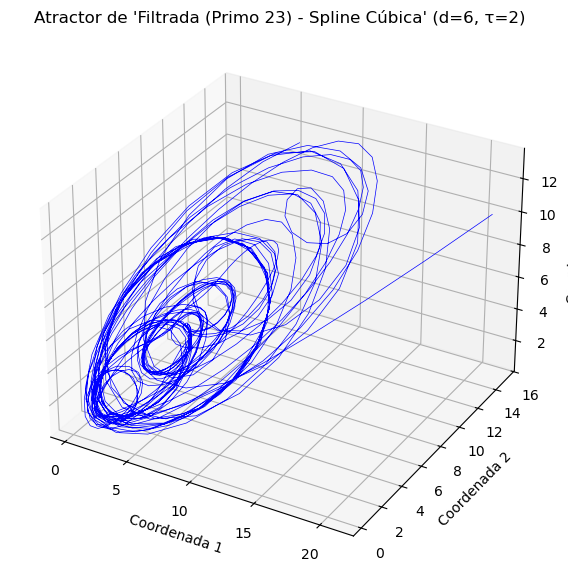

La nube de puntos (990) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


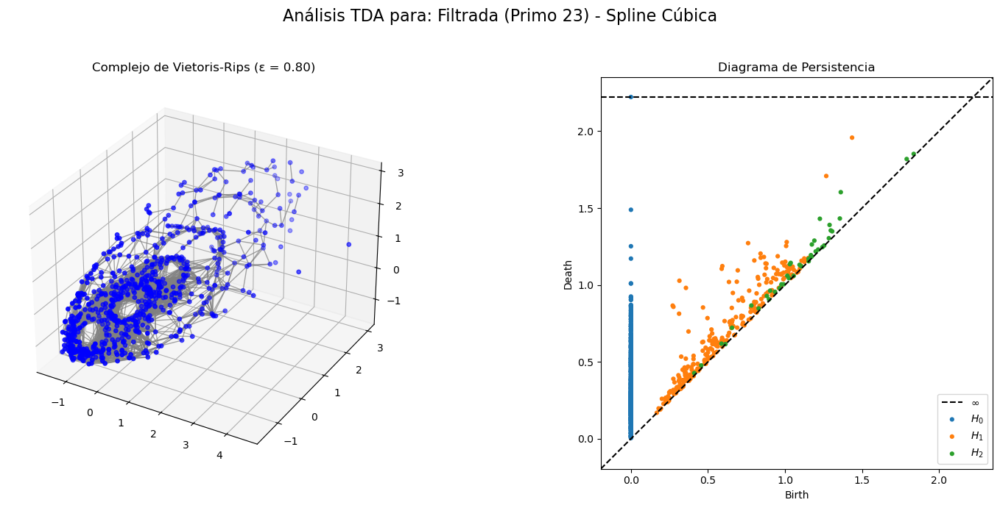

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 23) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 23)' finalizado.

➤ Analizando para el primo: 29
Secuencia de distancias generada (longitud 149).

--- Calculando Retardo Temporal Óptimo (τ) ---
Retardo temporal óptimo (τ) encontrado: 5


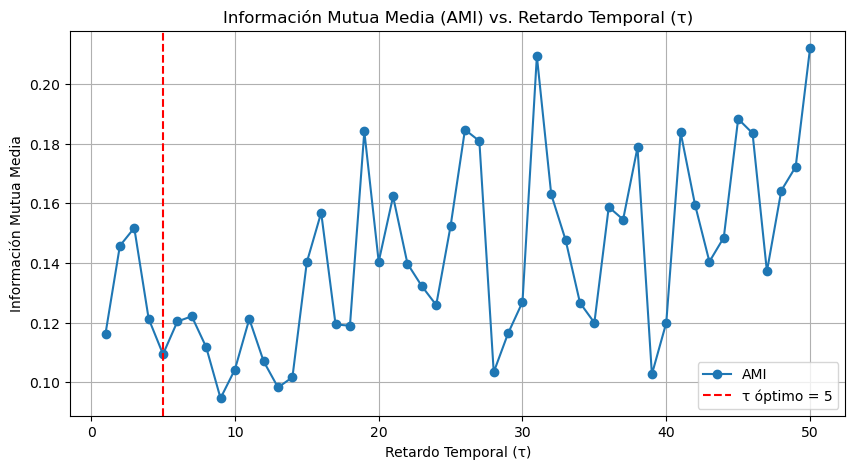


--- Calculando Dimensión de Embedding Óptima (d) ---
Advertencia: No se encontró una dimensión óptima clara por debajo del umbral. Usando d=6 como fallback.
Dimensión de embedding óptima (d) encontrada: 6


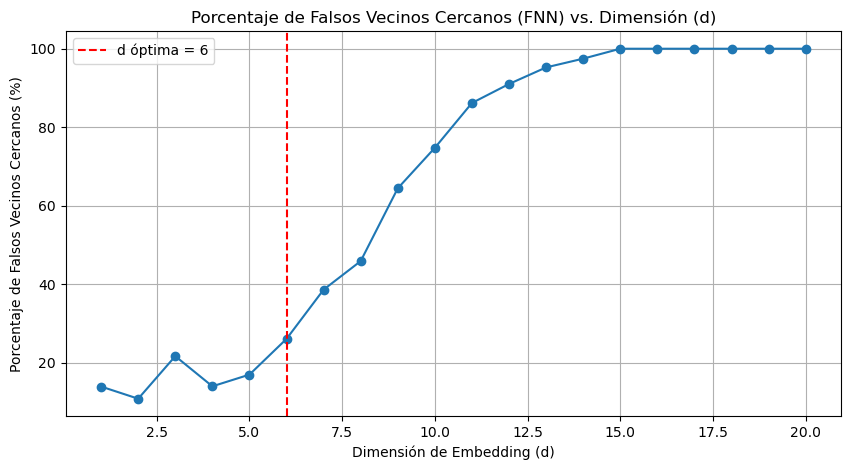


Parámetros de embedding detectados para 'Filtrada (Primo 29)': Dimensión (d) = 6, Retardo (τ) = 5
🌱 Fijando semilla aleatoria de NumPy en: 52

📈 Generando gráficas para los tipos: ['discreta', 'spline1', 'spline3']


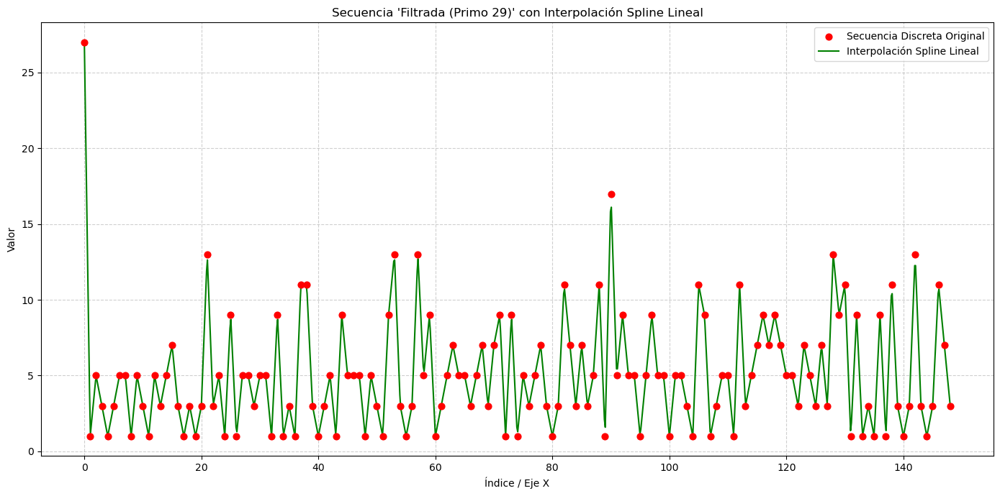

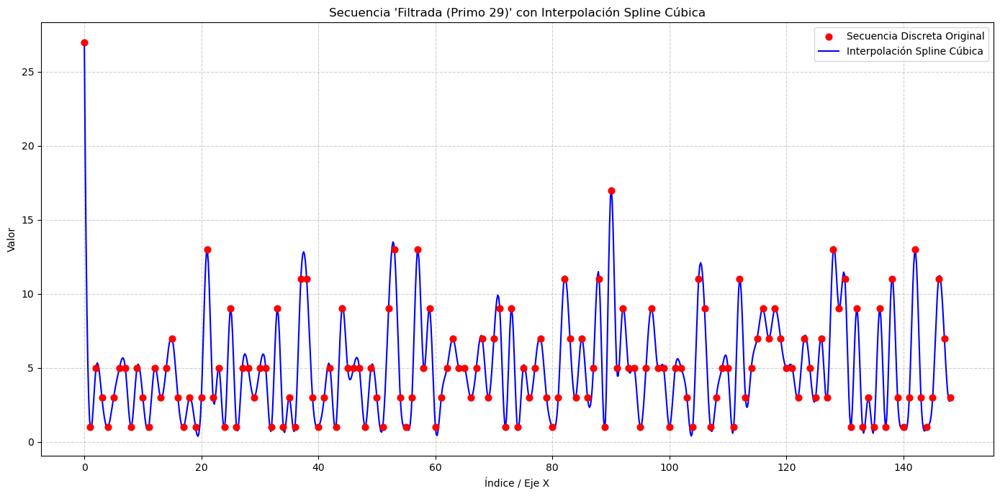


▶️ Iniciando análisis TDA para los tipos: ['discreta', 'spline1', 'spline3']

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 29) - Discreta ---


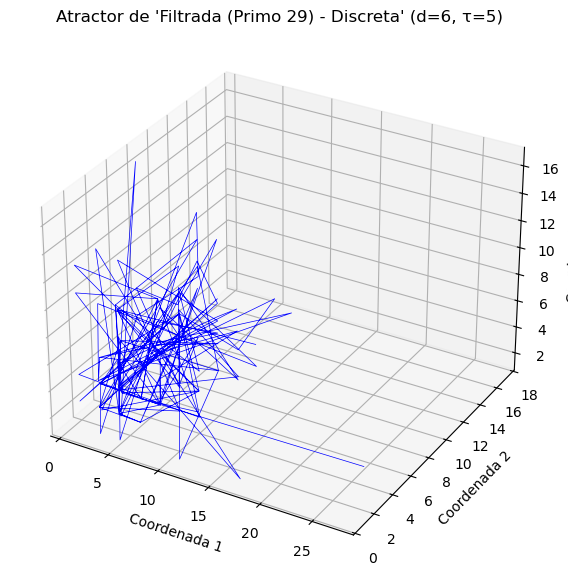

Análisis de persistencia se realizará en 124 puntos.


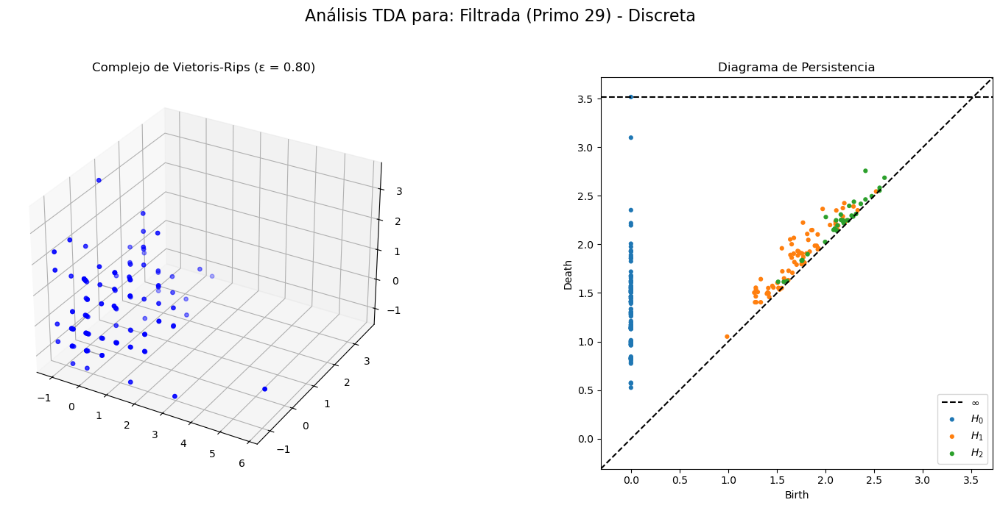

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 29) - Discreta ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 29) - Spline Lineal ---


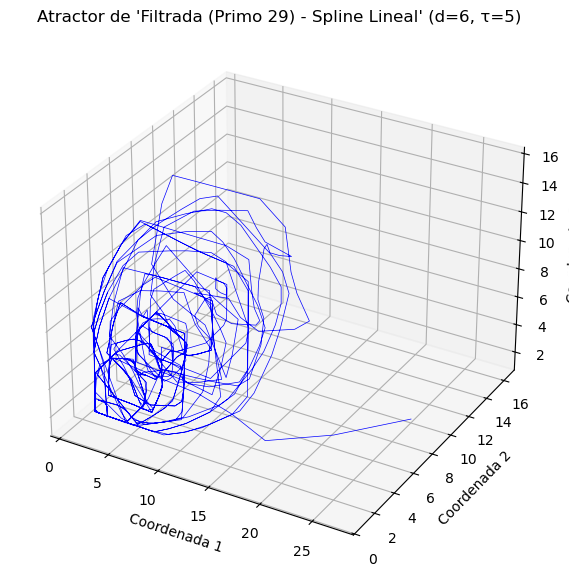

La nube de puntos (975) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


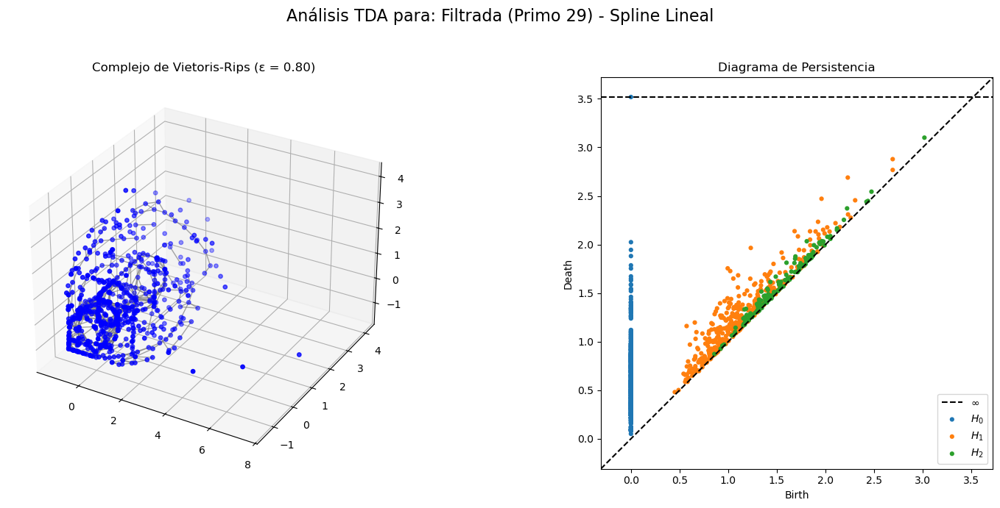

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 29) - Spline Lineal ---

--- INICIANDO ANÁLISIS TDA PARA: Filtrada (Primo 29) - Spline Cúbica ---


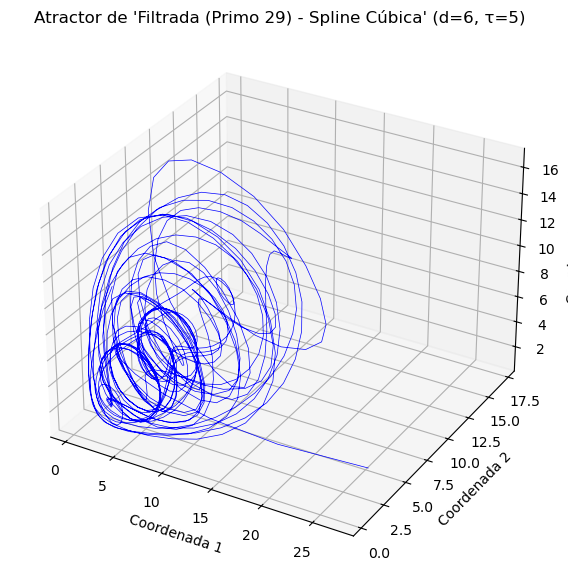

La nube de puntos (975) excede el máximo (750). Submuestreando...
Análisis de persistencia se realizará en 750 puntos.


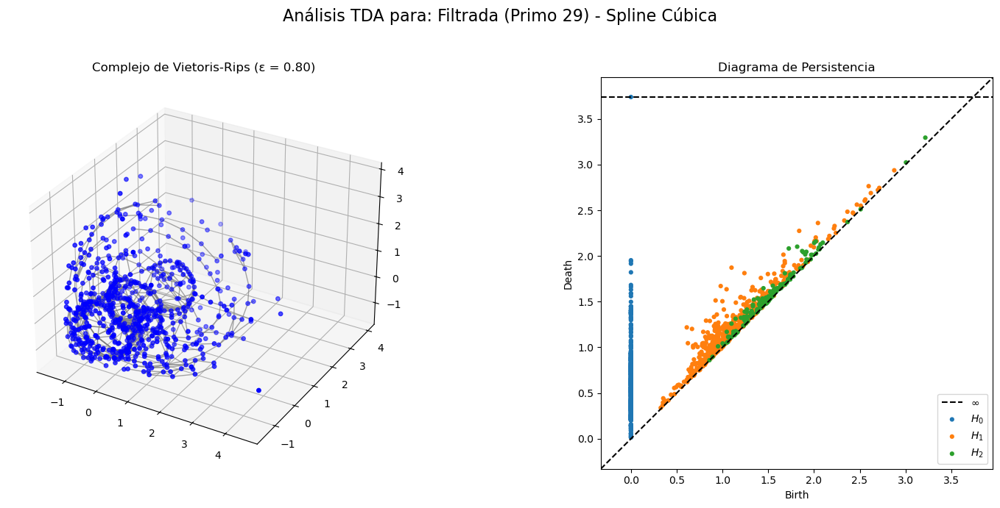

--- ANÁLISIS TDA FINALIZADO PARA: Filtrada (Primo 29) - Spline Cúbica ---

✅ Análisis para 'Filtrada (Primo 29)' finalizado.


In [27]:
# ==============================================================================
# BLOQUE DE EJECUCIÓN PRINCIPAL
# ==============================================================================
if __name__ == '__main__':    
    # --- 1. Parámetros de Configuración ---
    # Parámetros para el análisis TDA y la visualización.
    PARAMETROS_TDA = {
        "puntos_interpolacion": 1000,
        "epsilon_vr": 0.8,
        "num_componentes_trig": 50,
        "max_puntos_tda": 750,
        "semilla": 52
    }
    # Parámetros para la detección automática de d y τ.
    PARAMETROS_AUTO_EMBEDDING = {
        "max_tau_ami": 50,
        "max_dim_fnn": 20
    }
    for prime in primerange(7,30):
        # --- 2. Elige la Secuencia a Analizar ---
        secuencia_a_analizar = generar_secuencia_filtrada(primo_base=prime, longitud_deseada=150)
        nombre = f"Filtrada (Primo {prime})"
    
        secuencia_np = np.array(secuencia_a_analizar)
        
        # Se llama a las funciones de selección para obtener los parámetros óptimos.
        tau_optimo = seleccionar_tau_optimo(secuencia_np, max_tau=PARAMETROS_AUTO_EMBEDDING["max_tau_ami"])
        dim_optima = seleccionar_dim_optima(secuencia_np, tau=tau_optimo, max_dim=PARAMETROS_AUTO_EMBEDDING["max_dim_fnn"])
    
        print(f"\nParámetros de embedding detectados para '{nombre}': Dimensión (d) = {dim_optima}, Retardo (τ) = {tau_optimo}")
    
        # --- 4. Elige qué Análisis Realizar con los parámetros detectados ---
        ejecutar_analisis_completo(
            secuencia_discreta=secuencia_a_analizar,
            nombre_secuencia=nombre,
            dim_emb=dim_optima, 
            tau_emb=tau_optimo,
            tipos_TDA=['discreta','spline1', 'spline3'],
            **PARAMETROS_TDA
        )